In [281]:
# Dataset
    ## Up Task
def Hemo_Uptask_Dataset(mode):
    if mode == 'train':
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Train_nii/*_img.nii.gz"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Train_nii/*_mask.nii.gz"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]        

        print("Train [Total]  number = ", len(img_list))
        print("Train [Hemo]   number = ", len([i for i in img_list if "_hemo_" in i]))
        print("Train [Normal] number = ", len([i for i in img_list if "_normal_" in i]))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                     # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,                                                                                               # Remove the empty slice
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                
                Crop_Non_Empty_Mask_If_Exists,                                                                                    # Sampling one hemorrhage slice with high probability in patient level nii data for 2D-based manner
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                
                # Augmentation
                Albu_2D_Transform_Compose,                                            # 2D based Transform with keeping the depth slices
                RandFlipd(keys=["image", "label"], spatial_axis=[0, 1], prob=0.5),    # 3D based Transform 
                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"])
            ]
        )   

    else :
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Valid_nii/*_img.nii.gz"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Valid_nii/*_mask.nii.gz"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]

        print("Valid [Total]  number = ", len(img_list))
        print("Valid [Hemo]   number = ", len([i for i in img_list if "_hemo_" in i]))
        print("Valid [Normal] number = ", len([i for i in img_list if "_normal_" in i]))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                     # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,                                                                                               # Remove the empty slice
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                                
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"]),
            ]
        )

    return Dataset(data=data_dicts, transform=transforms), default_collate_fn

In [282]:
t = Hemo_Uptask_Dataset('train')

Train [Total]  number =  1068
Train [Hemo]   number =  747
Train [Normal] number =  321


In [283]:
s = t[0]

In [284]:
s

In [239]:

from monai.metrics.utils import MetricReduction
from monai.metrics import compute_roc_auc, DiceMetric, ConfusionMatrixMetric 


## Metric 
dice_metric    = DiceMetric(include_background=True, reduction=MetricReduction.MEAN, get_not_nans=False)
confuse_metric = ConfusionMatrixMetric(include_background=True, metric_name=["f1 score", "accuracy", "sensitivity", "specificity",], compute_sample=False, reduction=MetricReduction.MEAN, get_not_nans=False)
auc_metric     = compute_roc_auc

In [273]:
pred = torch.tensor([[0.8], [0.3], [0.2], [0.1], [0.1]])
gt   = torch.tensor([[1],   [0],   [0],   [1],   [0]])

In [255]:
pred.shape

torch.Size([5, 1])

In [256]:
gt.shape

torch.Size([5, 1])

In [271]:
# Metric CLS
auc                 = auc_metric(y_pred=pred, y=gt)
confuse_result      = confuse_metric(y_pred=pred.round(), y=gt).aggregate()
# confusion_matrix, _ = do_metric_reduction(confuse_result, MetricReduction.SUM)

AttributeError: 'Tensor' object has no attribute 'aggregate'

In [274]:
confuse_matrix = confuse_metric(y_pred=pred.round(), y=gt)

In [279]:
a,b,c,d = confuse_metric.aggregate()

In [280]:
a

tensor([0.6667])

In [278]:
auc.item()

0.5833333333333334

In [2]:
!pip install opencv-python==4.5.5.62
# !pip install monai kornia einops

Defaulting to user installation because normal site-packages is not writeable
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 60.4/60.4 MB 8.9 MB/s eta 0:00:00:00:0100:01


In [187]:
import re
import glob
import cv2
import functools
import torch
import numpy as np
import skimage
import random

import albumentations as albu
from monai.transforms import *
from monai.data import Dataset

import warnings
warnings.filterwarnings(action='ignore') 

# functions
def list_sort_nicely(l):   
    def tryint(s):        
        try:            
            return int(s)        
        except:            
            return s
        
    def alphanum_key(s):
        return [ tryint(c) for c in re.split('([0-9]+)', s) ]
    l.sort(key=alphanum_key)    
    return l

def resize_keep_depths(x, size, mode):
    depths = x.shape[-1]  # (C, H, W, D)
    if mode == 'image':
        x = Resize(spatial_size=(size, size, depths), mode='trilinear', align_corners=True)(x)
    else :
        x = Resize(spatial_size=(size, size, depths), mode='nearest', align_corners=None)(x)
    return x

def pad(image, new_shape, border_mode="constant", value=0):
    '''
    image: [H, W, D, C] or [H, W, D]
    new_shape: [H, W, D]
    '''
    axes_not_pad = len(image.shape) - len(new_shape)

    old_shape = np.array(image.shape[:len(new_shape)])
    new_shape = np.array([max(new_shape[i], old_shape[i]) for i in range(len(new_shape))])

    difference = new_shape - old_shape
    pad_below = difference // 2
    pad_above = difference - pad_below

    pad_list = [list(i) for i in zip(pad_below, pad_above)] + [[0, 0]] * axes_not_pad

    if border_mode == 'reflect':
        res = np.pad(image, pad_list, border_mode)
    elif border_mode == 'constant':
        res = np.pad(image, pad_list, border_mode, constant_values=value)
    else:
        raise ValueError

    return res

def crop(img, x1, y1, z1, x2, y2, z2):
    height, width, depth = img.shape[:3]
    if x2 <= x1 or y2 <= y1 or z2 <= z1:
        raise ValueError
    if x1 < 0 or y1 < 0 or z1 < 0:
        raise ValueError
    if x2 > height or y2 > width or z2 > depth:
        img = pad(img, (x2, y2, z2))
        warnings.warn('image size smaller than crop size, pad by default.', UserWarning)

    return img[x1:x2, y1:y2, z1:z2]

def Crop_Non_Empty_Mask_If_Exists(input, patch_size=(256, 256, 1)):
    # reference: https://github.com/ZFTurbo/volumentations
    image = input['image'].squeeze(0)
    mask  = input['label'].squeeze(0)
    
    patch_height, patch_width, patch_depth = patch_size
    mask_height,  mask_width,  mask_depth  = mask.shape

    if mask.sum() == 0:
        x_min = random.randint(0, mask_height - patch_height)
        y_min = random.randint(0, mask_width  - patch_width)
        z_min = random.randint(0, mask_depth  - patch_depth)

    else:
        non_zero = np.argwhere(mask)
        x, y, z  = random.choice(non_zero)
        x_min    = x - random.randint(0, patch_height - 1)
        y_min    = y - random.randint(0, patch_width  - 1)
        z_min    = z - random.randint(0, patch_depth  - 1)
        x_min    = np.clip(x_min, 0, mask_height - patch_height)
        y_min    = np.clip(y_min, 0, mask_width  - patch_width)
        z_min    = np.clip(z_min, 0, mask_depth  - patch_depth)

    x_max = x_min + patch_height
    y_max = y_min + patch_width
    z_max = z_min + patch_depth

    image = crop(image, x_min, y_min, z_min, x_max, y_max, z_max)
    mask  = crop(mask,  x_min, y_min, z_min, x_max, y_max, z_max)

    input['image'] = np.expand_dims(image, axis=0)
    input['label'] = np.expand_dims(mask, axis=0)
    
    return input

def clahe_keep_depths(image, clipLimit, tileGridSize):
    image = skimage.util.img_as_ubyte(image.squeeze(0))
    
    assert image.dtype == np.uint8
    assert len(image.shape) == 3  # 2d --> (H, W, 1) / 3d --> (H, W, D)

    clahe_mat   = cv2.createCLAHE(clipLimit=clipLimit, tileGridSize=tileGridSize)
    stacked_img = np.stack([clahe_mat.apply(image[..., i]) for i in range(image.shape[-1])], axis=-1)
    
    stacked_img = skimage.util.img_as_float32(stacked_img)        

    return np.expand_dims(stacked_img, axis=0)

def delete_too_small_noise_keep_depths(mask, min_size, connectivity):
    mask  = skimage.morphology.remove_small_objects(mask.squeeze(0).astype('bool'), min_size=min_size, connectivity=connectivity) # for noise reduction
    
    return np.expand_dims(mask, axis=0).astype('float32')

def Albu_2D_Transform_Compose(input):
    '''
    reference: https://github.com/albumentations-team/albumentations
    We can conduct 2D-based Trasnform with keeping the depth slice, so depth slices are all composed of the same augmentation combination.
    1. 2D-based
        (H, W, 1)  -> (H, W, 1)
    2. 3D-based
        (H, W, D*)  -> (H, W, D*)
    '''
    image = input['image'].squeeze(0) 
    mask  = input['label'].squeeze(0)
    
    Trans = albu.Compose(
        [albu.ShiftScaleRotate(shift_limit=0.0625, scale_limit=0.1, rotate_limit=15, interpolation=2, border_mode=4, p=0.5),
         albu.OneOf(
             [
                 albu.RandomBrightnessContrast(brightness_limit=0.1, contrast_limit=0.1, p=1),
                 albu.RandomBrightness(limit=0.1, p=1),
                 albu.RandomContrast(limit=0.1, p=1),
             ], p=0.5
         ),
         
         albu.OneOf(
             [
                 albu.IAAAdditiveGaussianNoise(loc=0, scale=(0.005, 0.01), p=1),
                 albu.GaussNoise(var_limit=(0.001, 0.005), p=1),
             ], p=0.5
         ),         

         albu.OneOf(
             [
                 albu.Blur(blur_limit=3, p=1),
                 albu.MotionBlur(blur_limit=3, p=1),
                 albu.MedianBlur(blur_limit=3, p=1),
             ], p=0.5
         )])
    
    augment = Trans(image=image, mask=mask)
    image = augment['image']
    mask  = augment['mask']
    
    input['image'] = np.expand_dims(image, axis = 0)
    input['label'] = np.expand_dims(mask,  axis = 0)
    
    return input

def minmax_normalize(image, option=False):
    image -= image.min()
    image /= image.max() 
    if option:
        image = (image - 0.5) / 0.5                  # Range -1.0 ~ 1.0   @ We do not use -1~1 range becuase there is no Tanh act.
    return image.astype('float32')

def Filter_Zero_Depths(input):
    image = input['image'].squeeze(0)
    mask  = input['label'].squeeze(0)

    depths = np.argwhere(image.sum(axis=(0, 1)) != 0).squeeze()  # considering depths
    
    image = image[..., depths.min():depths.max()+1]
    mask  = mask[..., depths.min():depths.max()+1]

    input['image'] = np.expand_dims(image, axis=0)
    input['label'] = np.expand_dims(mask, axis=0)
    
    return input


# collate_fn for patient-level
def default_collate_fn(batch):
    batch = list(filter(lambda x: x is not None, batch))
    return torch.utils.data.dataloader.default_collate(batch)

def pad_collate_fn(batch):
    # batches is a list with the size of batch_size.
    # batches[i] == dataset[i]
    X          = [ sample['image'] for sample in batch ]
    Y          = [ sample['label'] for sample in batch ]
    img_list   = [ sample['image_meta_dict']['filename_or_obj'] for sample in batch ]
    mask_list  = [ sample['label_meta_dict']['filename_or_obj'] for sample in batch ]    
        
    depths     = torch.IntTensor([x.shape[-1] for x in X])
    
    stack_padded_image = []
    stack_padded_label = []
    
    for image, label in zip(X, Y):
        assert image.shape == label.shape # [C, H, W, D]
        
        ori_c, ori_x, ori_y, ori_z = image.shape

        if (depths.max()-ori_z != 0):
            pad = torch.zeros( (ori_c, ori_x, ori_y, depths.max()-ori_z) )
            stack_padded_image.append(torch.cat([image, pad], dim=-1))
            stack_padded_label.append(torch.cat([label, pad], dim=-1))
            
        else :
            stack_padded_image.append(image)
            stack_padded_label.append(label)
            
    batch = dict()
    batch['img_path']    = img_list
    batch['mask_path']   = mask_list
    batch['image']       = torch.stack(stack_padded_image, dim=0)
    batch['label']       = torch.stack(stack_padded_label, dim=0)
    batch['depths']      = depths

    return batch




## Up Task
def Hemo_Uptask_Dataset(mode):
    if mode == 'train':
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Train_nii/*_img.nii.gz"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Train_nii/*_mask.nii.gz"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]        

        print("Train [Total]  number = ", len(img_list))
        print("Train [Hemo]   number = ", len([i for i in img_list if "_hemo_" in i]))
        print("Train [Normal] number = ", len([i for i in img_list if "_normal_" in i]))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                    # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                
                Crop_Non_Empty_Mask_If_Exists,                                                                                    # Sampling one hemorrhage slice with high probability in patient level nii data for 2D-based manner
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                
                # Augmentation
                Albu_2D_Transform_Compose,                                            # 2D based Transform with keeping the depth slices
                RandFlipd(keys=["image", "label"], spatial_axis=[0, 1], prob=0.5),    # 3D based Transform 
                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"])
            ]
        )   

    else :
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Valid_nii/*_img.nii.gz"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Valid_nii/*_mask.nii.gz"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]

        print("Valid [Total]  number = ", len(img_list))
        print("Valid [Hemo]   number = ", len([i for i in img_list if "_hemo_" in i]))
        print("Valid [Normal] number = ", len([i for i in img_list if "_normal_" in i]))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                    # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                                
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"]),
            ]
        )

    return Dataset(data=data_dicts, transform=transforms), default_collate_fn


## Down Task
def Hemo_Downtask_Dataset(mode):
    if mode == 'train':
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Train_nii/*_img.nii.gz"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Train_nii/*_mask.nii.gz"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]        

        print("Train [Total]  number = ", len(img_list))
        print("Train [Hemo]   number = ", len([i for i in img_list if "_hemo_" in i]))
        print("Train [Normal] number = ", len([i for i in img_list if "_normal_" in i]))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                    # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                
                # Augmentation
                Albu_2D_Transform_Compose,                                            # 2D based Transform with keeping the depth slices
                RandFlipd(keys=["image", "label"], spatial_axis=[0, 1], prob=0.5),    # 3D based Transform 
                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"]),
            ]
        )        

    else :
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Valid_nii/*_img.nii.gz"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Valid_nii/*_mask.nii.gz"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]

        print("Valid [Total]  number = ", len(img_list))
        print("Valid [Hemo]   number = ", len([i for i in img_list if "_hemo_" in i]))
        print("Valid [Normal] number = ", len([i for i in img_list if "_normal_" in i]))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                    # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"]),
            ]
        )
        
    return Dataset(data=data_dicts, transform=transforms), pad_collate_fn


## TEST
def Hemo_TEST_Dataset(test_data_name, recon_option):
    if test_data_name == 'Custom':
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Test_nii/Asan_internal/*_img.nii.gz"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Test_nii/Asan_internal/*_mask.nii.gz"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]

        print("Test [Total]  number = ", len(img_list))
        print("Test [Hemo]   number = ", len([i for i in img_list if "_hemo_" in i]))
        print("Test [Normal] number = ", len([i for i in img_list if "_normal_" in i]))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                    # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"]),
            ]
        )


    elif test_data_name == 'Physionet':
        img_list     = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Test_nii/Physionet_external/Images/*.nii"))
        label_list   = list_sort_nicely(glob.glob("/workspace/sunggu/1.Hemorrhage/dataset/Test_nii/Physionet_external/Labels/*.nii"))
        data_dicts   = [{"image": image_name, "label": label_name} for image_name, label_name in zip(img_list, label_list)]

        print("Test [Total]  number = ", len(img_list))

        transforms = Compose(
            [
                # Load nii data
                LoadImaged(keys=["image", "label"]),
                AddChanneld(keys=["image", "label"]),
                Orientationd(keys=["image", "label"], axcodes="PLS"),

                # Pre-processing
                ScaleIntensityRanged(keys=["image"], a_min=0.0, a_max=80.0, b_min=0.0, b_max=1.0, clip=True),                    # Windowing HU [min:0, max:80]
                Filter_Zero_Depths,
                Lambdad(keys=["image"], func=functools.partial(resize_keep_depths, size=256, mode='image')),                      # Resize Image                
                Lambdad(keys=["label"], func=functools.partial(resize_keep_depths, size=256, mode='label')),                      # Resize Label                                
                Lambdad(keys=["image"], func=functools.partial(clahe_keep_depths, clipLimit=2.0, tileGridSize=(8, 8))),           # CLAHE for image contrast
                Lambdad(keys=["label"], func=functools.partial(delete_too_small_noise_keep_depths, min_size=3, connectivity=2)),  # Noise Reduction
                                
                # Normalize
                Lambdad(keys=["image"], func=functools.partial(minmax_normalize, option=False)),
                ToTensord(keys=["image", "label"]),
            ]
        )


    else :
        raise Exception('Error, Dataset name')        
                  

    return Dataset(data=data_dicts, transform=transforms), default_collate_fn



In [188]:
dataset_train, collate_fn_train = Hemo_Downtask_Dataset('valid')
data_loader_train = torch.utils.data.DataLoader(dataset_train, batch_size=20, num_workers=2, shuffle=True,  pin_memory=False, drop_last=True,  collate_fn=collate_fn_train)

Valid [Total]  number =  135
Valid [Hemo]   number =  35
Valid [Normal] number =  100


In [189]:
a = next(iter(data_loader_train))

In [192]:
a['image'].shape

torch.Size([20, 1, 256, 256, 38])

In [193]:
a['label'].shape

torch.Size([20, 1, 256, 256, 38])

In [195]:
import os

os.path.dirname('/workspace/sunggu/3.Child/models/[Uptask][Unsup]ResNet_AutoEncoder_DataParallel/epoch_35_checkpoint.pth') + '/log.txt'

'/workspace/sunggu/3.Child/models/[Uptask][Unsup]ResNet_AutoEncoder_DataParallel/log.txt'

In [ ]:
/workspace/sunggu/3.Child/models/[Uptask][Unsup]ResNet_AutoEncoder_DataParallel

In [198]:
lines[0]

'{"train_lr": 1.0000000000000053e-08, "train_loss": 0.288517583765331, "train_L1_loss": 0.288517583765331, "valid_loss": 0.27546871150676294, "valid_MAE": 0.27546871150676294, "epoch": 0}\n'

In [199]:
log_list[0]

{'train_lr': 1.0000000000000053e-08,
 'train_loss': 0.288517583765331,
 'train_L1_loss': 0.288517583765331,
 'valid_loss': 0.27546871150676294,
 'valid_MAE': 0.27546871150676294,
 'epoch': 0}

In [ ]:
valid_loss

In [212]:
t = torch.randn((2, 1, 64, 64, 1))

In [225]:

cls_gt  = t.bool().flatten(1).any(dim=1, keepdim=True).float() #  ---> (B, 1)

In [226]:
cls_gt.shape

torch.Size([2, 1])

In [221]:
t.bool().flatten(1).any(dim=1).shape

torch.Size([2])

In [218]:
t.flatten(1).bool()

tensor([[True, True, True,  ..., True, True, True],
        [True, True, True,  ..., True, True, True]])

In [220]:
cls_gt

tensor([[1.],
        [1.]])

In [215]:
cls_gt.shape

torch.Size([2, 1])

In [202]:
np.argmin(log_list), np.min(log_list)

54

In [203]:
np.min(log_list)

0.009080401225611835

In [207]:
lines[0]

'{"train_lr": 1.0000000000000053e-08, "train_loss": 0.288517583765331, "train_L1_loss": 0.288517583765331, "valid_loss": 0.27546871150676294, "valid_MAE": 0.27546871150676294, "epoch": 0}\n'

In [208]:
log_dict

{'train_lr': 4.999999999999939e-05,
 'train_loss': 0.008884181555289002,
 'train_L1_loss': 0.008884181555289002,
 'valid_loss': 0.009465823465918037,
 'valid_MAE': 0.009465823465918037,
 'epoch': 56}

In [209]:
[ exec('log_dict=' + lines[i].replace('NaN', '0')) for i in range(len(lines))]

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

In [210]:
log_list

[0.27546871150676294,
 0.2443812134936988,
 0.09853102923404398,
 0.08668382218603393,
 0.07491799244965366,
 0.06450694345152207,
 0.053183724306416595,
 0.0428764005225125,
 0.03476643994812378,
 0.029153796391923437,
 0.024781503319311483,
 0.021924901607935483,
 0.01976560431418659,
 0.017908657051743472,
 0.01723774832760473,
 0.015427244125309287,
 0.015025028382702697,
 0.014142142349130494,
 0.013881716904022711,
 0.013151444106114855,
 0.012708599138133925,
 0.012772412300645877,
 0.01226565816185082,
 0.012239131659416737,
 0.012053021665314119,
 0.011971772660119392,
 0.011374376628802514,
 0.011061950735814816,
 0.011064476575601926,
 0.01087879665487399,
 0.010940353963155595,
 0.010617041638750824,
 0.010655222907025877,
 0.010274975580706013,
 0.010412916930546488,
 0.010608302469519403,
 0.010174597599275624,
 0.010209676797883652,
 0.009722143414148914,
 0.00985182991934766,
 0.010847769505947347,
 0.011578317765957214,
 0.01036087655472375,
 0.010129206821409543,
 0.0

In [204]:
log_path = os.path.dirname('/workspace/sunggu/3.Child/models/[Uptask][Unsup]ResNet_AutoEncoder_DataParallel/epoch_35_checkpoint.pth') + '/log.txt'
lines = open(log_path, 'r').readlines()
lines = f.readlines()


a = []
log_list = []
for i in range(len(lines)):
    exec('log_dict=' + lines[i].replace('NaN', '0'))
    log_list.append(log_dict['valid_loss'])
    a.append(log_dict['epoch'])
    
log_keys = list(log_list[0].keys())    

{"train_lr": 1.0000000000000053e-08, "train_loss": 0.288517583765331, "train_L1_loss": 0.288517583765331, "valid_loss": 0.27546871150676294, "valid_MAE": 0.27546871150676294, "epoch": 0}

{"train_lr": 1.0000000000000053e-08, "train_loss": 0.262931110970184, "train_L1_loss": 0.262931110970184, "valid_loss": 0.2443812134936988, "valid_MAE": 0.2443812134936988, "epoch": 1}

{"train_lr": 4.999999999999847e-06, "train_loss": 0.11439595379534603, "train_L1_loss": 0.11439595379534603, "valid_loss": 0.09853102923404398, "valid_MAE": 0.09853102923404398, "epoch": 2}

{"train_lr": 9.999999999999694e-06, "train_loss": 0.09583646023706371, "train_L1_loss": 0.09583646023706371, "valid_loss": 0.08668382218603393, "valid_MAE": 0.08668382218603393, "epoch": 3}

{"train_lr": 1.500000000000026e-05, "train_loss": 0.08422572433161421, "train_L1_loss": 0.08422572433161421, "valid_loss": 0.07491799244965366, "valid_MAE": 0.07491799244965366, "epoch": 4}

{"train_lr": 1.999999999999939e-05, "train_loss": 0.0

AttributeError: 'float' object has no attribute 'keys'

0


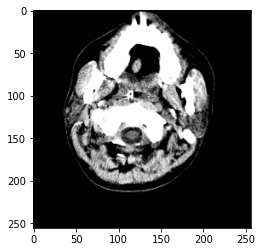

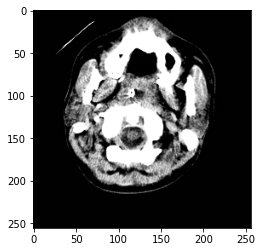

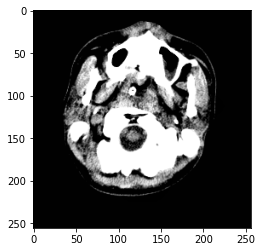

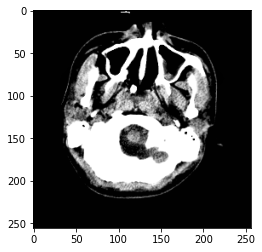

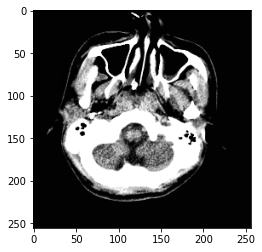

...

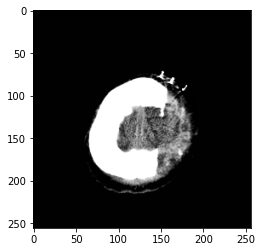

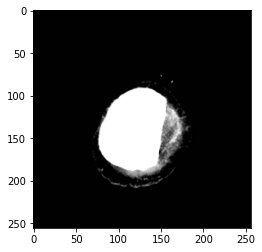

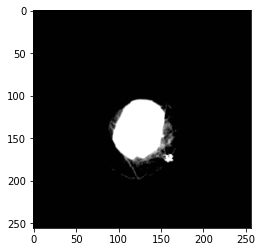

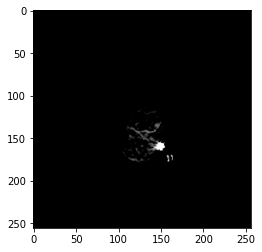

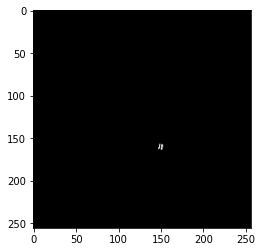

1


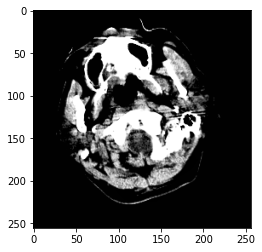

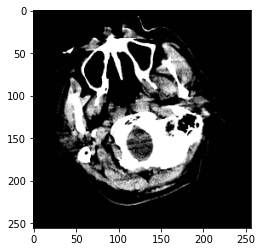

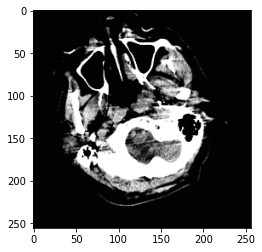

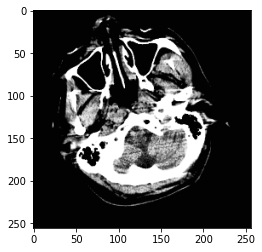

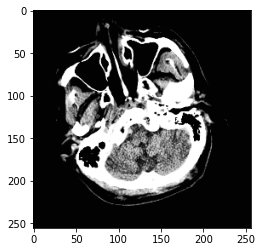

...

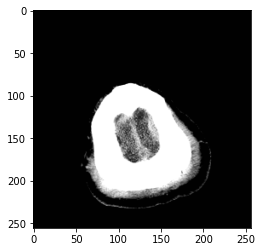

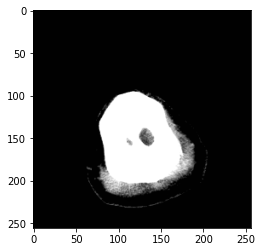

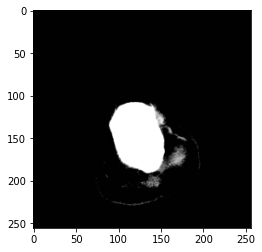

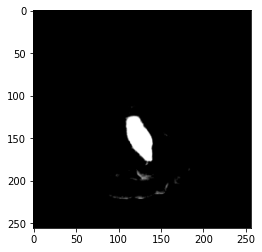

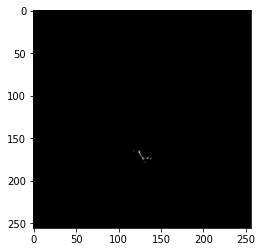

2


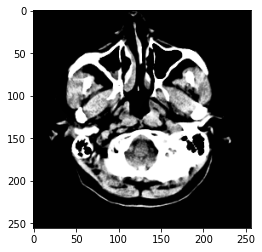

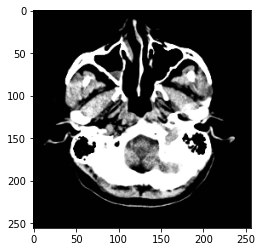

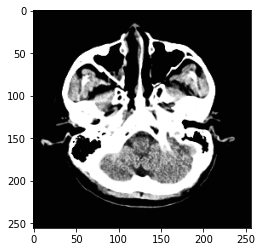

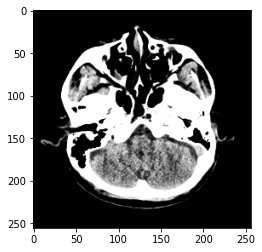

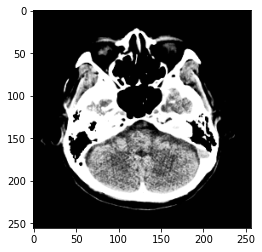

...

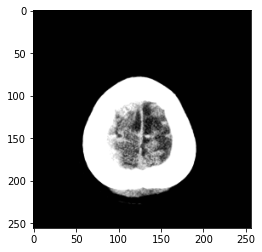

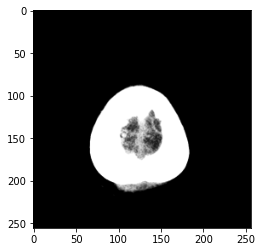

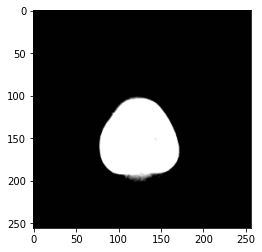

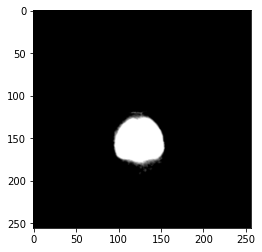

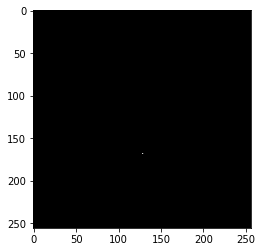

3


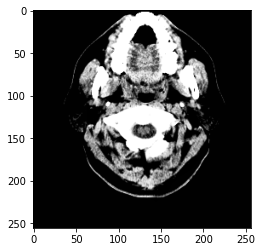

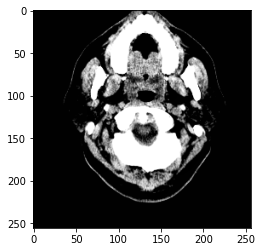

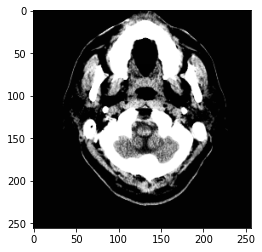

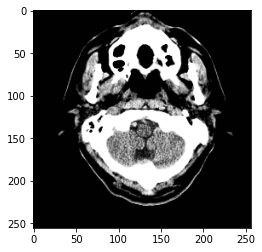

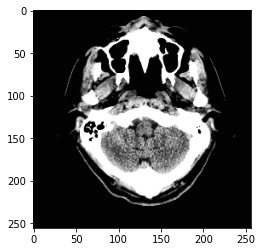

...

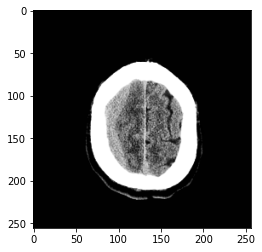

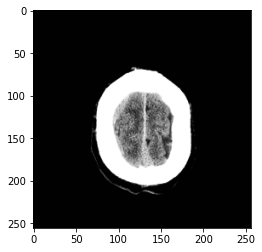

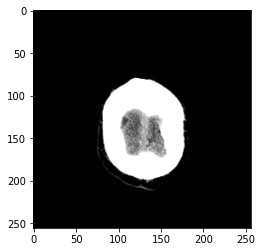

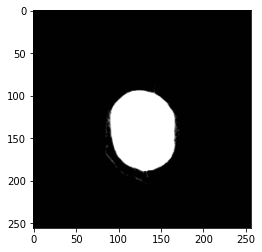

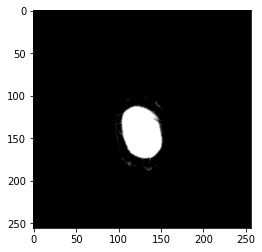

4


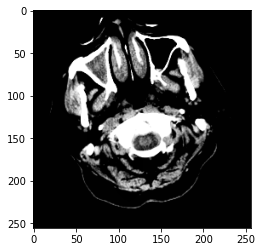

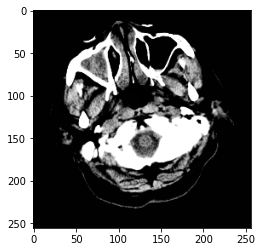

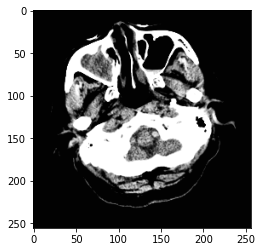

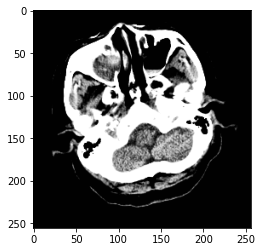

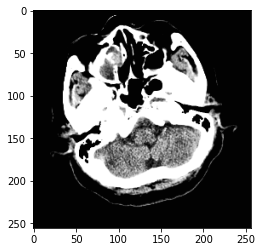

...

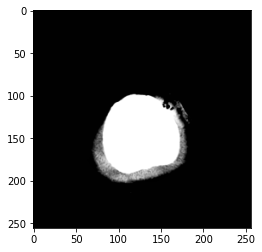

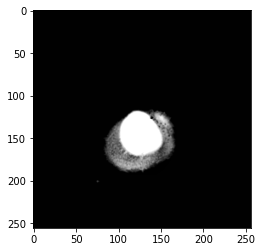

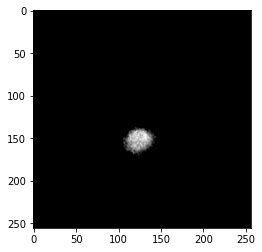

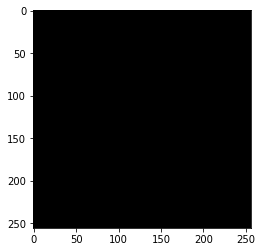

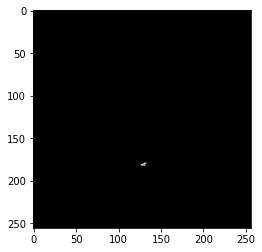

5


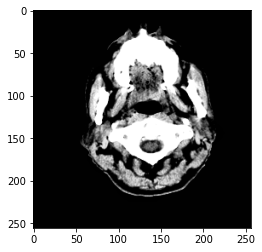

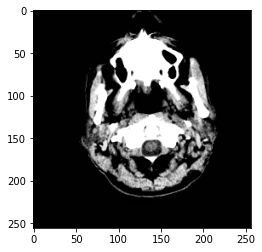

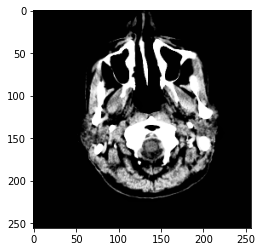

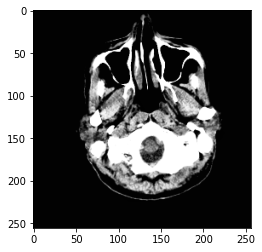

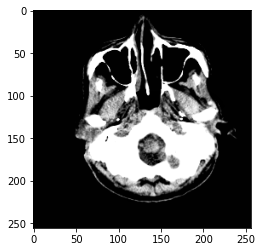

...

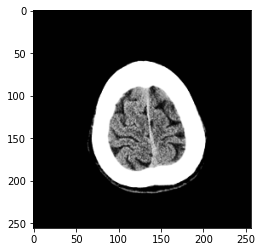

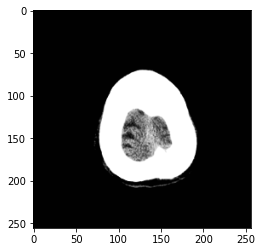

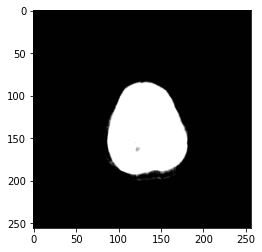

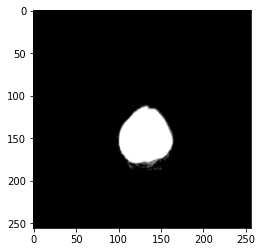

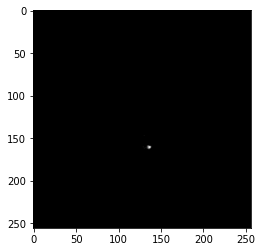

6


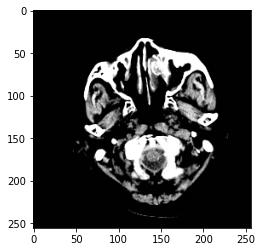

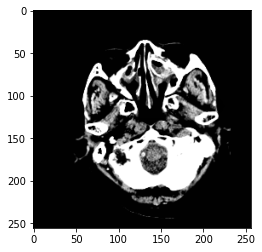

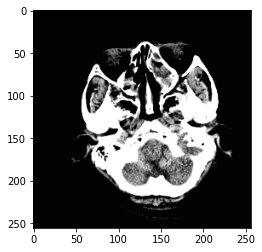

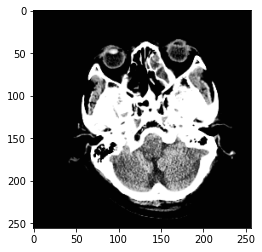

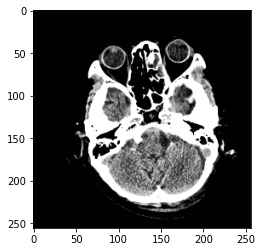

...

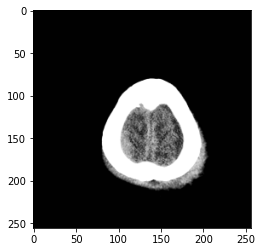

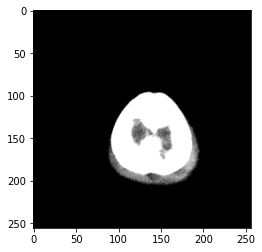

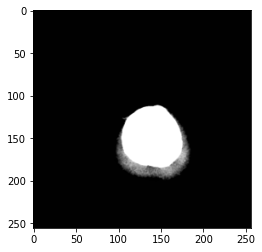

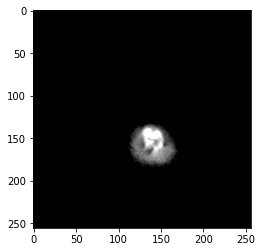

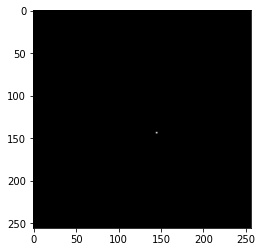

7


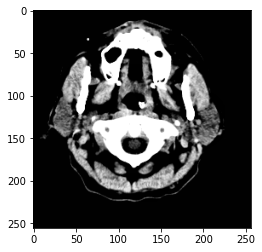

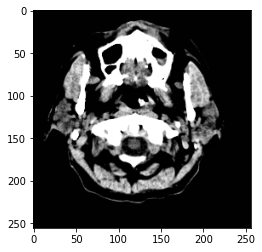

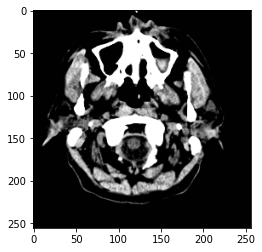

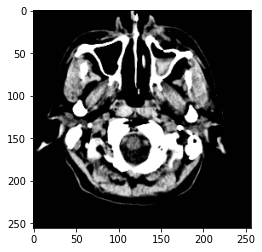

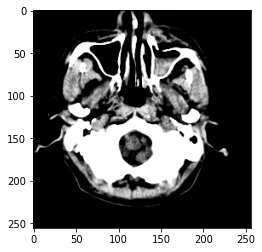

...

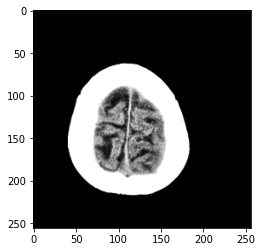

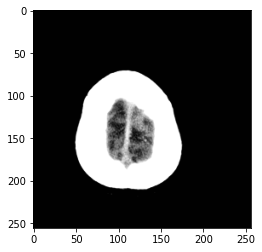

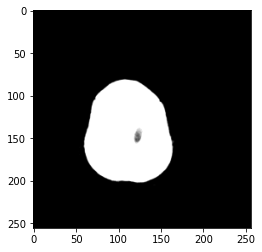

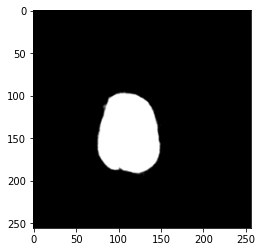

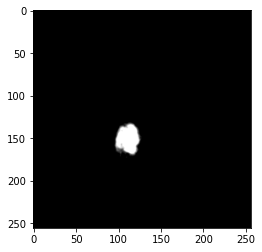

8


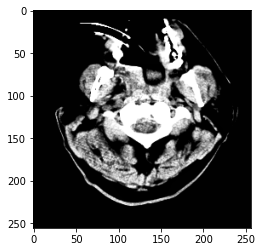

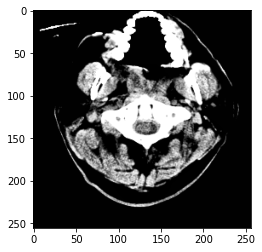

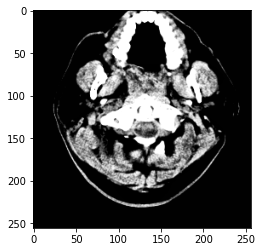

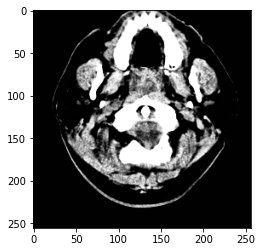

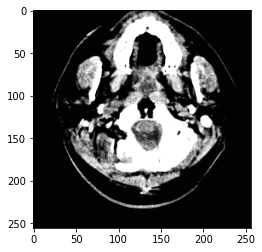

...

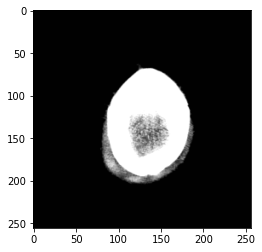

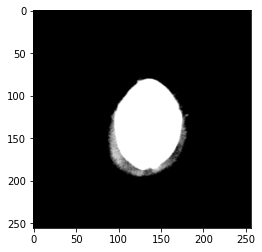

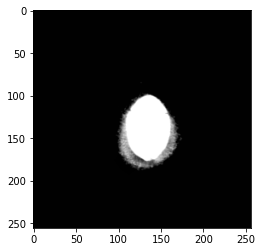

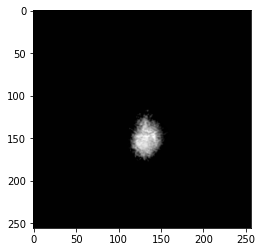

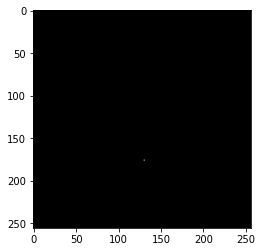

9


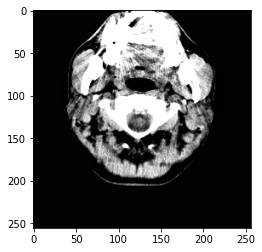

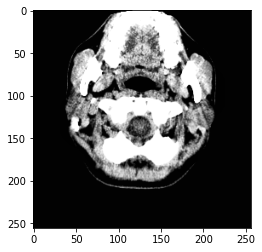

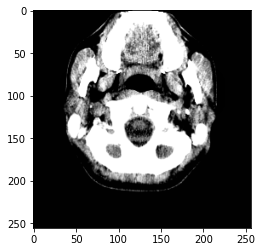

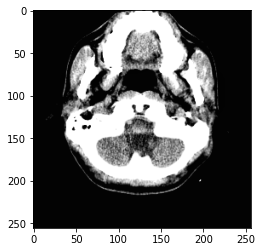

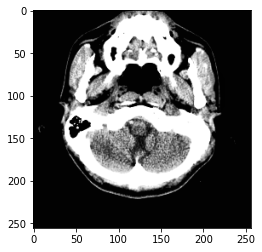

...

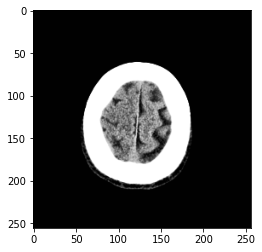

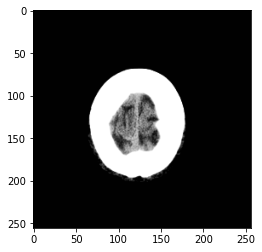

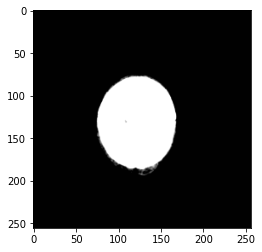

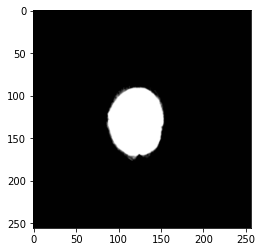

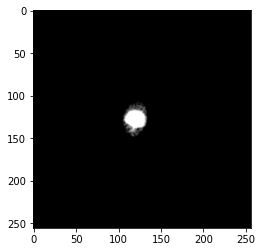

10


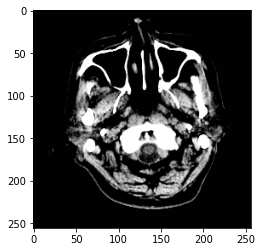

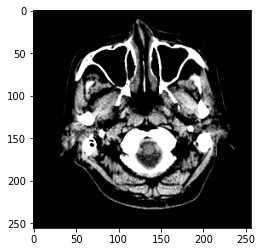

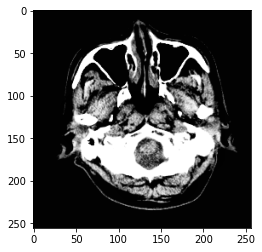

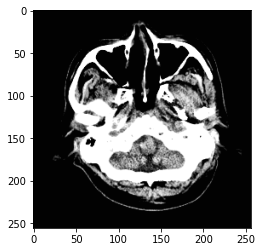

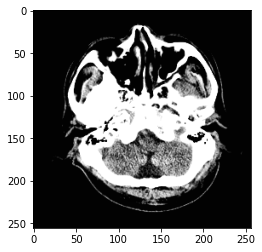

...

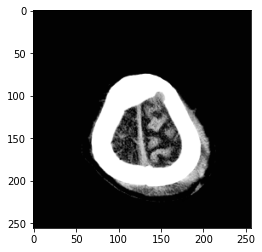

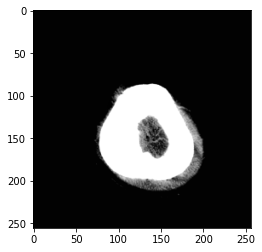

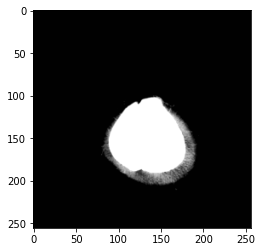

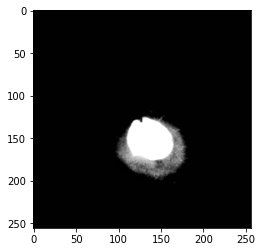

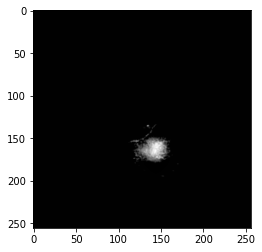

11


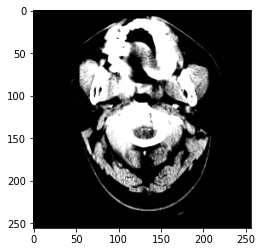

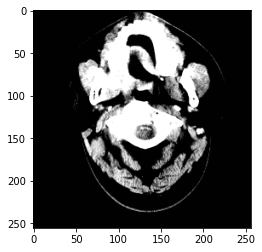

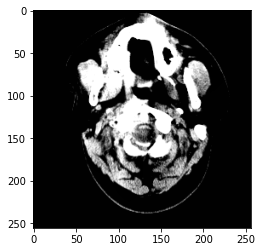

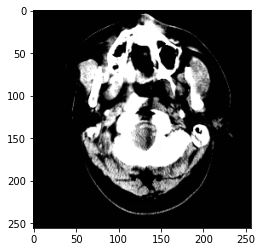

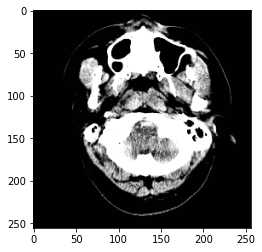

...

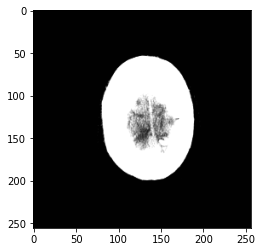

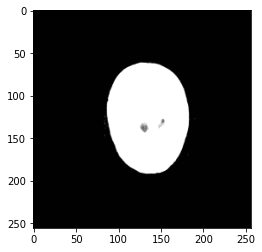

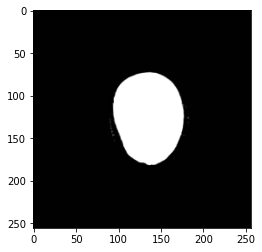

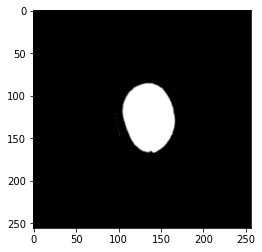

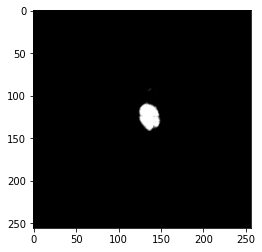

12


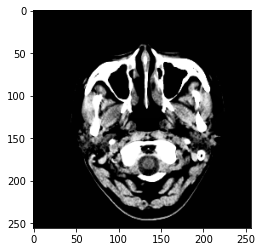

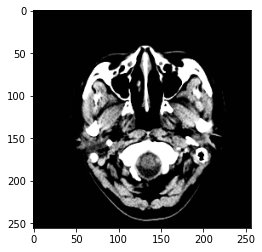

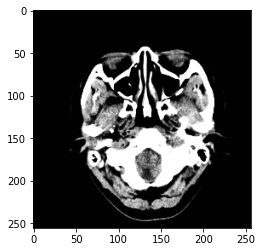

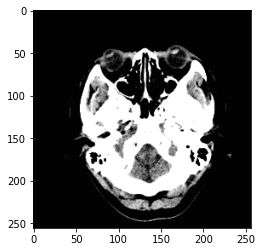

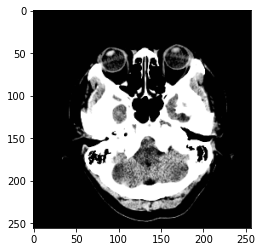

...

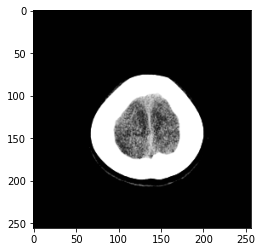

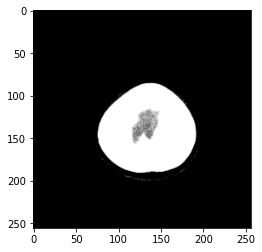

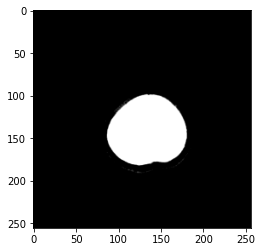

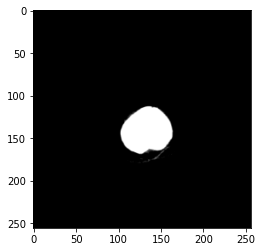

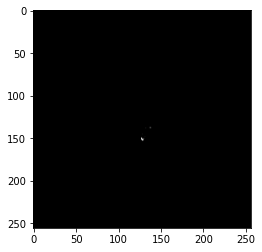

13


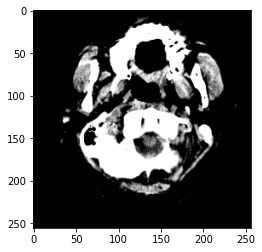

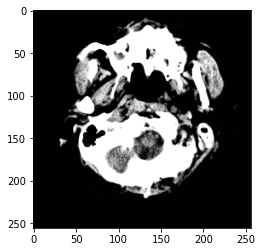

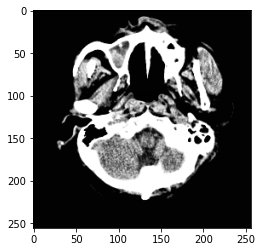

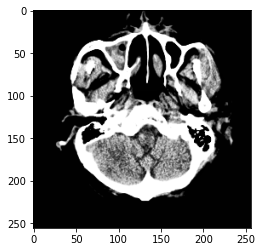

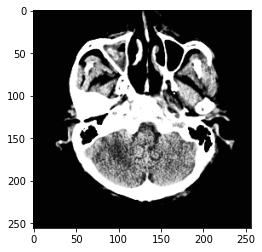

...

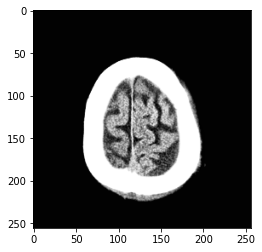

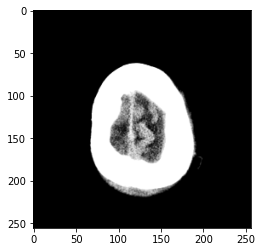

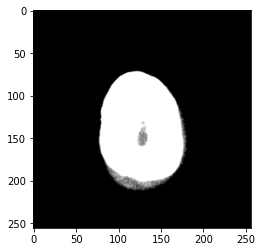

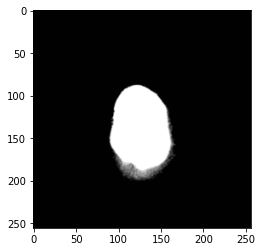

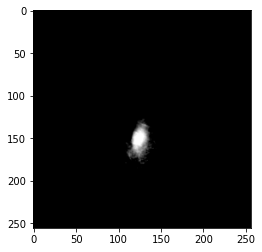

14


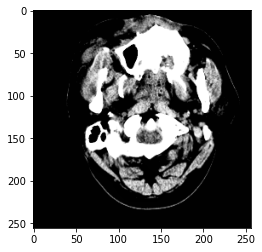

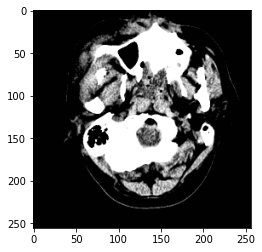

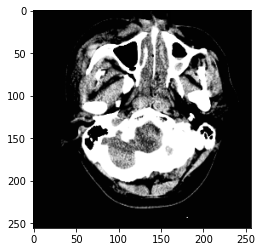

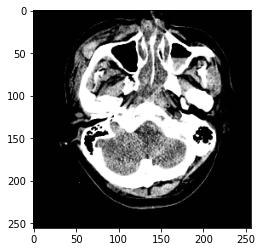

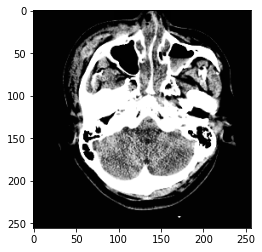

...

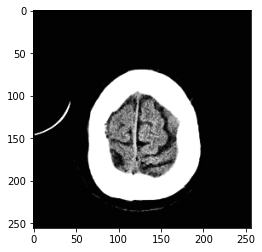

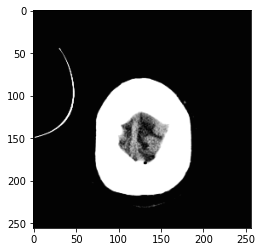

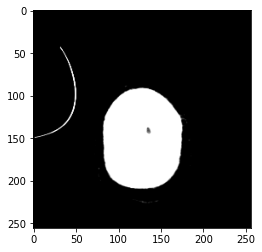

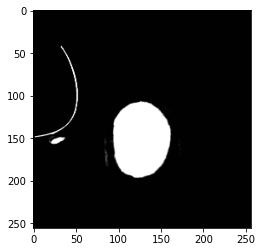

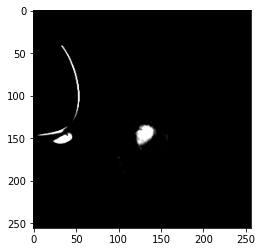

15


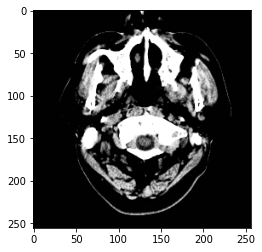

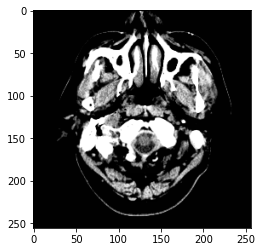

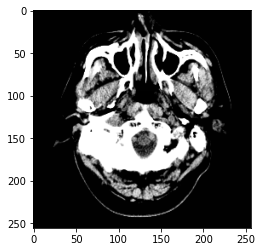

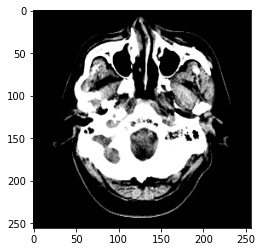

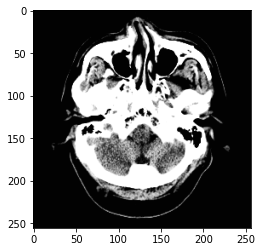

...

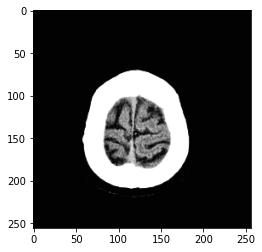

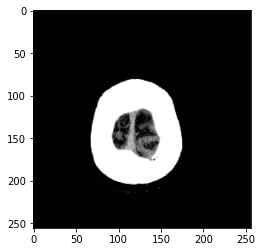

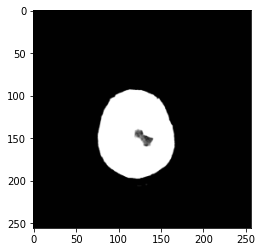

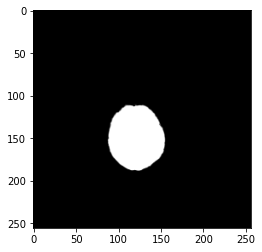

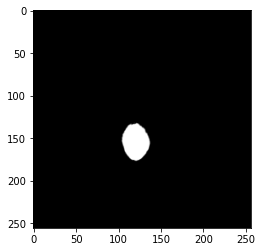

16


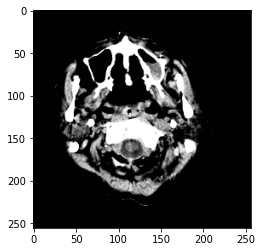

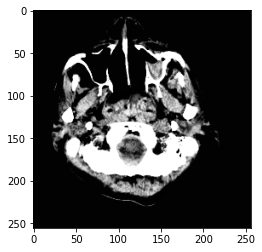

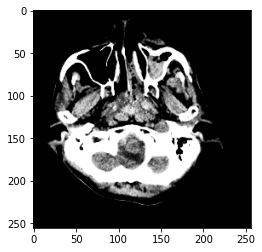

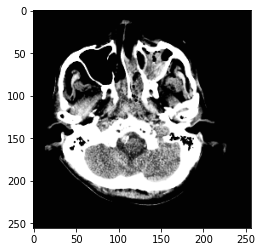

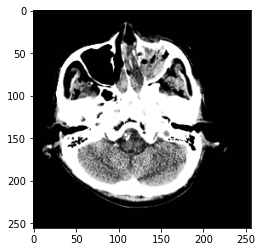

...

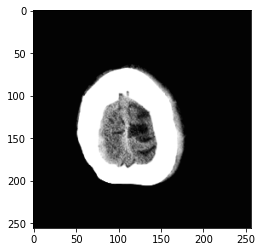

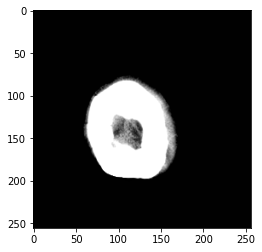

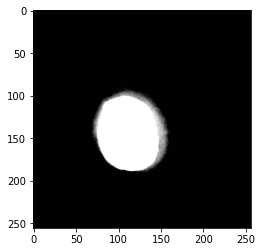

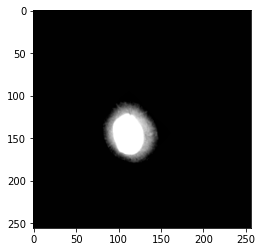

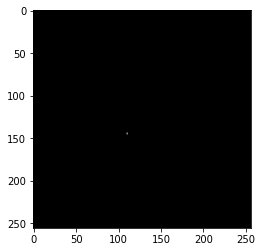

17


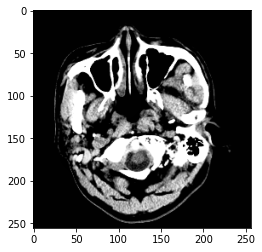

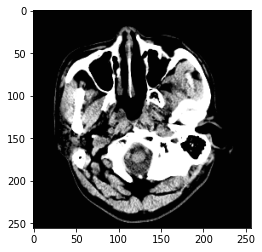

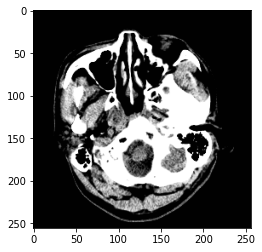

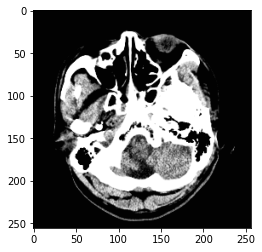

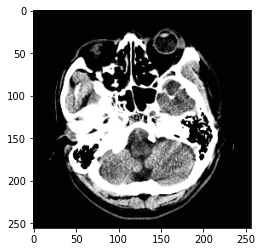

...

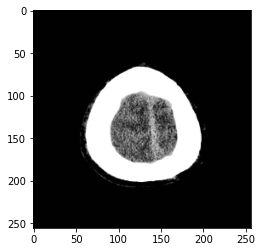

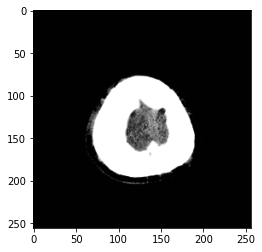

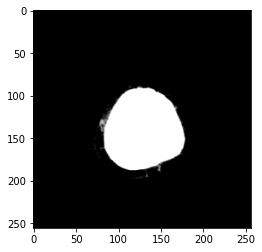

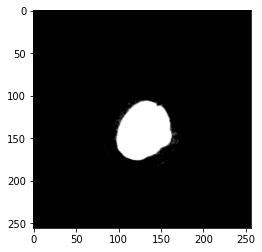

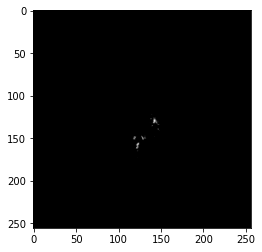

18


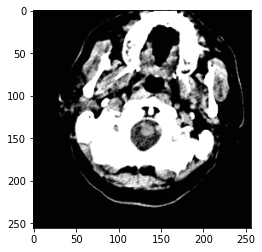

KeyboardInterrupt: 

In [162]:
import matplotlib.pyplot as plt

for j in range(30):
    z = data[j]
    print(j)
    for i in range(z['image'].shape[-1]):
        plt.imshow(z['image'].squeeze()[..., i], 'gray')
#         plt.imshow(z['label'].squeeze()[..., i], 'gray', alpha=0.5)
        plt.show()
    

In [11]:
from volumentations import *

In [14]:
import numpy as np

In [17]:
import random
random.randint(0, 10  - 1).clip(0, 10)

AttributeError: 'int' object has no attribute 'clip'

In [ ]:
np.array()

In [13]:
CropNonEmptyMaskIfExists

NameError: name 'CropNonEmptyMaskIfExists' is not defined

In [10]:
from volumentations import *

result = Compose([CropNonEmptyMaskIfExists(patch_size, always_apply=True)])(image=image, mask=mask)

NameError: name 'CropNonEmptyMaskIfExists' is not defined

In [5]:
CropNonEmptyMaskIfExists

NameError: name 'CropNonEmptyMaskIfExists' is not defined

In [3]:
!pip install volumentations

Defaulting to user installation because normal site-packages is not writeable


In [6]:
volumentations.transforms.CropNonEmptyMaskIfExists

AttributeError: module 'volumentations' has no attribute 'transforms'

In [13]:
import volumentations.augmentations.transforms.CropNonEmptyMaskIfExists

ModuleNotFoundError: No module named 'volumentations.augmentations.transforms.CropNonEmptyMaskIfExists'; 'volumentations.augmentations.transforms' is not a package

In [ ]:
volumentations

In [11]:
dir(volumentations.Crop3d)

['__call__',
 '__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_get_target_function',
 '_to_dict',
 'add_targets',
 'apply',
 'apply_to_bbox',
 'apply_to_bboxes',
 'apply_to_camera',
 'apply_to_cameras',
 'apply_to_features',
 'apply_to_labels',
 'apply_to_normals',
 'apply_with_params',
 'call_backup',
 'get_base_init_args',
 'get_class_fullname',
 'get_dict_with_id',
 'get_params',
 'get_params_dependent_on_targets',
 'get_transform_init_args',
 'get_transform_init_args_names',
 'set_deterministic',
 'target_dependence',
 'targets',
 'targets_as_params',
 'update_params']

In [1]:
!nvidia-smi

import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]= "3"

Fri Sep 10 11:24:10 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.91.03    Driver Version: 460.91.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Quadro RTX 8000     Off  | 00000000:1B:00.0 Off |                  Off |
| 32%   34C    P0    72W / 260W |      0MiB / 48601MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
|   1  Quadro RTX 8000     Off  | 00000000:1C:00.0 Off |                  Off |
| 41%   

In [2]:
import multiprocessing

multiprocessing.cpu_count()

64

In [3]:
import torch
print(torch.__version__)

1.8.0+cu111


In [ ]:
!pip uninstall -y monai

## 코드

In [ ]:
!python train.py \
--backbone-name 'efficientnet-b7' \
--model-name 'Down_3d_seg' \
--test-name 'Downstream_Efficient_CLS_SEG_REC_CON_SEG' \
--batch-size 2 \
--epochs 1000 \
--min-lr 5e-6 \
--lr 1e-4 \
--training-stream 'Downstream'\
--training-mode '3d_seg' \
--data-set 'Hemo_Downtask' \
--output '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Downstream_Efficient_CLS_SEG_REC_CON_SEG' \
--validate-every 5 \
--num_workers 12 \
--multi-gpu-mode 'DataParallel' \
--end2end "False" \
--pin-mem \
--start_epoch 0 \
--pretrained '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Upstream_Efficient/epoch_875_checkpoint.pth'

# --resume '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Reboot_Downstream_Consistency_SEG/epoch_1_checkpoint.pth' \

Not using distributed mode
***********************************************
*           Training Mode is  3d_seg          *
***********************************************
Dataset Name:  Hemo_Downtask
---------- Model ----------
Resume From:  
Output To:  /workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Downstream_Efficient_CLS_SEG_REC_CON_SEG
Number of GPUs:  1
---------- Optimizer ----------
Learning Rate:  0.0001
Weight Decay:  0.05
Batchsize:  2
Loading dataset ....
Train [Total]  number =  1068
Train [Hemo]   number =  747
Train [Normal] number =  321
Valid [Total]  number =  135
Valid [Hemo]   number =  35
Valid [Normal] number =  100
Creating model  : Down_3d_seg
Pretrained model: /workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Upstream_Efficient/epoch_875_checkpoint.pth
Check Before weight =  tensor([[[-0.0839,  0.3761, -0.0977],
         [ 0.2964, -0.0943,  0.2593],
         [-0.2728,  0.1727,  0.1438]]])
Check After weight =  tensor([[[-0.1305,  0.5339, -0.217

Valid:  [ 50/135]  eta: 0:01:13  loss: 0.9247 (1.5803)  time: 0.7993  data: 0.0002  max mem: 18339
Valid:  [ 60/135]  eta: 0:01:04  loss: 0.9330 (1.4747)  time: 0.7943  data: 0.0002  max mem: 18339
Valid:  [ 70/135]  eta: 0:00:55  loss: 0.9331 (1.3976)  time: 0.8058  data: 0.0002  max mem: 18339
Valid:  [ 80/135]  eta: 0:00:46  loss: 0.9281 (1.3405)  time: 0.7985  data: 0.0002  max mem: 18339
Valid:  [ 90/135]  eta: 0:00:37  loss: 0.9259 (1.2949)  time: 0.7870  data: 0.0002  max mem: 18339
Valid:  [100/135]  eta: 0:00:29  loss: 0.9246 (1.2587)  time: 0.8142  data: 0.0003  max mem: 18339
Valid:  [110/135]  eta: 0:00:20  loss: 0.9325 (1.2299)  time: 0.8149  data: 0.0003  max mem: 18339
Valid:  [120/135]  eta: 0:00:12  loss: 0.9342 (1.2051)  time: 0.8120  data: 0.0001  max mem: 18339
Valid:  [130/135]  eta: 0:00:04  loss: 0.9275 (1.1840)  time: 0.8169  data: 0.0001  max mem: 18339
Valid:  [134/135]  eta: 0:00:00  loss: 0.9314 (1.1765)  time: 0.8061  data: 0.0001  max mem: 18339
Valid: Tot

Epoch: [2]  [ 50/534]  eta: 0:30:07  lr: 0.000010  loss: 1.8304 (1.8183)  time: 3.6480  data: 0.0003  max mem: 18339
Epoch: [2]  [ 60/534]  eta: 0:29:01  lr: 0.000010  loss: 1.8054 (1.7996)  time: 3.5889  data: 0.0013  max mem: 18339
Epoch: [2]  [ 70/534]  eta: 0:28:17  lr: 0.000010  loss: 1.7908 (1.7701)  time: 3.4685  data: 0.0013  max mem: 18339
Epoch: [2]  [ 80/534]  eta: 0:27:56  lr: 0.000010  loss: 1.7675 (1.7686)  time: 3.7463  data: 0.0002  max mem: 18339
Epoch: [2]  [ 90/534]  eta: 0:27:03  lr: 0.000010  loss: 1.7517 (1.7552)  time: 3.6447  data: 0.0002  max mem: 18339
Epoch: [2]  [100/534]  eta: 0:26:31  lr: 0.000010  loss: 1.7285 (1.7432)  time: 3.5625  data: 0.0002  max mem: 18339
Epoch: [2]  [110/534]  eta: 0:25:58  lr: 0.000010  loss: 1.7104 (1.7214)  time: 3.7633  data: 0.0002  max mem: 18339
Epoch: [2]  [120/534]  eta: 0:25:30  lr: 0.000010  loss: 1.6650 (1.7011)  time: 3.8468  data: 0.0002  max mem: 18339
Epoch: [2]  [130/534]  eta: 0:24:38  lr: 0.000010  loss: 1.6625 

Epoch: [3]  [200/534]  eta: 0:19:11  lr: 0.000020  loss: 1.3355 (1.2745)  time: 3.2874  data: 0.0001  max mem: 18339
Epoch: [3]  [210/534]  eta: 0:18:39  lr: 0.000020  loss: 1.3326 (1.2678)  time: 3.3838  data: 0.0001  max mem: 18339
Epoch: [3]  [220/534]  eta: 0:18:06  lr: 0.000020  loss: 1.3119 (1.2567)  time: 3.5775  data: 0.0002  max mem: 18339
Epoch: [3]  [230/534]  eta: 0:17:28  lr: 0.000020  loss: 1.3139 (1.2553)  time: 3.4017  data: 0.0002  max mem: 18339
Epoch: [3]  [240/534]  eta: 0:16:58  lr: 0.000020  loss: 1.3218 (1.2538)  time: 3.5209  data: 0.0002  max mem: 18339
Epoch: [3]  [250/534]  eta: 0:16:24  lr: 0.000020  loss: 1.3104 (1.2521)  time: 3.6836  data: 0.0002  max mem: 18339
Epoch: [3]  [260/534]  eta: 0:15:46  lr: 0.000020  loss: 1.3123 (1.2504)  time: 3.3344  data: 0.0002  max mem: 18339
Epoch: [3]  [270/534]  eta: 0:15:14  lr: 0.000020  loss: 1.3111 (1.2521)  time: 3.4201  data: 0.0002  max mem: 18339
Epoch: [3]  [280/534]  eta: 0:14:38  lr: 0.000020  loss: 1.3043 

Epoch: [4]  [350/534]  eta: 0:10:40  lr: 0.000030  loss: 1.1148 (1.0579)  time: 3.4286  data: 0.0002  max mem: 18339
Epoch: [4]  [360/534]  eta: 0:10:05  lr: 0.000030  loss: 1.1153 (1.0560)  time: 3.4894  data: 0.0002  max mem: 18339
Epoch: [4]  [370/534]  eta: 0:09:31  lr: 0.000030  loss: 1.0786 (1.0542)  time: 3.5025  data: 0.0002  max mem: 18339
Epoch: [4]  [380/534]  eta: 0:08:56  lr: 0.000030  loss: 1.0950 (1.0504)  time: 3.4765  data: 0.0002  max mem: 18339
Epoch: [4]  [390/534]  eta: 0:08:20  lr: 0.000030  loss: 1.0986 (1.0488)  time: 3.4111  data: 0.0002  max mem: 18339
Epoch: [4]  [400/534]  eta: 0:07:45  lr: 0.000030  loss: 1.0740 (1.0494)  time: 3.3986  data: 0.0002  max mem: 18339
Epoch: [4]  [410/534]  eta: 0:07:14  lr: 0.000030  loss: 1.0731 (1.0475)  time: 3.9527  data: 0.0002  max mem: 18339
Epoch: [4]  [420/534]  eta: 0:06:39  lr: 0.000030  loss: 1.0818 (1.0441)  time: 3.9965  data: 0.0002  max mem: 18339
Epoch: [4]  [430/534]  eta: 0:06:03  lr: 0.000030  loss: 1.0735 

Epoch: [5]  [500/534]  eta: 0:01:58  lr: 0.000040  loss: 0.9559 (0.8794)  time: 3.4644  data: 0.0002  max mem: 18339
Epoch: [5]  [510/534]  eta: 0:01:23  lr: 0.000040  loss: 0.8770 (0.8799)  time: 3.4924  data: 0.0002  max mem: 18339
Epoch: [5]  [520/534]  eta: 0:00:48  lr: 0.000040  loss: 0.9262 (0.8790)  time: 3.3959  data: 0.0002  max mem: 18339
Epoch: [5]  [530/534]  eta: 0:00:13  lr: 0.000040  loss: 0.9058 (0.8787)  time: 3.4974  data: 0.0002  max mem: 18339
Epoch: [5]  [533/534]  eta: 0:00:03  lr: 0.000040  loss: 0.9262 (0.8793)  time: 3.5619  data: 0.0002  max mem: 18339
Epoch: [5] Total time: 0:30:59 (3.4829 s / it)
Averaged stats: lr: 0.000040  loss: 0.9262 (0.8793)
Valid:  [  0/135]  eta: 0:08:17  loss: 0.9526 (0.9526)  time: 3.6828  data: 2.8142  max mem: 18339
Valid:  [ 10/135]  eta: 0:02:14  loss: 0.8525 (0.8367)  time: 1.0748  data: 0.2562  max mem: 18339
Valid:  [ 20/135]  eta: 0:01:48  loss: 0.8525 (0.8290)  time: 0.8034  data: 0.0003  max mem: 18339
Valid:  [ 30/135]  

Epoch: [6]  [510/534]  eta: 0:01:23  lr: 0.000050  loss: 0.6463 (0.6989)  time: 3.4401  data: 0.0002  max mem: 18339
Epoch: [6]  [520/534]  eta: 0:00:49  lr: 0.000050  loss: 0.6093 (0.6984)  time: 3.3941  data: 0.0002  max mem: 18339
Epoch: [6]  [530/534]  eta: 0:00:13  lr: 0.000050  loss: 0.7272 (0.6980)  time: 3.4196  data: 0.0001  max mem: 18339
Epoch: [6]  [533/534]  eta: 0:00:03  lr: 0.000050  loss: 0.6093 (0.6975)  time: 3.4102  data: 0.0001  max mem: 18339
Epoch: [6] Total time: 0:31:07 (3.4977 s / it)
Averaged stats: lr: 0.000050  loss: 0.6093 (0.6975)
Epoch: [7]  [  0/534]  eta: 0:53:52  lr: 0.000060  loss: 0.9292 (0.9292)  time: 6.0541  data: 3.4942  max mem: 18339
Epoch: [7]  [ 10/534]  eta: 0:31:16  lr: 0.000060  loss: 0.5666 (0.6004)  time: 3.5813  data: 0.3178  max mem: 18339
Epoch: [7]  [ 20/534]  eta: 0:31:47  lr: 0.000060  loss: 0.4749 (0.4909)  time: 3.5944  data: 0.0002  max mem: 18339
Epoch: [7]  [ 30/534]  eta: 0:30:37  lr: 0.000060  loss: 0.4414 (0.5036)  time: 3.

Epoch: [8]  [100/534]  eta: 0:25:41  lr: 0.000070  loss: 0.3520 (0.3954)  time: 3.3750  data: 0.0002  max mem: 18339
Epoch: [8]  [110/534]  eta: 0:25:00  lr: 0.000070  loss: 0.2856 (0.3888)  time: 3.4466  data: 0.0002  max mem: 18339
Epoch: [8]  [120/534]  eta: 0:24:25  lr: 0.000070  loss: 0.3912 (0.3989)  time: 3.4834  data: 0.0002  max mem: 18339
Epoch: [8]  [130/534]  eta: 0:23:48  lr: 0.000070  loss: 0.4852 (0.4088)  time: 3.5174  data: 0.0001  max mem: 18339
Epoch: [8]  [140/534]  eta: 0:23:15  lr: 0.000070  loss: 0.4048 (0.4113)  time: 3.5556  data: 0.0001  max mem: 18339
Epoch: [8]  [150/534]  eta: 0:22:43  lr: 0.000070  loss: 0.4048 (0.4147)  time: 3.6477  data: 0.0001  max mem: 18339
Epoch: [8]  [160/534]  eta: 0:22:15  lr: 0.000070  loss: 0.4450 (0.4168)  time: 3.7675  data: 0.0001  max mem: 18339
Epoch: [8]  [170/534]  eta: 0:21:37  lr: 0.000070  loss: 0.3939 (0.4198)  time: 3.6693  data: 0.0002  max mem: 18339
Epoch: [8]  [180/534]  eta: 0:21:03  lr: 0.000070  loss: 0.3133 

Epoch: [9]  [250/534]  eta: 0:17:28  lr: 0.000080  loss: 0.3388 (0.4167)  time: 3.8208  data: 0.0002  max mem: 18339
Epoch: [9]  [260/534]  eta: 0:16:53  lr: 0.000080  loss: 0.3500 (0.4160)  time: 3.9791  data: 0.0002  max mem: 18339
Epoch: [9]  [270/534]  eta: 0:16:15  lr: 0.000080  loss: 0.3490 (0.4151)  time: 3.6939  data: 0.0002  max mem: 18339
Epoch: [9]  [280/534]  eta: 0:15:37  lr: 0.000080  loss: 0.3197 (0.4129)  time: 3.5602  data: 0.0002  max mem: 18339
Epoch: [9]  [290/534]  eta: 0:14:58  lr: 0.000080  loss: 0.3142 (0.4099)  time: 3.5108  data: 0.0002  max mem: 18339
Epoch: [9]  [300/534]  eta: 0:14:18  lr: 0.000080  loss: 0.3142 (0.4100)  time: 3.3955  data: 0.0002  max mem: 18339
Epoch: [9]  [310/534]  eta: 0:13:43  lr: 0.000080  loss: 0.3768 (0.4111)  time: 3.6320  data: 0.0002  max mem: 18339
Epoch: [9]  [320/534]  eta: 0:13:04  lr: 0.000080  loss: 0.4136 (0.4127)  time: 3.5839  data: 0.0002  max mem: 18339
Epoch: [9]  [330/534]  eta: 0:12:26  lr: 0.000080  loss: 0.3438 

Epoch: [10]  [390/534]  eta: 0:08:37  lr: 0.000090  loss: 0.3783 (0.3965)  time: 3.9621  data: 0.0002  max mem: 18339
Epoch: [10]  [400/534]  eta: 0:08:01  lr: 0.000090  loss: 0.3502 (0.3961)  time: 3.7137  data: 0.0002  max mem: 18339
Epoch: [10]  [410/534]  eta: 0:07:25  lr: 0.000090  loss: 0.3552 (0.3972)  time: 3.5943  data: 0.0002  max mem: 18339
Epoch: [10]  [420/534]  eta: 0:06:48  lr: 0.000090  loss: 0.3552 (0.3958)  time: 3.5002  data: 0.0002  max mem: 18339
Epoch: [10]  [430/534]  eta: 0:06:13  lr: 0.000090  loss: 0.2928 (0.3959)  time: 3.6506  data: 0.0002  max mem: 18339
Epoch: [10]  [440/534]  eta: 0:05:38  lr: 0.000090  loss: 0.2947 (0.3938)  time: 3.9112  data: 0.0001  max mem: 18339
Epoch: [10]  [450/534]  eta: 0:05:02  lr: 0.000090  loss: 0.3231 (0.3938)  time: 3.7677  data: 0.0002  max mem: 18339
Epoch: [10]  [460/534]  eta: 0:04:26  lr: 0.000090  loss: 0.3406 (0.3928)  time: 3.5052  data: 0.0002  max mem: 18339
Epoch: [10]  [470/534]  eta: 0:03:49  lr: 0.000090  loss

Epoch: [11]  [390/534]  eta: 0:08:53  lr: 0.000100  loss: 0.2871 (0.3623)  time: 3.9593  data: 0.0002  max mem: 18339
Epoch: [11]  [400/534]  eta: 0:08:15  lr: 0.000100  loss: 0.2528 (0.3611)  time: 3.7427  data: 0.0002  max mem: 18339
Epoch: [11]  [410/534]  eta: 0:07:37  lr: 0.000100  loss: 0.2662 (0.3589)  time: 3.4130  data: 0.0002  max mem: 18339
Epoch: [11]  [420/534]  eta: 0:07:00  lr: 0.000100  loss: 0.2611 (0.3581)  time: 3.6382  data: 0.0002  max mem: 18339
Epoch: [11]  [430/534]  eta: 0:06:24  lr: 0.000100  loss: 0.2611 (0.3576)  time: 3.8220  data: 0.0002  max mem: 18339
Epoch: [11]  [440/534]  eta: 0:05:47  lr: 0.000100  loss: 0.3513 (0.3592)  time: 3.8348  data: 0.0002  max mem: 18339
Epoch: [11]  [450/534]  eta: 0:05:10  lr: 0.000100  loss: 0.3649 (0.3619)  time: 3.8310  data: 0.0002  max mem: 18339
Epoch: [11]  [460/534]  eta: 0:04:33  lr: 0.000100  loss: 0.3172 (0.3603)  time: 3.4812  data: 0.0002  max mem: 18339
Epoch: [11]  [470/534]  eta: 0:03:56  lr: 0.000100  loss

Epoch: [12]  [530/534]  eta: 0:00:14  lr: 0.000100  loss: 0.3533 (0.3702)  time: 3.8745  data: 0.0001  max mem: 18339
Epoch: [12]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3240 (0.3693)  time: 3.8984  data: 0.0001  max mem: 18339
Epoch: [12] Total time: 0:32:27 (3.6474 s / it)
Averaged stats: lr: 0.000100  loss: 0.3240 (0.3693)
Epoch: [13]  [  0/534]  eta: 0:47:18  lr: 0.000100  loss: 0.8434 (0.8434)  time: 5.3160  data: 3.2168  max mem: 18339
Epoch: [13]  [ 10/534]  eta: 0:35:08  lr: 0.000100  loss: 0.3885 (0.4920)  time: 4.0230  data: 0.2926  max mem: 18339
Epoch: [13]  [ 20/534]  eta: 0:31:28  lr: 0.000100  loss: 0.3326 (0.3701)  time: 3.5914  data: 0.0002  max mem: 18339
Epoch: [13]  [ 30/534]  eta: 0:30:31  lr: 0.000100  loss: 0.3457 (0.3755)  time: 3.4208  data: 0.0002  max mem: 18339
Epoch: [13]  [ 40/534]  eta: 0:31:24  lr: 0.000100  loss: 0.3486 (0.3637)  time: 3.9624  data: 0.0002  max mem: 18339
Epoch: [13]  [ 50/534]  eta: 0:30:15  lr: 0.000100  loss: 0.3392 (0.3625) 

Epoch: [14]  [110/534]  eta: 0:25:28  lr: 0.000100  loss: 0.2634 (0.3541)  time: 3.5809  data: 0.0002  max mem: 18339
Epoch: [14]  [120/534]  eta: 0:24:54  lr: 0.000100  loss: 0.2501 (0.3488)  time: 3.7202  data: 0.0002  max mem: 18339
Epoch: [14]  [130/534]  eta: 0:24:18  lr: 0.000100  loss: 0.2606 (0.3438)  time: 3.6294  data: 0.0002  max mem: 18339
Epoch: [14]  [140/534]  eta: 0:23:51  lr: 0.000100  loss: 0.2739 (0.3421)  time: 3.7829  data: 0.0002  max mem: 18339
Epoch: [14]  [150/534]  eta: 0:23:08  lr: 0.000100  loss: 0.2739 (0.3362)  time: 3.6660  data: 0.0002  max mem: 18339
Epoch: [14]  [160/534]  eta: 0:22:30  lr: 0.000100  loss: 0.2710 (0.3331)  time: 3.4462  data: 0.0002  max mem: 18339
Epoch: [14]  [170/534]  eta: 0:21:47  lr: 0.000100  loss: 0.3217 (0.3387)  time: 3.4143  data: 0.0002  max mem: 18339
Epoch: [14]  [180/534]  eta: 0:21:09  lr: 0.000100  loss: 0.3323 (0.3373)  time: 3.3896  data: 0.0002  max mem: 18339
Epoch: [14]  [190/534]  eta: 0:20:39  lr: 0.000100  loss

Epoch: [15]  [250/534]  eta: 0:17:09  lr: 0.000100  loss: 0.2657 (0.3629)  time: 3.4558  data: 0.0002  max mem: 18339
Epoch: [15]  [260/534]  eta: 0:16:38  lr: 0.000100  loss: 0.2914 (0.3630)  time: 3.7938  data: 0.0001  max mem: 18339
Epoch: [15]  [270/534]  eta: 0:16:03  lr: 0.000100  loss: 0.4264 (0.3640)  time: 3.9562  data: 0.0002  max mem: 18339
Epoch: [15]  [280/534]  eta: 0:15:29  lr: 0.000100  loss: 0.3608 (0.3647)  time: 3.8387  data: 0.0002  max mem: 18339
Epoch: [15]  [290/534]  eta: 0:14:52  lr: 0.000100  loss: 0.3606 (0.3679)  time: 3.7650  data: 0.0002  max mem: 18339
Epoch: [15]  [300/534]  eta: 0:14:13  lr: 0.000100  loss: 0.3443 (0.3666)  time: 3.4900  data: 0.0001  max mem: 18339
Epoch: [15]  [310/534]  eta: 0:13:38  lr: 0.000100  loss: 0.3189 (0.3661)  time: 3.5858  data: 0.0001  max mem: 18339
Epoch: [15]  [320/534]  eta: 0:12:59  lr: 0.000100  loss: 0.3189 (0.3685)  time: 3.5282  data: 0.0001  max mem: 18339
Epoch: [15]  [330/534]  eta: 0:12:21  lr: 0.000100  loss

Epoch: [16]  [250/534]  eta: 0:17:08  lr: 0.000100  loss: 0.2416 (0.3458)  time: 3.7478  data: 0.0001  max mem: 18339
Epoch: [16]  [260/534]  eta: 0:16:28  lr: 0.000100  loss: 0.2747 (0.3460)  time: 3.3017  data: 0.0001  max mem: 18339
Epoch: [16]  [270/534]  eta: 0:15:54  lr: 0.000100  loss: 0.2747 (0.3471)  time: 3.5351  data: 0.0002  max mem: 18339
Epoch: [16]  [280/534]  eta: 0:15:16  lr: 0.000100  loss: 0.4303 (0.3500)  time: 3.6560  data: 0.0002  max mem: 18339
Epoch: [16]  [290/534]  eta: 0:14:42  lr: 0.000100  loss: 0.4692 (0.3544)  time: 3.6210  data: 0.0001  max mem: 18339
Epoch: [16]  [300/534]  eta: 0:14:06  lr: 0.000100  loss: 0.3523 (0.3554)  time: 3.7523  data: 0.0001  max mem: 18339
Epoch: [16]  [310/534]  eta: 0:13:32  lr: 0.000100  loss: 0.3006 (0.3534)  time: 3.8296  data: 0.0002  max mem: 18339
Epoch: [16]  [320/534]  eta: 0:12:56  lr: 0.000100  loss: 0.2867 (0.3523)  time: 3.7353  data: 0.0002  max mem: 18339
Epoch: [16]  [330/534]  eta: 0:12:20  lr: 0.000100  loss

Epoch: [17]  [390/534]  eta: 0:08:43  lr: 0.000100  loss: 0.3558 (0.3646)  time: 3.2532  data: 0.0001  max mem: 18339
Epoch: [17]  [400/534]  eta: 0:08:07  lr: 0.000100  loss: 0.4433 (0.3657)  time: 3.6040  data: 0.0002  max mem: 18339
Epoch: [17]  [410/534]  eta: 0:07:30  lr: 0.000100  loss: 0.4418 (0.3661)  time: 3.5807  data: 0.0002  max mem: 18339
Epoch: [17]  [420/534]  eta: 0:06:53  lr: 0.000100  loss: 0.3362 (0.3656)  time: 3.3932  data: 0.0002  max mem: 18339
Epoch: [17]  [430/534]  eta: 0:06:17  lr: 0.000100  loss: 0.3116 (0.3654)  time: 3.5962  data: 0.0002  max mem: 18339
Epoch: [17]  [440/534]  eta: 0:05:41  lr: 0.000100  loss: 0.3116 (0.3632)  time: 3.8081  data: 0.0002  max mem: 18339
Epoch: [17]  [450/534]  eta: 0:05:05  lr: 0.000100  loss: 0.2548 (0.3635)  time: 3.7957  data: 0.0001  max mem: 18339
Epoch: [17]  [460/534]  eta: 0:04:29  lr: 0.000100  loss: 0.2603 (0.3622)  time: 3.7404  data: 0.0002  max mem: 18339
Epoch: [17]  [470/534]  eta: 0:03:53  lr: 0.000100  loss

Epoch: [18]  [530/534]  eta: 0:00:14  lr: 0.000100  loss: 0.2306 (0.3448)  time: 3.5757  data: 0.0001  max mem: 18339
Epoch: [18]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2992 (0.3459)  time: 3.5377  data: 0.0001  max mem: 18339
Epoch: [18] Total time: 0:32:04 (3.6048 s / it)
Averaged stats: lr: 0.000100  loss: 0.2992 (0.3459)
Epoch: [19]  [  0/534]  eta: 0:50:43  lr: 0.000100  loss: 0.3923 (0.3923)  time: 5.6996  data: 3.6659  max mem: 18339
Epoch: [19]  [ 10/534]  eta: 0:31:46  lr: 0.000100  loss: 0.3923 (0.3915)  time: 3.6383  data: 0.3334  max mem: 18339
Epoch: [19]  [ 20/534]  eta: 0:32:35  lr: 0.000100  loss: 0.3067 (0.3443)  time: 3.7087  data: 0.0001  max mem: 18339
Epoch: [19]  [ 30/534]  eta: 0:31:29  lr: 0.000100  loss: 0.3002 (0.3421)  time: 3.8114  data: 0.0002  max mem: 18339
Epoch: [19]  [ 40/534]  eta: 0:30:31  lr: 0.000100  loss: 0.3087 (0.3682)  time: 3.6061  data: 0.0001  max mem: 18339
Epoch: [19]  [ 50/534]  eta: 0:31:04  lr: 0.000100  loss: 0.3046 (0.3518) 

Epoch: [20]  [110/534]  eta: 0:25:35  lr: 0.000100  loss: 0.3085 (0.3559)  time: 3.6572  data: 0.0002  max mem: 18339
Epoch: [20]  [120/534]  eta: 0:25:14  lr: 0.000100  loss: 0.2583 (0.3575)  time: 3.7846  data: 0.0002  max mem: 18339
Epoch: [20]  [130/534]  eta: 0:24:50  lr: 0.000100  loss: 0.3352 (0.3606)  time: 4.0726  data: 0.0002  max mem: 18339
Epoch: [20]  [140/534]  eta: 0:24:06  lr: 0.000100  loss: 0.3045 (0.3487)  time: 3.7601  data: 0.0001  max mem: 18339
Epoch: [20]  [150/534]  eta: 0:23:30  lr: 0.000100  loss: 0.2681 (0.3513)  time: 3.5545  data: 0.0001  max mem: 18339
Epoch: [20]  [160/534]  eta: 0:22:54  lr: 0.000100  loss: 0.2681 (0.3505)  time: 3.7022  data: 0.0002  max mem: 18339
Epoch: [20]  [170/534]  eta: 0:22:19  lr: 0.000100  loss: 0.3339 (0.3556)  time: 3.7470  data: 0.0002  max mem: 18339
Epoch: [20]  [180/534]  eta: 0:21:38  lr: 0.000100  loss: 0.3339 (0.3504)  time: 3.6020  data: 0.0002  max mem: 18339
Epoch: [20]  [190/534]  eta: 0:21:08  lr: 0.000100  loss

Epoch: [21]  [110/534]  eta: 0:25:45  lr: 0.000100  loss: 0.2958 (0.3516)  time: 3.4052  data: 0.0001  max mem: 18339
Epoch: [21]  [120/534]  eta: 0:25:18  lr: 0.000100  loss: 0.2288 (0.3433)  time: 3.6396  data: 0.0001  max mem: 18339
Epoch: [21]  [130/534]  eta: 0:24:34  lr: 0.000100  loss: 0.2980 (0.3449)  time: 3.6685  data: 0.0001  max mem: 18339
Epoch: [21]  [140/534]  eta: 0:23:58  lr: 0.000100  loss: 0.4191 (0.3482)  time: 3.5552  data: 0.0002  max mem: 18339
Epoch: [21]  [150/534]  eta: 0:23:23  lr: 0.000100  loss: 0.4236 (0.3514)  time: 3.6993  data: 0.0002  max mem: 18339
Epoch: [21]  [160/534]  eta: 0:22:47  lr: 0.000100  loss: 0.3628 (0.3563)  time: 3.6889  data: 0.0002  max mem: 18339
Epoch: [21]  [170/534]  eta: 0:22:01  lr: 0.000100  loss: 0.3214 (0.3503)  time: 3.4449  data: 0.0001  max mem: 18339
Epoch: [21]  [180/534]  eta: 0:21:23  lr: 0.000100  loss: 0.3106 (0.3538)  time: 3.3768  data: 0.0001  max mem: 18339
Epoch: [21]  [190/534]  eta: 0:20:47  lr: 0.000100  loss

Epoch: [22]  [250/534]  eta: 0:17:20  lr: 0.000100  loss: 0.3803 (0.3624)  time: 3.5840  data: 0.0002  max mem: 18339
Epoch: [22]  [260/534]  eta: 0:16:39  lr: 0.000100  loss: 0.3666 (0.3585)  time: 3.4853  data: 0.0001  max mem: 18339
Epoch: [22]  [270/534]  eta: 0:16:01  lr: 0.000100  loss: 0.2821 (0.3565)  time: 3.3507  data: 0.0001  max mem: 18339
Epoch: [22]  [280/534]  eta: 0:15:26  lr: 0.000100  loss: 0.3303 (0.3601)  time: 3.6257  data: 0.0002  max mem: 18339
Epoch: [22]  [290/534]  eta: 0:14:50  lr: 0.000100  loss: 0.3000 (0.3581)  time: 3.7248  data: 0.0002  max mem: 18339
Epoch: [22]  [300/534]  eta: 0:14:11  lr: 0.000100  loss: 0.3123 (0.3591)  time: 3.5088  data: 0.0002  max mem: 18339
Epoch: [22]  [310/534]  eta: 0:13:34  lr: 0.000100  loss: 0.4464 (0.3616)  time: 3.4907  data: 0.0002  max mem: 18339
Epoch: [22]  [320/534]  eta: 0:13:00  lr: 0.000100  loss: 0.3355 (0.3603)  time: 3.8037  data: 0.0002  max mem: 18339
Epoch: [22]  [330/534]  eta: 0:12:25  lr: 0.000100  loss

Epoch: [23]  [390/534]  eta: 0:08:38  lr: 0.000100  loss: 0.4062 (0.3406)  time: 3.5254  data: 0.0001  max mem: 18339
Epoch: [23]  [400/534]  eta: 0:08:02  lr: 0.000100  loss: 0.2689 (0.3400)  time: 3.6215  data: 0.0001  max mem: 18339
Epoch: [23]  [410/534]  eta: 0:07:27  lr: 0.000100  loss: 0.2774 (0.3389)  time: 3.7435  data: 0.0001  max mem: 18339
Epoch: [23]  [420/534]  eta: 0:06:51  lr: 0.000100  loss: 0.2807 (0.3402)  time: 3.7746  data: 0.0002  max mem: 18339
Epoch: [23]  [430/534]  eta: 0:06:15  lr: 0.000100  loss: 0.2342 (0.3384)  time: 3.6460  data: 0.0002  max mem: 18339
Epoch: [23]  [440/534]  eta: 0:05:38  lr: 0.000100  loss: 0.2052 (0.3399)  time: 3.3424  data: 0.0001  max mem: 18339
Epoch: [23]  [450/534]  eta: 0:05:01  lr: 0.000100  loss: 0.2579 (0.3394)  time: 3.2571  data: 0.0002  max mem: 18339
Epoch: [23]  [460/534]  eta: 0:04:25  lr: 0.000100  loss: 0.2779 (0.3388)  time: 3.4393  data: 0.0002  max mem: 18339
Epoch: [23]  [470/534]  eta: 0:03:49  lr: 0.000100  loss

Epoch: [24]  [530/534]  eta: 0:00:14  lr: 0.000100  loss: 0.3217 (0.3565)  time: 3.9146  data: 0.0001  max mem: 18339
Epoch: [24]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3217 (0.3571)  time: 3.8864  data: 0.0001  max mem: 18339
Epoch: [24] Total time: 0:32:11 (3.6165 s / it)
Averaged stats: lr: 0.000100  loss: 0.3217 (0.3571)
Epoch: [25]  [  0/534]  eta: 0:52:12  lr: 0.000100  loss: 0.5875 (0.5875)  time: 5.8664  data: 3.6500  max mem: 18339
Epoch: [25]  [ 10/534]  eta: 0:31:53  lr: 0.000100  loss: 0.1998 (0.2910)  time: 3.6517  data: 0.3320  max mem: 18339
Epoch: [25]  [ 20/534]  eta: 0:32:43  lr: 0.000100  loss: 0.1998 (0.3299)  time: 3.7168  data: 0.0002  max mem: 18339
Epoch: [25]  [ 30/534]  eta: 0:31:39  lr: 0.000100  loss: 0.2525 (0.3445)  time: 3.8323  data: 0.0002  max mem: 18339
Epoch: [25]  [ 40/534]  eta: 0:30:54  lr: 0.000100  loss: 0.2638 (0.3451)  time: 3.6876  data: 0.0002  max mem: 18339
Epoch: [25]  [ 50/534]  eta: 0:30:19  lr: 0.000100  loss: 0.3410 (0.3588) 

Valid:  [130/135]  eta: 0:00:04  loss: 0.0000 (0.1184)  time: 0.8170  data: 0.0001  max mem: 18339
Valid:  [134/135]  eta: 0:00:00  loss: 0.0000 (0.1149)  time: 0.8059  data: 0.0001  max mem: 18339
Valid: Total time: 0:01:52 (0.8300 s / it)
* Loss:0.115 | Dice:0.566 
DICE of the network on the 135 valid images: 0.566%
Max Dice: 0.572
Best Epoch: 20.000
Epoch: [26]  [  0/534]  eta: 1:03:08  lr: 0.000100  loss: 0.3058 (0.3058)  time: 7.0944  data: 4.0773  max mem: 18339
Epoch: [26]  [ 10/534]  eta: 0:34:32  lr: 0.000100  loss: 0.3058 (0.3383)  time: 3.9551  data: 0.3708  max mem: 18339
Epoch: [26]  [ 20/534]  eta: 0:32:10  lr: 0.000100  loss: 0.3219 (0.3962)  time: 3.5881  data: 0.0002  max mem: 18339
Epoch: [26]  [ 30/534]  eta: 0:30:20  lr: 0.000100  loss: 0.3443 (0.3863)  time: 3.4238  data: 0.0002  max mem: 18339
Epoch: [26]  [ 40/534]  eta: 0:30:06  lr: 0.000100  loss: 0.2657 (0.3531)  time: 3.5534  data: 0.0002  max mem: 18339
Epoch: [26]  [ 50/534]  eta: 0:29:17  lr: 0.000100  los

Epoch: [27]  [110/534]  eta: 0:26:00  lr: 0.000100  loss: 0.2659 (0.3306)  time: 3.8805  data: 0.0002  max mem: 18339
Epoch: [27]  [120/534]  eta: 0:25:17  lr: 0.000100  loss: 0.2659 (0.3381)  time: 3.7570  data: 0.0002  max mem: 18339
Epoch: [27]  [130/534]  eta: 0:24:31  lr: 0.000100  loss: 0.3437 (0.3354)  time: 3.4297  data: 0.0002  max mem: 18339
Epoch: [27]  [140/534]  eta: 0:23:46  lr: 0.000100  loss: 0.2530 (0.3326)  time: 3.3541  data: 0.0002  max mem: 18339
Epoch: [27]  [150/534]  eta: 0:23:02  lr: 0.000100  loss: 0.3332 (0.3378)  time: 3.3329  data: 0.0001  max mem: 18339
Epoch: [27]  [160/534]  eta: 0:22:28  lr: 0.000100  loss: 0.3332 (0.3341)  time: 3.4898  data: 0.0002  max mem: 18339
Epoch: [27]  [170/534]  eta: 0:21:51  lr: 0.000100  loss: 0.2777 (0.3376)  time: 3.6158  data: 0.0002  max mem: 18339
Epoch: [27]  [180/534]  eta: 0:21:11  lr: 0.000100  loss: 0.3566 (0.3399)  time: 3.4847  data: 0.0002  max mem: 18339
Epoch: [27]  [190/534]  eta: 0:20:42  lr: 0.000100  loss

Epoch: [28]  [250/534]  eta: 0:16:56  lr: 0.000100  loss: 0.3149 (0.3394)  time: 3.4548  data: 0.0002  max mem: 18339
Epoch: [28]  [260/534]  eta: 0:16:25  lr: 0.000100  loss: 0.2408 (0.3378)  time: 3.8703  data: 0.0001  max mem: 18339
Epoch: [28]  [270/534]  eta: 0:15:47  lr: 0.000100  loss: 0.2816 (0.3380)  time: 3.6881  data: 0.0002  max mem: 18339
Epoch: [28]  [280/534]  eta: 0:15:18  lr: 0.000100  loss: 0.2628 (0.3346)  time: 3.8591  data: 0.0002  max mem: 18339
Epoch: [28]  [290/534]  eta: 0:14:40  lr: 0.000100  loss: 0.2649 (0.3335)  time: 3.8637  data: 0.0002  max mem: 18339
Epoch: [28]  [300/534]  eta: 0:14:08  lr: 0.000100  loss: 0.2709 (0.3342)  time: 3.7734  data: 0.0002  max mem: 18339
Epoch: [28]  [310/534]  eta: 0:13:28  lr: 0.000100  loss: 0.3370 (0.3347)  time: 3.6438  data: 0.0003  max mem: 18339
Epoch: [28]  [320/534]  eta: 0:12:49  lr: 0.000100  loss: 0.2405 (0.3302)  time: 3.1400  data: 0.0002  max mem: 18339
Epoch: [28]  [330/534]  eta: 0:12:11  lr: 0.000100  loss

Epoch: [29]  [390/534]  eta: 0:08:07  lr: 0.000100  loss: 0.3137 (0.3424)  time: 3.3006  data: 0.0002  max mem: 18339
Epoch: [29]  [400/534]  eta: 0:07:33  lr: 0.000100  loss: 0.3729 (0.3441)  time: 3.1912  data: 0.0002  max mem: 18339
Epoch: [29]  [410/534]  eta: 0:06:59  lr: 0.000100  loss: 0.3729 (0.3433)  time: 3.2542  data: 0.0003  max mem: 18339
Epoch: [29]  [420/534]  eta: 0:06:25  lr: 0.000100  loss: 0.2723 (0.3409)  time: 3.2972  data: 0.0003  max mem: 18339
Epoch: [29]  [430/534]  eta: 0:05:51  lr: 0.000100  loss: 0.2723 (0.3412)  time: 3.3956  data: 0.0002  max mem: 18339
Epoch: [29]  [440/534]  eta: 0:05:17  lr: 0.000100  loss: 0.2397 (0.3381)  time: 3.4121  data: 0.0002  max mem: 18339
Epoch: [29]  [450/534]  eta: 0:04:43  lr: 0.000100  loss: 0.2397 (0.3379)  time: 3.3220  data: 0.0001  max mem: 18339
Epoch: [29]  [460/534]  eta: 0:04:10  lr: 0.000100  loss: 0.2604 (0.3363)  time: 3.3352  data: 0.0001  max mem: 18339
Epoch: [29]  [470/534]  eta: 0:03:36  lr: 0.000100  loss

Epoch: [30]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3093 (0.3474)  time: 3.2765  data: 0.0001  max mem: 18339
Epoch: [30]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2922 (0.3460)  time: 3.2224  data: 0.0001  max mem: 18339
Epoch: [30] Total time: 0:29:14 (3.2864 s / it)
Averaged stats: lr: 0.000100  loss: 0.2922 (0.3460)
Valid:  [  0/135]  eta: 0:07:48  loss: 0.5204 (0.5204)  time: 3.4678  data: 2.5931  max mem: 18339
Valid:  [ 10/135]  eta: 0:02:11  loss: 0.4128 (0.4091)  time: 1.0549  data: 0.2358  max mem: 18339
Valid:  [ 20/135]  eta: 0:01:46  loss: 0.4091 (0.4467)  time: 0.8032  data: 0.0001  max mem: 18339
Valid:  [ 30/135]  eta: 0:01:34  loss: 0.4091 (0.4355)  time: 0.8106  data: 0.0001  max mem: 18339
Valid:  [ 40/135]  eta: 0:01:23  loss: 0.2235 (0.3894)  time: 0.8153  data: 0.0001  max mem: 18339
Valid:  [ 50/135]  eta: 0:01:12  loss: 0.0000 (0.3131)  time: 0.7986  data: 0.0002  max mem: 18339
Valid:  [ 60/135]  eta: 0:01:03  loss: 0.0000 (0.2617)  time: 0.7926  

Epoch: [31]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.2760 (0.3471)  time: 3.2962  data: 0.0001  max mem: 18339
Epoch: [31]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2760 (0.3459)  time: 3.3532  data: 0.0001  max mem: 18339
Epoch: [31] Total time: 0:29:08 (3.2750 s / it)
Averaged stats: lr: 0.000100  loss: 0.2760 (0.3459)
Epoch: [32]  [  0/534]  eta: 0:53:34  lr: 0.000100  loss: 0.2931 (0.2931)  time: 6.0192  data: 3.8431  max mem: 18339
Epoch: [32]  [ 10/534]  eta: 0:31:26  lr: 0.000100  loss: 0.2931 (0.3095)  time: 3.5995  data: 0.3495  max mem: 18339
Epoch: [32]  [ 20/534]  eta: 0:29:23  lr: 0.000100  loss: 0.3094 (0.3199)  time: 3.3019  data: 0.0002  max mem: 18339
Epoch: [32]  [ 30/534]  eta: 0:27:57  lr: 0.000100  loss: 0.3125 (0.3256)  time: 3.1790  data: 0.0001  max mem: 18339
Epoch: [32]  [ 40/534]  eta: 0:27:45  lr: 0.000100  loss: 0.3065 (0.3274)  time: 3.3099  data: 0.0001  max mem: 18339
Epoch: [32]  [ 50/534]  eta: 0:26:57  lr: 0.000100  loss: 0.2915 (0.3354) 

Epoch: [33]  [110/534]  eta: 0:23:16  lr: 0.000100  loss: 0.2654 (0.3271)  time: 3.2171  data: 0.0002  max mem: 18339
Epoch: [33]  [120/534]  eta: 0:22:36  lr: 0.000100  loss: 0.2881 (0.3315)  time: 3.1920  data: 0.0002  max mem: 18339
Epoch: [33]  [130/534]  eta: 0:22:05  lr: 0.000100  loss: 0.3075 (0.3298)  time: 3.2201  data: 0.0002  max mem: 18339
Epoch: [33]  [140/534]  eta: 0:21:30  lr: 0.000100  loss: 0.2242 (0.3279)  time: 3.2657  data: 0.0002  max mem: 18339
Epoch: [33]  [150/534]  eta: 0:20:57  lr: 0.000100  loss: 0.2558 (0.3331)  time: 3.2276  data: 0.0002  max mem: 18339
Epoch: [33]  [160/534]  eta: 0:20:22  lr: 0.000100  loss: 0.3033 (0.3316)  time: 3.2244  data: 0.0002  max mem: 18339
Epoch: [33]  [170/534]  eta: 0:19:51  lr: 0.000100  loss: 0.3131 (0.3327)  time: 3.2658  data: 0.0001  max mem: 18339
Epoch: [33]  [180/534]  eta: 0:19:19  lr: 0.000100  loss: 0.3326 (0.3325)  time: 3.3275  data: 0.0002  max mem: 18339
Epoch: [33]  [190/534]  eta: 0:18:47  lr: 0.000100  loss

Epoch: [34]  [250/534]  eta: 0:15:37  lr: 0.000100  loss: 0.3302 (0.3314)  time: 3.3317  data: 0.0002  max mem: 18339
Epoch: [34]  [260/534]  eta: 0:15:03  lr: 0.000100  loss: 0.3538 (0.3334)  time: 3.2423  data: 0.0001  max mem: 18339
Epoch: [34]  [270/534]  eta: 0:14:27  lr: 0.000100  loss: 0.2976 (0.3297)  time: 3.0984  data: 0.0001  max mem: 18339
Epoch: [34]  [280/534]  eta: 0:13:54  lr: 0.000100  loss: 0.2795 (0.3340)  time: 3.1443  data: 0.0002  max mem: 18339
Epoch: [34]  [290/534]  eta: 0:13:21  lr: 0.000100  loss: 0.3183 (0.3327)  time: 3.2789  data: 0.0002  max mem: 18339
Epoch: [34]  [300/534]  eta: 0:12:49  lr: 0.000100  loss: 0.2873 (0.3340)  time: 3.3073  data: 0.0002  max mem: 18339
Epoch: [34]  [310/534]  eta: 0:12:14  lr: 0.000100  loss: 0.3239 (0.3347)  time: 3.2072  data: 0.0001  max mem: 18339
Epoch: [34]  [320/534]  eta: 0:11:42  lr: 0.000100  loss: 0.3713 (0.3360)  time: 3.2248  data: 0.0002  max mem: 18339
Epoch: [34]  [330/534]  eta: 0:11:10  lr: 0.000100  loss

Epoch: [35]  [390/534]  eta: 0:08:00  lr: 0.000100  loss: 0.2798 (0.3365)  time: 3.3278  data: 0.0002  max mem: 18339
Epoch: [35]  [400/534]  eta: 0:07:27  lr: 0.000100  loss: 0.4156 (0.3396)  time: 3.3295  data: 0.0002  max mem: 18339
Epoch: [35]  [410/534]  eta: 0:06:53  lr: 0.000100  loss: 0.4026 (0.3420)  time: 3.1891  data: 0.0001  max mem: 18339
Epoch: [35]  [420/534]  eta: 0:06:19  lr: 0.000100  loss: 0.3791 (0.3427)  time: 3.2352  data: 0.0001  max mem: 18339
Epoch: [35]  [430/534]  eta: 0:05:46  lr: 0.000100  loss: 0.3443 (0.3436)  time: 3.3342  data: 0.0001  max mem: 18339
Epoch: [35]  [440/534]  eta: 0:05:12  lr: 0.000100  loss: 0.3009 (0.3434)  time: 3.2258  data: 0.0001  max mem: 18339
Epoch: [35]  [450/534]  eta: 0:04:39  lr: 0.000100  loss: 0.2915 (0.3415)  time: 3.2419  data: 0.0002  max mem: 18339
Epoch: [35]  [460/534]  eta: 0:04:06  lr: 0.000100  loss: 0.2935 (0.3430)  time: 3.3025  data: 0.0002  max mem: 18339
Epoch: [35]  [470/534]  eta: 0:03:32  lr: 0.000100  loss

Epoch: [36]  [390/534]  eta: 0:07:54  lr: 0.000100  loss: 0.2704 (0.3101)  time: 3.3743  data: 0.0002  max mem: 18339
Epoch: [36]  [400/534]  eta: 0:07:21  lr: 0.000100  loss: 0.2807 (0.3127)  time: 3.3650  data: 0.0002  max mem: 18339
Epoch: [36]  [410/534]  eta: 0:06:48  lr: 0.000100  loss: 0.2707 (0.3138)  time: 3.3041  data: 0.0002  max mem: 18339
Epoch: [36]  [420/534]  eta: 0:06:15  lr: 0.000100  loss: 0.2691 (0.3157)  time: 3.2228  data: 0.0002  max mem: 18339
Epoch: [36]  [430/534]  eta: 0:05:42  lr: 0.000100  loss: 0.2920 (0.3160)  time: 3.2749  data: 0.0002  max mem: 18339
Epoch: [36]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.3835 (0.3198)  time: 3.3484  data: 0.0002  max mem: 18339
Epoch: [36]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.3481 (0.3181)  time: 3.2504  data: 0.0001  max mem: 18339
Epoch: [36]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2790 (0.3180)  time: 3.1668  data: 0.0001  max mem: 18339
Epoch: [36]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [37]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3047 (0.3354)  time: 4.0626  data: 0.8136  max mem: 18339
Epoch: [37]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3047 (0.3352)  time: 4.0302  data: 0.8136  max mem: 18339
Epoch: [37] Total time: 0:29:37 (3.3278 s / it)
Averaged stats: lr: 0.000100  loss: 0.3047 (0.3352)
Epoch: [38]  [  0/534]  eta: 0:48:00  lr: 0.000100  loss: 0.2673 (0.2673)  time: 5.3945  data: 3.3522  max mem: 18339
Epoch: [38]  [ 10/534]  eta: 0:29:39  lr: 0.000100  loss: 0.2673 (0.3135)  time: 3.3968  data: 0.3049  max mem: 18339
Epoch: [38]  [ 20/534]  eta: 0:28:17  lr: 0.000100  loss: 0.2777 (0.3433)  time: 3.1983  data: 0.0001  max mem: 18339
Epoch: [38]  [ 30/534]  eta: 0:27:45  lr: 0.000100  loss: 0.3664 (0.3891)  time: 3.2551  data: 0.0001  max mem: 18339
Epoch: [38]  [ 40/534]  eta: 0:27:18  lr: 0.000100  loss: 0.4629 (0.4215)  time: 3.3311  data: 0.0001  max mem: 18339
Epoch: [38]  [ 50/534]  eta: 0:26:42  lr: 0.000100  loss: 0.4183 (0.4031) 

Epoch: [39]  [110/534]  eta: 0:23:07  lr: 0.000100  loss: 0.2450 (0.3518)  time: 3.2380  data: 0.0001  max mem: 18339
Epoch: [39]  [120/534]  eta: 0:22:33  lr: 0.000100  loss: 0.2117 (0.3416)  time: 3.1765  data: 0.0001  max mem: 18339
Epoch: [39]  [130/534]  eta: 0:22:02  lr: 0.000100  loss: 0.2800 (0.3440)  time: 3.2782  data: 0.0002  max mem: 18339
Epoch: [39]  [140/534]  eta: 0:21:30  lr: 0.000100  loss: 0.3091 (0.3359)  time: 3.3136  data: 0.0001  max mem: 18339
Epoch: [39]  [150/534]  eta: 0:20:57  lr: 0.000100  loss: 0.2319 (0.3327)  time: 3.2894  data: 0.0001  max mem: 18339
Epoch: [39]  [160/534]  eta: 0:20:23  lr: 0.000100  loss: 0.2786 (0.3333)  time: 3.2456  data: 0.0002  max mem: 18339
Epoch: [39]  [170/534]  eta: 0:19:49  lr: 0.000100  loss: 0.3264 (0.3422)  time: 3.2184  data: 0.0002  max mem: 18339
Epoch: [39]  [180/534]  eta: 0:19:16  lr: 0.000100  loss: 0.3340 (0.3456)  time: 3.2299  data: 0.0001  max mem: 18339
Epoch: [39]  [190/534]  eta: 0:18:42  lr: 0.000100  loss

Epoch: [40]  [250/534]  eta: 0:15:34  lr: 0.000100  loss: 0.2018 (0.3184)  time: 3.2888  data: 0.0002  max mem: 18339
Epoch: [40]  [260/534]  eta: 0:15:02  lr: 0.000100  loss: 0.2751 (0.3179)  time: 3.3449  data: 0.0002  max mem: 18339
Epoch: [40]  [270/534]  eta: 0:14:29  lr: 0.000100  loss: 0.2403 (0.3139)  time: 3.3309  data: 0.0002  max mem: 18339
Epoch: [40]  [280/534]  eta: 0:13:55  lr: 0.000100  loss: 0.2277 (0.3147)  time: 3.2459  data: 0.0002  max mem: 18339
Epoch: [40]  [290/534]  eta: 0:13:23  lr: 0.000100  loss: 0.2802 (0.3150)  time: 3.3174  data: 0.0002  max mem: 18339
Epoch: [40]  [300/534]  eta: 0:12:50  lr: 0.000100  loss: 0.3135 (0.3183)  time: 3.3482  data: 0.0001  max mem: 18339
Epoch: [40]  [310/534]  eta: 0:12:18  lr: 0.000100  loss: 0.3602 (0.3191)  time: 3.3184  data: 0.0001  max mem: 18339
Epoch: [40]  [320/534]  eta: 0:11:45  lr: 0.000100  loss: 0.2915 (0.3165)  time: 3.2913  data: 0.0001  max mem: 18339
Epoch: [40]  [330/534]  eta: 0:11:12  lr: 0.000100  loss

Epoch: [41]  [250/534]  eta: 0:15:35  lr: 0.000100  loss: 0.2722 (0.3294)  time: 3.3473  data: 0.0002  max mem: 18339
Epoch: [41]  [260/534]  eta: 0:15:03  lr: 0.000100  loss: 0.2972 (0.3302)  time: 3.3573  data: 0.0002  max mem: 18339
Epoch: [41]  [270/534]  eta: 0:14:31  lr: 0.000100  loss: 0.3550 (0.3335)  time: 3.3780  data: 0.0002  max mem: 18339
Epoch: [41]  [280/534]  eta: 0:13:58  lr: 0.000100  loss: 0.3170 (0.3350)  time: 3.3538  data: 0.0002  max mem: 18339
Epoch: [41]  [290/534]  eta: 0:13:24  lr: 0.000100  loss: 0.3164 (0.3375)  time: 3.2894  data: 0.0001  max mem: 18339
Epoch: [41]  [300/534]  eta: 0:12:53  lr: 0.000100  loss: 0.3164 (0.3378)  time: 3.3663  data: 0.0002  max mem: 18339
Epoch: [41]  [310/534]  eta: 0:12:20  lr: 0.000100  loss: 0.3269 (0.3421)  time: 3.4347  data: 0.0002  max mem: 18339
Epoch: [41]  [320/534]  eta: 0:11:48  lr: 0.000100  loss: 0.3255 (0.3425)  time: 3.3432  data: 0.0002  max mem: 18339
Epoch: [41]  [330/534]  eta: 0:11:14  lr: 0.000100  loss

Epoch: [42]  [390/534]  eta: 0:07:51  lr: 0.000100  loss: 0.2566 (0.3314)  time: 3.3426  data: 0.0002  max mem: 18339
Epoch: [42]  [400/534]  eta: 0:07:19  lr: 0.000100  loss: 0.2459 (0.3330)  time: 3.3660  data: 0.0002  max mem: 18339
Epoch: [42]  [410/534]  eta: 0:06:46  lr: 0.000100  loss: 0.2970 (0.3320)  time: 3.2933  data: 0.0002  max mem: 18339
Epoch: [42]  [420/534]  eta: 0:06:13  lr: 0.000100  loss: 0.3307 (0.3344)  time: 3.2615  data: 0.0001  max mem: 18339
Epoch: [42]  [430/534]  eta: 0:05:40  lr: 0.000100  loss: 0.2822 (0.3327)  time: 3.3023  data: 0.0002  max mem: 18339
Epoch: [42]  [440/534]  eta: 0:05:07  lr: 0.000100  loss: 0.2579 (0.3327)  time: 3.2441  data: 0.0002  max mem: 18339
Epoch: [42]  [450/534]  eta: 0:04:35  lr: 0.000100  loss: 0.3103 (0.3338)  time: 3.2788  data: 0.0002  max mem: 18339
Epoch: [42]  [460/534]  eta: 0:04:02  lr: 0.000100  loss: 0.5028 (0.3373)  time: 3.4160  data: 0.0002  max mem: 18339
Epoch: [42]  [470/534]  eta: 0:03:29  lr: 0.000100  loss

Epoch: [43]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3186 (0.3237)  time: 3.2268  data: 0.0001  max mem: 18339
Epoch: [43]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3142 (0.3230)  time: 3.2333  data: 0.0001  max mem: 18339
Epoch: [43] Total time: 0:29:10 (3.2778 s / it)
Averaged stats: lr: 0.000100  loss: 0.3142 (0.3230)
Epoch: [44]  [  0/534]  eta: 0:54:44  lr: 0.000100  loss: 0.6383 (0.6383)  time: 6.1511  data: 3.8003  max mem: 18339
Epoch: [44]  [ 10/534]  eta: 0:31:13  lr: 0.000100  loss: 0.3479 (0.4361)  time: 3.5749  data: 0.3456  max mem: 18339
Epoch: [44]  [ 20/534]  eta: 0:28:54  lr: 0.000100  loss: 0.2850 (0.3575)  time: 3.2347  data: 0.0002  max mem: 18339
Epoch: [44]  [ 30/534]  eta: 0:27:56  lr: 0.000100  loss: 0.2257 (0.3137)  time: 3.1904  data: 0.0002  max mem: 18339
Epoch: [44]  [ 40/534]  eta: 0:27:01  lr: 0.000100  loss: 0.2471 (0.3053)  time: 3.1871  data: 0.0001  max mem: 18339
Epoch: [44]  [ 50/534]  eta: 0:26:30  lr: 0.000100  loss: 0.3501 (0.3112) 

Epoch: [45]  [110/534]  eta: 0:23:25  lr: 0.000100  loss: 0.2026 (0.3343)  time: 3.3684  data: 0.0001  max mem: 18339
Epoch: [45]  [120/534]  eta: 0:22:55  lr: 0.000100  loss: 0.3251 (0.3375)  time: 3.4212  data: 0.0001  max mem: 18339
Epoch: [45]  [130/534]  eta: 0:22:20  lr: 0.000100  loss: 0.3760 (0.3469)  time: 3.3277  data: 0.0001  max mem: 18339
Epoch: [45]  [140/534]  eta: 0:21:44  lr: 0.000100  loss: 0.3590 (0.3424)  time: 3.2320  data: 0.0001  max mem: 18339
Epoch: [45]  [150/534]  eta: 0:21:10  lr: 0.000100  loss: 0.3073 (0.3402)  time: 3.2474  data: 0.0001  max mem: 18339
Epoch: [45]  [160/534]  eta: 0:20:34  lr: 0.000100  loss: 0.2600 (0.3344)  time: 3.2246  data: 0.0001  max mem: 18339
Epoch: [45]  [170/534]  eta: 0:19:59  lr: 0.000100  loss: 0.1975 (0.3351)  time: 3.1998  data: 0.0001  max mem: 18339
Epoch: [45]  [180/534]  eta: 0:19:26  lr: 0.000100  loss: 0.2021 (0.3335)  time: 3.2529  data: 0.0001  max mem: 18339
Epoch: [45]  [190/534]  eta: 0:18:51  lr: 0.000100  loss

Epoch: [46]  [110/534]  eta: 0:23:07  lr: 0.000100  loss: 0.2743 (0.3528)  time: 3.2773  data: 0.0001  max mem: 18339
Epoch: [46]  [120/534]  eta: 0:22:35  lr: 0.000100  loss: 0.3276 (0.3487)  time: 3.3422  data: 0.0001  max mem: 18339
Epoch: [46]  [130/534]  eta: 0:22:02  lr: 0.000100  loss: 0.3425 (0.3545)  time: 3.2770  data: 0.0001  max mem: 18339
Epoch: [46]  [140/534]  eta: 0:21:31  lr: 0.000100  loss: 0.4447 (0.3584)  time: 3.2997  data: 0.0001  max mem: 18339
Epoch: [46]  [150/534]  eta: 0:21:00  lr: 0.000100  loss: 0.3610 (0.3584)  time: 3.3479  data: 0.0002  max mem: 18339
Epoch: [46]  [160/534]  eta: 0:20:28  lr: 0.000100  loss: 0.3364 (0.3545)  time: 3.3359  data: 0.0002  max mem: 18339
Epoch: [46]  [170/534]  eta: 0:19:53  lr: 0.000100  loss: 0.3364 (0.3538)  time: 3.2580  data: 0.0001  max mem: 18339
Epoch: [46]  [180/534]  eta: 0:19:23  lr: 0.000100  loss: 0.3974 (0.3633)  time: 3.2968  data: 0.0001  max mem: 18339
Epoch: [46]  [190/534]  eta: 0:18:49  lr: 0.000100  loss

Epoch: [47]  [250/534]  eta: 0:15:33  lr: 0.000100  loss: 0.3871 (0.3334)  time: 3.3984  data: 0.0001  max mem: 18339
Epoch: [47]  [260/534]  eta: 0:15:00  lr: 0.000100  loss: 0.2595 (0.3299)  time: 3.3768  data: 0.0001  max mem: 18339
Epoch: [47]  [270/534]  eta: 0:14:26  lr: 0.000100  loss: 0.2595 (0.3333)  time: 3.2406  data: 0.0001  max mem: 18339
Epoch: [47]  [280/534]  eta: 0:13:53  lr: 0.000100  loss: 0.2945 (0.3320)  time: 3.2126  data: 0.0001  max mem: 18339
Epoch: [47]  [290/534]  eta: 0:13:21  lr: 0.000100  loss: 0.2462 (0.3317)  time: 3.3296  data: 0.0001  max mem: 18339
Epoch: [47]  [300/534]  eta: 0:12:49  lr: 0.000100  loss: 0.3084 (0.3331)  time: 3.3717  data: 0.0001  max mem: 18339
Epoch: [47]  [310/534]  eta: 0:12:16  lr: 0.000100  loss: 0.2820 (0.3318)  time: 3.3167  data: 0.0001  max mem: 18339
Epoch: [47]  [320/534]  eta: 0:11:43  lr: 0.000100  loss: 0.3063 (0.3328)  time: 3.2881  data: 0.0001  max mem: 18339
Epoch: [47]  [330/534]  eta: 0:11:10  lr: 0.000100  loss

Epoch: [48]  [390/534]  eta: 0:07:54  lr: 0.000100  loss: 0.2994 (0.3355)  time: 3.3333  data: 0.0001  max mem: 18339
Epoch: [48]  [400/534]  eta: 0:07:20  lr: 0.000100  loss: 0.2994 (0.3331)  time: 3.2259  data: 0.0001  max mem: 18339
Epoch: [48]  [410/534]  eta: 0:06:48  lr: 0.000100  loss: 0.2440 (0.3318)  time: 3.2960  data: 0.0001  max mem: 18339
Epoch: [48]  [420/534]  eta: 0:06:15  lr: 0.000100  loss: 0.2777 (0.3334)  time: 3.3222  data: 0.0001  max mem: 18339
Epoch: [48]  [430/534]  eta: 0:05:42  lr: 0.000100  loss: 0.3987 (0.3357)  time: 3.2361  data: 0.0001  max mem: 18339
Epoch: [48]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.3987 (0.3359)  time: 3.2441  data: 0.0001  max mem: 18339
Epoch: [48]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.3060 (0.3377)  time: 3.2594  data: 0.0001  max mem: 18339
Epoch: [48]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.3860 (0.3385)  time: 3.2209  data: 0.0002  max mem: 18339
Epoch: [48]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [49]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.2558 (0.3257)  time: 3.3167  data: 0.0001  max mem: 18339
Epoch: [49]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2578 (0.3267)  time: 3.3310  data: 0.0001  max mem: 18339
Epoch: [49] Total time: 0:29:11 (3.2802 s / it)
Averaged stats: lr: 0.000100  loss: 0.2578 (0.3267)
Epoch: [50]  [  0/534]  eta: 0:46:18  lr: 0.000100  loss: 0.0003 (0.0003)  time: 5.2037  data: 3.0447  max mem: 18339
Epoch: [50]  [ 10/534]  eta: 0:31:34  lr: 0.000100  loss: 0.3217 (0.3734)  time: 3.6152  data: 0.2769  max mem: 18339
Epoch: [50]  [ 20/534]  eta: 0:30:07  lr: 0.000100  loss: 0.2808 (0.3300)  time: 3.4324  data: 0.0001  max mem: 18339
Epoch: [50]  [ 30/534]  eta: 0:28:38  lr: 0.000100  loss: 0.3227 (0.3783)  time: 3.2971  data: 0.0001  max mem: 18339
Epoch: [50]  [ 40/534]  eta: 0:27:58  lr: 0.000100  loss: 0.3346 (0.3560)  time: 3.2734  data: 0.0001  max mem: 18339
Epoch: [50]  [ 50/534]  eta: 0:27:10  lr: 0.000100  loss: 0.3346 (0.3583) 

Valid:  [130/135]  eta: 0:00:04  loss: 0.0000 (0.1157)  time: 0.8168  data: 0.0001  max mem: 18339
Valid:  [134/135]  eta: 0:00:00  loss: 0.0000 (0.1123)  time: 0.8061  data: 0.0001  max mem: 18339
Valid: Total time: 0:01:53 (0.8416 s / it)
* Loss:0.112 | Dice:0.577 
DICE of the network on the 135 valid images: 0.577%
Max Dice: 0.577
Best Epoch: 50.000
Epoch: [51]  [  0/534]  eta: 0:59:51  lr: 0.000100  loss: 0.0000 (0.0000)  time: 6.7262  data: 4.1947  max mem: 18339
Epoch: [51]  [ 10/534]  eta: 0:31:30  lr: 0.000100  loss: 0.5303 (0.4464)  time: 3.6078  data: 0.3821  max mem: 18339
Epoch: [51]  [ 20/534]  eta: 0:29:58  lr: 0.000100  loss: 0.2872 (0.3604)  time: 3.3377  data: 0.0005  max mem: 18339
Epoch: [51]  [ 30/534]  eta: 0:29:01  lr: 0.000100  loss: 0.2577 (0.3458)  time: 3.3709  data: 0.0002  max mem: 18339
Epoch: [51]  [ 40/534]  eta: 0:28:00  lr: 0.000100  loss: 0.2948 (0.3592)  time: 3.2994  data: 0.0002  max mem: 18339
Epoch: [51]  [ 50/534]  eta: 0:27:21  lr: 0.000100  los

Epoch: [52]  [110/534]  eta: 0:23:18  lr: 0.000100  loss: 0.3046 (0.3802)  time: 3.3588  data: 0.0002  max mem: 18339
Epoch: [52]  [120/534]  eta: 0:22:46  lr: 0.000100  loss: 0.2651 (0.3748)  time: 3.3820  data: 0.0002  max mem: 18339
Epoch: [52]  [130/534]  eta: 0:22:15  lr: 0.000100  loss: 0.3015 (0.3740)  time: 3.3399  data: 0.0002  max mem: 18339
Epoch: [52]  [140/534]  eta: 0:21:41  lr: 0.000100  loss: 0.3182 (0.3751)  time: 3.3292  data: 0.0002  max mem: 18339
Epoch: [52]  [150/534]  eta: 0:21:04  lr: 0.000100  loss: 0.3946 (0.3728)  time: 3.2059  data: 0.0002  max mem: 18339
Epoch: [52]  [160/534]  eta: 0:20:32  lr: 0.000100  loss: 0.3900 (0.3728)  time: 3.2296  data: 0.0001  max mem: 18339
Epoch: [52]  [170/534]  eta: 0:19:59  lr: 0.000100  loss: 0.2489 (0.3683)  time: 3.3269  data: 0.0001  max mem: 18339
Epoch: [52]  [180/534]  eta: 0:19:23  lr: 0.000100  loss: 0.3259 (0.3729)  time: 3.2246  data: 0.0001  max mem: 18339
Epoch: [52]  [190/534]  eta: 0:18:52  lr: 0.000100  loss

Epoch: [53]  [250/534]  eta: 0:15:33  lr: 0.000100  loss: 0.2555 (0.3232)  time: 3.2689  data: 0.0001  max mem: 18339
Epoch: [53]  [260/534]  eta: 0:14:58  lr: 0.000100  loss: 0.2870 (0.3246)  time: 3.1902  data: 0.0001  max mem: 18339
Epoch: [53]  [270/534]  eta: 0:14:25  lr: 0.000100  loss: 0.2870 (0.3257)  time: 3.1927  data: 0.0001  max mem: 18339
Epoch: [53]  [280/534]  eta: 0:13:52  lr: 0.000100  loss: 0.2741 (0.3295)  time: 3.2570  data: 0.0001  max mem: 18339
Epoch: [53]  [290/534]  eta: 0:13:20  lr: 0.000100  loss: 0.3679 (0.3301)  time: 3.2944  data: 0.0001  max mem: 18339
Epoch: [53]  [300/534]  eta: 0:12:47  lr: 0.000100  loss: 0.2469 (0.3268)  time: 3.2692  data: 0.0001  max mem: 18339
Epoch: [53]  [310/534]  eta: 0:12:14  lr: 0.000100  loss: 0.2712 (0.3270)  time: 3.2630  data: 0.0001  max mem: 18339
Epoch: [53]  [320/534]  eta: 0:11:40  lr: 0.000100  loss: 0.2712 (0.3250)  time: 3.2263  data: 0.0002  max mem: 18339
Epoch: [53]  [330/534]  eta: 0:11:08  lr: 0.000100  loss

Epoch: [54]  [390/534]  eta: 0:07:52  lr: 0.000100  loss: 0.2640 (0.3463)  time: 3.2674  data: 0.0001  max mem: 18339
Epoch: [54]  [400/534]  eta: 0:07:20  lr: 0.000100  loss: 0.2829 (0.3454)  time: 3.3072  data: 0.0001  max mem: 18339
Epoch: [54]  [410/534]  eta: 0:06:47  lr: 0.000100  loss: 0.2531 (0.3429)  time: 3.2962  data: 0.0002  max mem: 18339
Epoch: [54]  [420/534]  eta: 0:06:14  lr: 0.000100  loss: 0.2081 (0.3415)  time: 3.2937  data: 0.0002  max mem: 18339
Epoch: [54]  [430/534]  eta: 0:05:41  lr: 0.000100  loss: 0.2415 (0.3429)  time: 3.2833  data: 0.0001  max mem: 18339
Epoch: [54]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.3279 (0.3446)  time: 3.3604  data: 0.0001  max mem: 18339
Epoch: [54]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.2489 (0.3428)  time: 3.3346  data: 0.0001  max mem: 18339
Epoch: [54]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2868 (0.3441)  time: 3.2224  data: 0.0002  max mem: 18339
Epoch: [54]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [55]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.2318 (0.3237)  time: 3.3331  data: 0.0001  max mem: 18339
Epoch: [55]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3082 (0.3233)  time: 3.2989  data: 0.0001  max mem: 18339
Epoch: [55] Total time: 0:29:18 (3.2926 s / it)
Averaged stats: lr: 0.000100  loss: 0.3082 (0.3233)
Valid:  [  0/135]  eta: 0:07:24  loss: 0.5151 (0.5151)  time: 3.2905  data: 2.4263  max mem: 18339
Valid:  [ 10/135]  eta: 0:02:09  loss: 0.3880 (0.3872)  time: 1.0394  data: 0.2207  max mem: 18339
Valid:  [ 20/135]  eta: 0:01:46  loss: 0.2947 (0.4221)  time: 0.8035  data: 0.0001  max mem: 18339
Valid:  [ 30/135]  eta: 0:01:33  loss: 0.2947 (0.4205)  time: 0.8110  data: 0.0001  max mem: 18339
Valid:  [ 40/135]  eta: 0:01:22  loss: 0.2136 (0.3773)  time: 0.8155  data: 0.0001  max mem: 18339
Valid:  [ 50/135]  eta: 0:01:12  loss: 0.0000 (0.3033)  time: 0.7989  data: 0.0001  max mem: 18339
Valid:  [ 60/135]  eta: 0:01:03  loss: 0.0000 (0.2536)  time: 0.7938  

Epoch: [56]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.2786 (0.3276)  time: 3.3169  data: 0.0001  max mem: 18339
Epoch: [56]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3486 (0.3276)  time: 3.3756  data: 0.0001  max mem: 18339
Epoch: [56] Total time: 0:29:20 (3.2960 s / it)
Averaged stats: lr: 0.000100  loss: 0.3486 (0.3276)
Epoch: [57]  [  0/534]  eta: 0:57:23  lr: 0.000100  loss: 0.3715 (0.3715)  time: 6.4490  data: 3.9168  max mem: 18339
Epoch: [57]  [ 10/534]  eta: 0:30:50  lr: 0.000100  loss: 0.2177 (0.2943)  time: 3.5318  data: 0.3562  max mem: 18339
Epoch: [57]  [ 20/534]  eta: 0:29:00  lr: 0.000100  loss: 0.2636 (0.2987)  time: 3.2337  data: 0.0001  max mem: 18339
Epoch: [57]  [ 30/534]  eta: 0:27:48  lr: 0.000100  loss: 0.2932 (0.3044)  time: 3.1900  data: 0.0001  max mem: 18339
Epoch: [57]  [ 40/534]  eta: 0:26:59  lr: 0.000100  loss: 0.3387 (0.3290)  time: 3.1657  data: 0.0001  max mem: 18339
Epoch: [57]  [ 50/534]  eta: 0:26:22  lr: 0.000100  loss: 0.3447 (0.3289) 

Epoch: [58]  [110/534]  eta: 0:23:30  lr: 0.000100  loss: 0.2366 (0.2879)  time: 3.3048  data: 0.0001  max mem: 18339
Epoch: [58]  [120/534]  eta: 0:22:54  lr: 0.000100  loss: 0.3009 (0.3003)  time: 3.3074  data: 0.0001  max mem: 18339
Epoch: [58]  [130/534]  eta: 0:22:15  lr: 0.000100  loss: 0.4064 (0.3127)  time: 3.1991  data: 0.0001  max mem: 18339
Epoch: [58]  [140/534]  eta: 0:21:38  lr: 0.000100  loss: 0.3054 (0.3135)  time: 3.1453  data: 0.0001  max mem: 18339
Epoch: [58]  [150/534]  eta: 0:21:09  lr: 0.000100  loss: 0.2909 (0.3198)  time: 3.3026  data: 0.0001  max mem: 18339
Epoch: [58]  [160/534]  eta: 0:20:39  lr: 0.000100  loss: 0.2807 (0.3232)  time: 3.4499  data: 0.0002  max mem: 18339
Epoch: [58]  [170/534]  eta: 0:20:04  lr: 0.000100  loss: 0.2807 (0.3240)  time: 3.3337  data: 0.0002  max mem: 18339
Epoch: [58]  [180/534]  eta: 0:19:28  lr: 0.000100  loss: 0.2160 (0.3178)  time: 3.1968  data: 0.0002  max mem: 18339
Epoch: [58]  [190/534]  eta: 0:18:54  lr: 0.000100  loss

Epoch: [59]  [250/534]  eta: 0:15:38  lr: 0.000100  loss: 0.3869 (0.3402)  time: 3.3342  data: 0.0002  max mem: 18339
Epoch: [59]  [260/534]  eta: 0:15:04  lr: 0.000100  loss: 0.3785 (0.3387)  time: 3.2548  data: 0.0002  max mem: 18339
Epoch: [59]  [270/534]  eta: 0:14:31  lr: 0.000100  loss: 0.1639 (0.3349)  time: 3.2659  data: 0.0002  max mem: 18339
Epoch: [59]  [280/534]  eta: 0:13:57  lr: 0.000100  loss: 0.2467 (0.3360)  time: 3.2606  data: 0.0001  max mem: 18339
Epoch: [59]  [290/534]  eta: 0:13:24  lr: 0.000100  loss: 0.2155 (0.3315)  time: 3.2636  data: 0.0001  max mem: 18339
Epoch: [59]  [300/534]  eta: 0:12:51  lr: 0.000100  loss: 0.1610 (0.3288)  time: 3.2506  data: 0.0002  max mem: 18339
Epoch: [59]  [310/534]  eta: 0:12:19  lr: 0.000100  loss: 0.2174 (0.3272)  time: 3.3275  data: 0.0001  max mem: 18339
Epoch: [59]  [320/534]  eta: 0:11:46  lr: 0.000100  loss: 0.2680 (0.3277)  time: 3.3671  data: 0.0002  max mem: 18339
Epoch: [59]  [330/534]  eta: 0:11:12  lr: 0.000100  loss

Epoch: [60]  [390/534]  eta: 0:07:54  lr: 0.000100  loss: 0.3407 (0.3307)  time: 3.3189  data: 0.0002  max mem: 18339
Epoch: [60]  [400/534]  eta: 0:07:21  lr: 0.000100  loss: 0.2775 (0.3307)  time: 3.2494  data: 0.0002  max mem: 18339
Epoch: [60]  [410/534]  eta: 0:06:48  lr: 0.000100  loss: 0.2354 (0.3300)  time: 3.2309  data: 0.0002  max mem: 18339
Epoch: [60]  [420/534]  eta: 0:06:15  lr: 0.000100  loss: 0.2516 (0.3303)  time: 3.2531  data: 0.0002  max mem: 18339
Epoch: [60]  [430/534]  eta: 0:05:42  lr: 0.000100  loss: 0.2736 (0.3303)  time: 3.2179  data: 0.0002  max mem: 18339
Epoch: [60]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.2736 (0.3310)  time: 3.2395  data: 0.0001  max mem: 18339
Epoch: [60]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.2768 (0.3310)  time: 3.3283  data: 0.0002  max mem: 18339
Epoch: [60]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2847 (0.3301)  time: 3.3251  data: 0.0002  max mem: 18339
Epoch: [60]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [61]  [390/534]  eta: 0:07:54  lr: 0.000100  loss: 0.3282 (0.3398)  time: 3.3163  data: 0.0001  max mem: 18339
Epoch: [61]  [400/534]  eta: 0:07:21  lr: 0.000100  loss: 0.3191 (0.3383)  time: 3.2113  data: 0.0001  max mem: 18339
Epoch: [61]  [410/534]  eta: 0:06:47  lr: 0.000100  loss: 0.2709 (0.3352)  time: 3.1623  data: 0.0001  max mem: 18339
Epoch: [61]  [420/534]  eta: 0:06:14  lr: 0.000100  loss: 0.2523 (0.3331)  time: 3.2528  data: 0.0001  max mem: 18339
Epoch: [61]  [430/534]  eta: 0:05:41  lr: 0.000100  loss: 0.2586 (0.3340)  time: 3.2595  data: 0.0001  max mem: 18339
Epoch: [61]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.2793 (0.3346)  time: 3.2738  data: 0.0001  max mem: 18339
Epoch: [61]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.2793 (0.3337)  time: 3.3510  data: 0.0001  max mem: 18339
Epoch: [61]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2107 (0.3305)  time: 3.3125  data: 0.0002  max mem: 18339
Epoch: [61]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [62]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3311 (0.3216)  time: 3.2857  data: 0.0001  max mem: 18339
Epoch: [62]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2916 (0.3220)  time: 3.2511  data: 0.0001  max mem: 18339
Epoch: [62] Total time: 0:29:15 (3.2880 s / it)
Averaged stats: lr: 0.000100  loss: 0.2916 (0.3220)
Epoch: [63]  [  0/534]  eta: 0:50:37  lr: 0.000100  loss: 0.2558 (0.2558)  time: 5.6881  data: 3.1540  max mem: 18339
Epoch: [63]  [ 10/534]  eta: 0:30:18  lr: 0.000100  loss: 0.2665 (0.3523)  time: 3.4696  data: 0.2869  max mem: 18339
Epoch: [63]  [ 20/534]  eta: 0:28:52  lr: 0.000100  loss: 0.2380 (0.2976)  time: 3.2550  data: 0.0002  max mem: 18339
Epoch: [63]  [ 30/534]  eta: 0:28:04  lr: 0.000100  loss: 0.2769 (0.3262)  time: 3.2732  data: 0.0002  max mem: 18339
Epoch: [63]  [ 40/534]  eta: 0:27:33  lr: 0.000100  loss: 0.3357 (0.3155)  time: 3.3237  data: 0.0002  max mem: 18339
Epoch: [63]  [ 50/534]  eta: 0:26:57  lr: 0.000100  loss: 0.2917 (0.3036) 

Epoch: [64]  [110/534]  eta: 0:23:23  lr: 0.000100  loss: 0.2871 (0.3004)  time: 3.3629  data: 0.0001  max mem: 18339
Epoch: [64]  [120/534]  eta: 0:22:48  lr: 0.000100  loss: 0.2871 (0.2984)  time: 3.3058  data: 0.0001  max mem: 18339
Epoch: [64]  [130/534]  eta: 0:22:13  lr: 0.000100  loss: 0.2399 (0.2940)  time: 3.2449  data: 0.0001  max mem: 18339
Epoch: [64]  [140/534]  eta: 0:21:41  lr: 0.000100  loss: 0.2829 (0.2984)  time: 3.2926  data: 0.0001  max mem: 18339
Epoch: [64]  [150/534]  eta: 0:21:06  lr: 0.000100  loss: 0.2691 (0.2974)  time: 3.2764  data: 0.0002  max mem: 18339
Epoch: [64]  [160/534]  eta: 0:20:30  lr: 0.000100  loss: 0.2489 (0.2972)  time: 3.2053  data: 0.0001  max mem: 18339
Epoch: [64]  [170/534]  eta: 0:19:58  lr: 0.000100  loss: 0.3120 (0.3015)  time: 3.2518  data: 0.0001  max mem: 18339
Epoch: [64]  [180/534]  eta: 0:19:25  lr: 0.000100  loss: 0.3120 (0.3054)  time: 3.2997  data: 0.0002  max mem: 18339
Epoch: [64]  [190/534]  eta: 0:18:49  lr: 0.000100  loss

Epoch: [65]  [250/534]  eta: 0:15:42  lr: 0.000100  loss: 0.1981 (0.3232)  time: 3.3105  data: 0.0001  max mem: 18339
Epoch: [65]  [260/534]  eta: 0:15:08  lr: 0.000100  loss: 0.2215 (0.3238)  time: 3.2633  data: 0.0001  max mem: 18339
Epoch: [65]  [270/534]  eta: 0:14:33  lr: 0.000100  loss: 0.2757 (0.3225)  time: 3.1818  data: 0.0001  max mem: 18339
Epoch: [65]  [280/534]  eta: 0:13:59  lr: 0.000100  loss: 0.2412 (0.3210)  time: 3.1973  data: 0.0001  max mem: 18339
Epoch: [65]  [290/534]  eta: 0:13:27  lr: 0.000100  loss: 0.2830 (0.3225)  time: 3.2956  data: 0.0001  max mem: 18339
Epoch: [65]  [300/534]  eta: 0:12:54  lr: 0.000100  loss: 0.2738 (0.3198)  time: 3.3436  data: 0.0002  max mem: 18339
Epoch: [65]  [310/534]  eta: 0:12:21  lr: 0.000100  loss: 0.2506 (0.3200)  time: 3.3175  data: 0.0002  max mem: 18339
Epoch: [65]  [320/534]  eta: 0:11:47  lr: 0.000100  loss: 0.4056 (0.3226)  time: 3.2907  data: 0.0001  max mem: 18339
Epoch: [65]  [330/534]  eta: 0:11:14  lr: 0.000100  loss

Epoch: [66]  [250/534]  eta: 0:15:38  lr: 0.000100  loss: 0.3146 (0.3219)  time: 3.2964  data: 0.0001  max mem: 18339
Epoch: [66]  [260/534]  eta: 0:15:04  lr: 0.000100  loss: 0.3443 (0.3209)  time: 3.2056  data: 0.0001  max mem: 18339
Epoch: [66]  [270/534]  eta: 0:14:32  lr: 0.000100  loss: 0.3434 (0.3254)  time: 3.3189  data: 0.0001  max mem: 18339
Epoch: [66]  [280/534]  eta: 0:13:58  lr: 0.000100  loss: 0.3314 (0.3254)  time: 3.2799  data: 0.0001  max mem: 18339
Epoch: [66]  [290/534]  eta: 0:13:25  lr: 0.000100  loss: 0.2194 (0.3218)  time: 3.2114  data: 0.0001  max mem: 18339
Epoch: [66]  [300/534]  eta: 0:12:52  lr: 0.000100  loss: 0.2144 (0.3191)  time: 3.3210  data: 0.0001  max mem: 18339
Epoch: [66]  [310/534]  eta: 0:12:20  lr: 0.000100  loss: 0.2366 (0.3218)  time: 3.3639  data: 0.0002  max mem: 18339
Epoch: [66]  [320/534]  eta: 0:11:47  lr: 0.000100  loss: 0.2366 (0.3191)  time: 3.3599  data: 0.0002  max mem: 18339
Epoch: [66]  [330/534]  eta: 0:11:12  lr: 0.000100  loss

Epoch: [67]  [390/534]  eta: 0:07:53  lr: 0.000100  loss: 0.2913 (0.3213)  time: 3.2680  data: 0.0001  max mem: 18339
Epoch: [67]  [400/534]  eta: 0:07:20  lr: 0.000100  loss: 0.3812 (0.3226)  time: 3.3224  data: 0.0002  max mem: 18339
Epoch: [67]  [410/534]  eta: 0:06:47  lr: 0.000100  loss: 0.3095 (0.3223)  time: 3.3151  data: 0.0002  max mem: 18339
Epoch: [67]  [420/534]  eta: 0:06:14  lr: 0.000100  loss: 0.2517 (0.3215)  time: 3.2554  data: 0.0002  max mem: 18339
Epoch: [67]  [430/534]  eta: 0:05:41  lr: 0.000100  loss: 0.2517 (0.3215)  time: 3.2346  data: 0.0002  max mem: 18339
Epoch: [67]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.3291 (0.3244)  time: 3.3302  data: 0.0002  max mem: 18339
Epoch: [67]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.3291 (0.3254)  time: 3.3730  data: 0.0002  max mem: 18339
Epoch: [67]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2680 (0.3248)  time: 3.3242  data: 0.0002  max mem: 18339
Epoch: [67]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [68]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3316 (0.3170)  time: 3.3446  data: 0.0002  max mem: 18339
Epoch: [68]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2895 (0.3163)  time: 3.2985  data: 0.0002  max mem: 18339
Epoch: [68] Total time: 0:29:15 (3.2867 s / it)
Averaged stats: lr: 0.000100  loss: 0.2895 (0.3163)
Epoch: [69]  [  0/534]  eta: 1:04:10  lr: 0.000100  loss: 0.9782 (0.9782)  time: 7.2103  data: 4.6758  max mem: 18339
Epoch: [69]  [ 10/534]  eta: 0:30:42  lr: 0.000100  loss: 0.2832 (0.3781)  time: 3.5171  data: 0.4253  max mem: 18339
Epoch: [69]  [ 20/534]  eta: 0:29:12  lr: 0.000100  loss: 0.2888 (0.4100)  time: 3.2196  data: 0.0003  max mem: 18339
Epoch: [69]  [ 30/534]  eta: 0:28:32  lr: 0.000100  loss: 0.3522 (0.3828)  time: 3.3333  data: 0.0002  max mem: 18339
Epoch: [69]  [ 40/534]  eta: 0:27:44  lr: 0.000100  loss: 0.3507 (0.3698)  time: 3.3256  data: 0.0002  max mem: 18339
Epoch: [69]  [ 50/534]  eta: 0:26:45  lr: 0.000100  loss: 0.3376 (0.3591) 

Epoch: [70]  [110/534]  eta: 0:23:34  lr: 0.000100  loss: 0.2787 (0.3067)  time: 3.2946  data: 0.0001  max mem: 18339
Epoch: [70]  [120/534]  eta: 0:22:57  lr: 0.000100  loss: 0.3252 (0.3153)  time: 3.2445  data: 0.0001  max mem: 18339
Epoch: [70]  [130/534]  eta: 0:22:21  lr: 0.000100  loss: 0.2183 (0.3032)  time: 3.2371  data: 0.0001  max mem: 18339
Epoch: [70]  [140/534]  eta: 0:21:50  lr: 0.000100  loss: 0.2112 (0.3072)  time: 3.3229  data: 0.0002  max mem: 18339
Epoch: [70]  [150/534]  eta: 0:21:15  lr: 0.000100  loss: 0.2982 (0.3138)  time: 3.3154  data: 0.0002  max mem: 18339
Epoch: [70]  [160/534]  eta: 0:20:41  lr: 0.000100  loss: 0.2839 (0.3138)  time: 3.2715  data: 0.0001  max mem: 18339
Epoch: [70]  [170/534]  eta: 0:20:09  lr: 0.000100  loss: 0.2806 (0.3163)  time: 3.3301  data: 0.0002  max mem: 18339
Epoch: [70]  [180/534]  eta: 0:19:38  lr: 0.000100  loss: 0.2880 (0.3141)  time: 3.4045  data: 0.0002  max mem: 18339
Epoch: [70]  [190/534]  eta: 0:19:02  lr: 0.000100  loss

Epoch: [71]  [110/534]  eta: 0:23:21  lr: 0.000100  loss: 0.2835 (0.3337)  time: 3.3628  data: 0.0002  max mem: 18339
Epoch: [71]  [120/534]  eta: 0:22:43  lr: 0.000100  loss: 0.2835 (0.3309)  time: 3.2634  data: 0.0002  max mem: 18339
Epoch: [71]  [130/534]  eta: 0:22:12  lr: 0.000100  loss: 0.2523 (0.3316)  time: 3.2546  data: 0.0002  max mem: 18339
Epoch: [71]  [140/534]  eta: 0:21:42  lr: 0.000100  loss: 0.2922 (0.3288)  time: 3.3779  data: 0.0002  max mem: 18339
Epoch: [71]  [150/534]  eta: 0:21:12  lr: 0.000100  loss: 0.2922 (0.3332)  time: 3.4234  data: 0.0002  max mem: 18339
Epoch: [71]  [160/534]  eta: 0:20:36  lr: 0.000100  loss: 0.3213 (0.3350)  time: 3.3185  data: 0.0002  max mem: 18339
Epoch: [71]  [170/534]  eta: 0:20:06  lr: 0.000100  loss: 0.3213 (0.3364)  time: 3.3068  data: 0.0002  max mem: 18339
Epoch: [71]  [180/534]  eta: 0:19:33  lr: 0.000100  loss: 0.3046 (0.3363)  time: 3.3752  data: 0.0002  max mem: 18339
Epoch: [71]  [190/534]  eta: 0:19:02  lr: 0.000100  loss

Epoch: [72]  [250/534]  eta: 0:15:36  lr: 0.000100  loss: 0.2878 (0.3156)  time: 3.3020  data: 0.0002  max mem: 18339
Epoch: [72]  [260/534]  eta: 0:15:01  lr: 0.000100  loss: 0.3039 (0.3156)  time: 3.1775  data: 0.0002  max mem: 18339
Epoch: [72]  [270/534]  eta: 0:14:26  lr: 0.000100  loss: 0.3010 (0.3168)  time: 3.1244  data: 0.0001  max mem: 18339
Epoch: [72]  [280/534]  eta: 0:13:54  lr: 0.000100  loss: 0.2806 (0.3176)  time: 3.2333  data: 0.0001  max mem: 18339
Epoch: [72]  [290/534]  eta: 0:13:21  lr: 0.000100  loss: 0.2491 (0.3153)  time: 3.2769  data: 0.0001  max mem: 18339
Epoch: [72]  [300/534]  eta: 0:12:47  lr: 0.000100  loss: 0.2651 (0.3134)  time: 3.2228  data: 0.0001  max mem: 18339
Epoch: [72]  [310/534]  eta: 0:12:14  lr: 0.000100  loss: 0.2866 (0.3141)  time: 3.2417  data: 0.0002  max mem: 18339
Epoch: [72]  [320/534]  eta: 0:11:42  lr: 0.000100  loss: 0.2645 (0.3127)  time: 3.3010  data: 0.0002  max mem: 18339
Epoch: [72]  [330/534]  eta: 0:11:09  lr: 0.000100  loss

Epoch: [73]  [390/534]  eta: 0:07:56  lr: 0.000100  loss: 0.2227 (0.3134)  time: 3.3943  data: 0.0001  max mem: 18339
Epoch: [73]  [400/534]  eta: 0:07:23  lr: 0.000100  loss: 0.2027 (0.3126)  time: 3.3755  data: 0.0001  max mem: 18339
Epoch: [73]  [410/534]  eta: 0:06:50  lr: 0.000100  loss: 0.2526 (0.3147)  time: 3.3723  data: 0.0001  max mem: 18339
Epoch: [73]  [420/534]  eta: 0:06:17  lr: 0.000100  loss: 0.3232 (0.3147)  time: 3.2970  data: 0.0001  max mem: 18339
Epoch: [73]  [430/534]  eta: 0:05:44  lr: 0.000100  loss: 0.3278 (0.3143)  time: 3.2707  data: 0.0001  max mem: 18339
Epoch: [73]  [440/534]  eta: 0:05:10  lr: 0.000100  loss: 0.3313 (0.3157)  time: 3.2584  data: 0.0001  max mem: 18339
Epoch: [73]  [450/534]  eta: 0:04:37  lr: 0.000100  loss: 0.2955 (0.3138)  time: 3.1823  data: 0.0001  max mem: 18339
Epoch: [73]  [460/534]  eta: 0:04:04  lr: 0.000100  loss: 0.1904 (0.3133)  time: 3.1413  data: 0.0001  max mem: 18339
Epoch: [73]  [470/534]  eta: 0:03:31  lr: 0.000100  loss

Epoch: [74]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3282 (0.3207)  time: 3.2267  data: 0.0001  max mem: 18339
Epoch: [74]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3282 (0.3206)  time: 3.2137  data: 0.0001  max mem: 18339
Epoch: [74] Total time: 0:29:11 (3.2806 s / it)
Averaged stats: lr: 0.000100  loss: 0.3282 (0.3206)
Epoch: [75]  [  0/534]  eta: 0:46:06  lr: 0.000100  loss: 0.0000 (0.0000)  time: 5.1799  data: 3.1415  max mem: 18339
Epoch: [75]  [ 10/534]  eta: 0:30:24  lr: 0.000100  loss: 0.3145 (0.3469)  time: 3.4811  data: 0.2858  max mem: 18339
Epoch: [75]  [ 20/534]  eta: 0:29:03  lr: 0.000100  loss: 0.3137 (0.3160)  time: 3.3033  data: 0.0002  max mem: 18339
Epoch: [75]  [ 30/534]  eta: 0:27:59  lr: 0.000100  loss: 0.3137 (0.3314)  time: 3.2495  data: 0.0002  max mem: 18339
Epoch: [75]  [ 40/534]  eta: 0:26:56  lr: 0.000100  loss: 0.2689 (0.3105)  time: 3.1478  data: 0.0002  max mem: 18339
Epoch: [75]  [ 50/534]  eta: 0:26:34  lr: 0.000100  loss: 0.2746 (0.3297) 

Valid:  [130/135]  eta: 0:00:04  loss: 0.0000 (0.1160)  time: 0.8173  data: 0.0001  max mem: 18339
Valid:  [134/135]  eta: 0:00:00  loss: 0.0000 (0.1126)  time: 0.8061  data: 0.0001  max mem: 18339
Valid: Total time: 0:01:51 (0.8263 s / it)
* Loss:0.113 | Dice:0.575 
DICE of the network on the 135 valid images: 0.575%
Max Dice: 0.577
Best Epoch: 50.000
Epoch: [76]  [  0/534]  eta: 0:45:09  lr: 0.000100  loss: 0.2114 (0.2114)  time: 5.0740  data: 3.0295  max mem: 18339
Epoch: [76]  [ 10/534]  eta: 0:30:03  lr: 0.000100  loss: 0.3581 (0.4109)  time: 3.4418  data: 0.2755  max mem: 18339
Epoch: [76]  [ 20/534]  eta: 0:28:31  lr: 0.000100  loss: 0.2946 (0.3468)  time: 3.2428  data: 0.0001  max mem: 18339
Epoch: [76]  [ 30/534]  eta: 0:28:07  lr: 0.000100  loss: 0.2584 (0.3434)  time: 3.2976  data: 0.0001  max mem: 18339
Epoch: [76]  [ 40/534]  eta: 0:27:34  lr: 0.000100  loss: 0.3084 (0.3301)  time: 3.3711  data: 0.0001  max mem: 18339
Epoch: [76]  [ 50/534]  eta: 0:27:04  lr: 0.000100  los

Epoch: [77]  [110/534]  eta: 0:23:21  lr: 0.000100  loss: 0.2361 (0.3086)  time: 3.3436  data: 0.0002  max mem: 18339
Epoch: [77]  [120/534]  eta: 0:22:46  lr: 0.000100  loss: 0.1901 (0.3073)  time: 3.2657  data: 0.0001  max mem: 18339
Epoch: [77]  [130/534]  eta: 0:22:14  lr: 0.000100  loss: 0.2670 (0.3061)  time: 3.2978  data: 0.0001  max mem: 18339
Epoch: [77]  [140/534]  eta: 0:21:35  lr: 0.000100  loss: 0.2696 (0.3103)  time: 3.2109  data: 0.0002  max mem: 18339
Epoch: [77]  [150/534]  eta: 0:20:59  lr: 0.000100  loss: 0.3619 (0.3163)  time: 3.1234  data: 0.0002  max mem: 18339
Epoch: [77]  [160/534]  eta: 0:20:25  lr: 0.000100  loss: 0.3580 (0.3212)  time: 3.2098  data: 0.0002  max mem: 18339
Epoch: [77]  [170/534]  eta: 0:19:49  lr: 0.000100  loss: 0.3165 (0.3246)  time: 3.1884  data: 0.0001  max mem: 18339
Epoch: [77]  [180/534]  eta: 0:19:16  lr: 0.000100  loss: 0.2417 (0.3189)  time: 3.1863  data: 0.0002  max mem: 18339
Epoch: [77]  [190/534]  eta: 0:18:43  lr: 0.000100  loss

Epoch: [78]  [250/534]  eta: 0:15:41  lr: 0.000100  loss: 0.2682 (0.3170)  time: 3.3929  data: 0.0002  max mem: 18339
Epoch: [78]  [260/534]  eta: 0:15:06  lr: 0.000100  loss: 0.3096 (0.3190)  time: 3.3162  data: 0.0002  max mem: 18339
Epoch: [78]  [270/534]  eta: 0:14:33  lr: 0.000100  loss: 0.3058 (0.3184)  time: 3.2206  data: 0.0002  max mem: 18339
Epoch: [78]  [280/534]  eta: 0:13:58  lr: 0.000100  loss: 0.2713 (0.3191)  time: 3.2203  data: 0.0002  max mem: 18339
Epoch: [78]  [290/534]  eta: 0:13:25  lr: 0.000100  loss: 0.2776 (0.3188)  time: 3.2079  data: 0.0002  max mem: 18339
Epoch: [78]  [300/534]  eta: 0:12:52  lr: 0.000100  loss: 0.3557 (0.3226)  time: 3.2894  data: 0.0005  max mem: 18339
Epoch: [78]  [310/534]  eta: 0:12:19  lr: 0.000100  loss: 0.3141 (0.3212)  time: 3.3143  data: 0.0005  max mem: 18339
Epoch: [78]  [320/534]  eta: 0:11:46  lr: 0.000100  loss: 0.2805 (0.3226)  time: 3.2739  data: 0.0002  max mem: 18339
Epoch: [78]  [330/534]  eta: 0:11:12  lr: 0.000100  loss

Epoch: [79]  [390/534]  eta: 0:07:55  lr: 0.000100  loss: 0.3581 (0.3214)  time: 3.3670  data: 0.0002  max mem: 18339
Epoch: [79]  [400/534]  eta: 0:07:22  lr: 0.000100  loss: 0.2483 (0.3189)  time: 3.4205  data: 0.0002  max mem: 18339
Epoch: [79]  [410/534]  eta: 0:06:48  lr: 0.000100  loss: 0.2483 (0.3209)  time: 3.2592  data: 0.0002  max mem: 18339
Epoch: [79]  [420/534]  eta: 0:06:15  lr: 0.000100  loss: 0.2919 (0.3180)  time: 3.1678  data: 0.0002  max mem: 18339
Epoch: [79]  [430/534]  eta: 0:05:42  lr: 0.000100  loss: 0.1895 (0.3188)  time: 3.2642  data: 0.0002  max mem: 18339
Epoch: [79]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.2576 (0.3186)  time: 3.3180  data: 0.0002  max mem: 18339
Epoch: [79]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.2675 (0.3200)  time: 3.3040  data: 0.0003  max mem: 18339
Epoch: [79]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.3490 (0.3211)  time: 3.2979  data: 0.0003  max mem: 18339
Epoch: [79]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [80]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3343 (0.3224)  time: 3.3713  data: 0.0001  max mem: 18339
Epoch: [80]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3229 (0.3233)  time: 3.3561  data: 0.0001  max mem: 18339
Epoch: [80] Total time: 0:29:13 (3.2846 s / it)
Averaged stats: lr: 0.000100  loss: 0.3229 (0.3233)
Valid:  [  0/135]  eta: 0:07:54  loss: 0.5070 (0.5070)  time: 3.5166  data: 2.6549  max mem: 18339
Valid:  [ 10/135]  eta: 0:02:12  loss: 0.3550 (0.3862)  time: 1.0596  data: 0.2415  max mem: 18339
Valid:  [ 20/135]  eta: 0:01:47  loss: 0.2636 (0.4261)  time: 0.8040  data: 0.0001  max mem: 18339
Valid:  [ 30/135]  eta: 0:01:34  loss: 0.2636 (0.4121)  time: 0.8120  data: 0.0002  max mem: 18339
Valid:  [ 40/135]  eta: 0:01:23  loss: 0.1785 (0.3696)  time: 0.8161  data: 0.0001  max mem: 18339
Valid:  [ 50/135]  eta: 0:01:13  loss: 0.0000 (0.2972)  time: 0.7992  data: 0.0001  max mem: 18339
Valid:  [ 60/135]  eta: 0:01:03  loss: 0.0000 (0.2484)  time: 0.7936  

Epoch: [81]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.2502 (0.3188)  time: 3.2176  data: 0.0001  max mem: 18339
Epoch: [81]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.1536 (0.3172)  time: 3.1850  data: 0.0001  max mem: 18339
Epoch: [81] Total time: 0:29:13 (3.2830 s / it)
Averaged stats: lr: 0.000100  loss: 0.1536 (0.3172)
Epoch: [82]  [  0/534]  eta: 0:48:54  lr: 0.000100  loss: 0.1686 (0.1686)  time: 5.4956  data: 3.4483  max mem: 18339
Epoch: [82]  [ 10/534]  eta: 0:30:04  lr: 0.000100  loss: 0.2619 (0.4037)  time: 3.4438  data: 0.3136  max mem: 18339
Epoch: [82]  [ 20/534]  eta: 0:28:50  lr: 0.000100  loss: 0.2465 (0.3329)  time: 3.2602  data: 0.0001  max mem: 18339
Epoch: [82]  [ 30/534]  eta: 0:28:17  lr: 0.000100  loss: 0.2128 (0.3154)  time: 3.3272  data: 0.0001  max mem: 18339
Epoch: [82]  [ 40/534]  eta: 0:27:22  lr: 0.000100  loss: 0.1842 (0.2860)  time: 3.2807  data: 0.0001  max mem: 18339
Epoch: [82]  [ 50/534]  eta: 0:27:01  lr: 0.000100  loss: 0.2437 (0.2898) 

Epoch: [83]  [110/534]  eta: 0:23:24  lr: 0.000100  loss: 0.2149 (0.2971)  time: 3.3508  data: 0.0002  max mem: 18339
Epoch: [83]  [120/534]  eta: 0:22:54  lr: 0.000100  loss: 0.2261 (0.2932)  time: 3.3933  data: 0.0002  max mem: 18339
Epoch: [83]  [130/534]  eta: 0:22:24  lr: 0.000100  loss: 0.2868 (0.2962)  time: 3.4122  data: 0.0001  max mem: 18339
Epoch: [83]  [140/534]  eta: 0:21:48  lr: 0.000100  loss: 0.4172 (0.3070)  time: 3.3275  data: 0.0002  max mem: 18339
Epoch: [83]  [150/534]  eta: 0:21:09  lr: 0.000100  loss: 0.3508 (0.3073)  time: 3.1669  data: 0.0002  max mem: 18339
Epoch: [83]  [160/534]  eta: 0:20:35  lr: 0.000100  loss: 0.2524 (0.3072)  time: 3.1796  data: 0.0001  max mem: 18339
Epoch: [83]  [170/534]  eta: 0:20:02  lr: 0.000100  loss: 0.2973 (0.3057)  time: 3.2895  data: 0.0002  max mem: 18339
Epoch: [83]  [180/534]  eta: 0:19:28  lr: 0.000100  loss: 0.2973 (0.3029)  time: 3.2742  data: 0.0002  max mem: 18339
Epoch: [83]  [190/534]  eta: 0:18:54  lr: 0.000100  loss

Epoch: [84]  [250/534]  eta: 0:15:37  lr: 0.000100  loss: 0.3073 (0.3247)  time: 3.3590  data: 0.0001  max mem: 18339
Epoch: [84]  [260/534]  eta: 0:15:05  lr: 0.000100  loss: 0.2693 (0.3245)  time: 3.3520  data: 0.0002  max mem: 18339
Epoch: [84]  [270/534]  eta: 0:14:30  lr: 0.000100  loss: 0.2519 (0.3214)  time: 3.2240  data: 0.0002  max mem: 18339
Epoch: [84]  [280/534]  eta: 0:13:56  lr: 0.000100  loss: 0.2333 (0.3183)  time: 3.1413  data: 0.0002  max mem: 18339
Epoch: [84]  [290/534]  eta: 0:13:23  lr: 0.000100  loss: 0.2696 (0.3205)  time: 3.2473  data: 0.0001  max mem: 18339
Epoch: [84]  [300/534]  eta: 0:12:50  lr: 0.000100  loss: 0.3196 (0.3211)  time: 3.3067  data: 0.0001  max mem: 18339
Epoch: [84]  [310/534]  eta: 0:12:17  lr: 0.000100  loss: 0.2907 (0.3195)  time: 3.2863  data: 0.0002  max mem: 18339
Epoch: [84]  [320/534]  eta: 0:11:44  lr: 0.000100  loss: 0.2630 (0.3215)  time: 3.2907  data: 0.0002  max mem: 18339
Epoch: [84]  [330/534]  eta: 0:11:11  lr: 0.000100  loss

Epoch: [85]  [390/534]  eta: 0:07:53  lr: 0.000100  loss: 0.3011 (0.3290)  time: 3.2299  data: 0.0002  max mem: 18339
Epoch: [85]  [400/534]  eta: 0:07:20  lr: 0.000100  loss: 0.2227 (0.3266)  time: 3.2505  data: 0.0002  max mem: 18339
Epoch: [85]  [410/534]  eta: 0:06:47  lr: 0.000100  loss: 0.2101 (0.3265)  time: 3.2723  data: 0.0002  max mem: 18339
Epoch: [85]  [420/534]  eta: 0:06:14  lr: 0.000100  loss: 0.3601 (0.3277)  time: 3.2466  data: 0.0002  max mem: 18339
Epoch: [85]  [430/534]  eta: 0:05:41  lr: 0.000100  loss: 0.3145 (0.3266)  time: 3.2594  data: 0.0002  max mem: 18339
Epoch: [85]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.2464 (0.3252)  time: 3.3056  data: 0.0001  max mem: 18339
Epoch: [85]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.2708 (0.3258)  time: 3.3774  data: 0.0001  max mem: 18339
Epoch: [85]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2708 (0.3248)  time: 3.4428  data: 0.0002  max mem: 18339
Epoch: [85]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [86]  [390/534]  eta: 0:07:52  lr: 0.000100  loss: 0.3040 (0.3193)  time: 3.1942  data: 0.0001  max mem: 18339
Epoch: [86]  [400/534]  eta: 0:07:20  lr: 0.000100  loss: 0.2654 (0.3179)  time: 3.2496  data: 0.0002  max mem: 18339
Epoch: [86]  [410/534]  eta: 0:06:47  lr: 0.000100  loss: 0.2840 (0.3177)  time: 3.2854  data: 0.0001  max mem: 18339
Epoch: [86]  [420/534]  eta: 0:06:14  lr: 0.000100  loss: 0.2718 (0.3179)  time: 3.3410  data: 0.0001  max mem: 18339
Epoch: [86]  [430/534]  eta: 0:05:41  lr: 0.000100  loss: 0.2471 (0.3139)  time: 3.3310  data: 0.0001  max mem: 18339
Epoch: [86]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.2212 (0.3150)  time: 3.3587  data: 0.0001  max mem: 18339
Epoch: [86]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.3350 (0.3157)  time: 3.4036  data: 0.0001  max mem: 18339
Epoch: [86]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.3656 (0.3194)  time: 3.2562  data: 0.0002  max mem: 18339
Epoch: [86]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [87]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3068 (0.3238)  time: 3.3048  data: 0.0001  max mem: 18339
Epoch: [87]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3209 (0.3253)  time: 3.3417  data: 0.0001  max mem: 18339
Epoch: [87] Total time: 0:29:13 (3.2845 s / it)
Averaged stats: lr: 0.000100  loss: 0.3209 (0.3253)
Epoch: [88]  [  0/534]  eta: 0:45:47  lr: 0.000100  loss: 0.3866 (0.3866)  time: 5.1457  data: 3.0378  max mem: 18339
Epoch: [88]  [ 10/534]  eta: 0:29:30  lr: 0.000100  loss: 0.2487 (0.3294)  time: 3.3783  data: 0.2762  max mem: 18339
Epoch: [88]  [ 20/534]  eta: 0:28:36  lr: 0.000100  loss: 0.2443 (0.3175)  time: 3.2493  data: 0.0001  max mem: 18339
Epoch: [88]  [ 30/534]  eta: 0:28:01  lr: 0.000100  loss: 0.2912 (0.3256)  time: 3.3128  data: 0.0001  max mem: 18339
Epoch: [88]  [ 40/534]  eta: 0:27:21  lr: 0.000100  loss: 0.3684 (0.3281)  time: 3.3038  data: 0.0001  max mem: 18339
Epoch: [88]  [ 50/534]  eta: 0:26:39  lr: 0.000100  loss: 0.2349 (0.3280) 

Epoch: [89]  [110/534]  eta: 0:23:27  lr: 0.000100  loss: 0.3636 (0.3410)  time: 3.2414  data: 0.0001  max mem: 18339
Epoch: [89]  [120/534]  eta: 0:22:53  lr: 0.000100  loss: 0.3600 (0.3506)  time: 3.2914  data: 0.0001  max mem: 18339
Epoch: [89]  [130/534]  eta: 0:22:17  lr: 0.000100  loss: 0.3596 (0.3512)  time: 3.2688  data: 0.0002  max mem: 18339
Epoch: [89]  [140/534]  eta: 0:21:42  lr: 0.000100  loss: 0.2650 (0.3409)  time: 3.2397  data: 0.0002  max mem: 18339
Epoch: [89]  [150/534]  eta: 0:21:09  lr: 0.000100  loss: 0.1891 (0.3345)  time: 3.2654  data: 0.0002  max mem: 18339
Epoch: [89]  [160/534]  eta: 0:20:36  lr: 0.000100  loss: 0.2691 (0.3365)  time: 3.3130  data: 0.0001  max mem: 18339
Epoch: [89]  [170/534]  eta: 0:20:02  lr: 0.000100  loss: 0.3455 (0.3409)  time: 3.2969  data: 0.0002  max mem: 18339
Epoch: [89]  [180/534]  eta: 0:19:28  lr: 0.000100  loss: 0.3407 (0.3410)  time: 3.2385  data: 0.0001  max mem: 18339
Epoch: [89]  [190/534]  eta: 0:18:55  lr: 0.000100  loss

Epoch: [90]  [250/534]  eta: 0:15:38  lr: 0.000100  loss: 0.2887 (0.3149)  time: 3.1831  data: 0.0001  max mem: 18339
Epoch: [90]  [260/534]  eta: 0:15:02  lr: 0.000100  loss: 0.3061 (0.3166)  time: 3.1274  data: 0.0001  max mem: 18339
Epoch: [90]  [270/534]  eta: 0:14:29  lr: 0.000100  loss: 0.2999 (0.3145)  time: 3.1714  data: 0.0002  max mem: 18339
Epoch: [90]  [280/534]  eta: 0:13:57  lr: 0.000100  loss: 0.2990 (0.3164)  time: 3.3215  data: 0.0001  max mem: 18339
Epoch: [90]  [290/534]  eta: 0:13:23  lr: 0.000100  loss: 0.3209 (0.3165)  time: 3.2669  data: 0.0001  max mem: 18339
Epoch: [90]  [300/534]  eta: 0:12:50  lr: 0.000100  loss: 0.2790 (0.3164)  time: 3.2229  data: 0.0001  max mem: 18339
Epoch: [90]  [310/534]  eta: 0:12:17  lr: 0.000100  loss: 0.2603 (0.3153)  time: 3.3034  data: 0.0001  max mem: 18339
Epoch: [90]  [320/534]  eta: 0:11:44  lr: 0.000100  loss: 0.2305 (0.3176)  time: 3.2875  data: 0.0001  max mem: 18339
Epoch: [90]  [330/534]  eta: 0:11:11  lr: 0.000100  loss

Epoch: [91]  [250/534]  eta: 0:15:34  lr: 0.000100  loss: 0.2985 (0.3139)  time: 3.2539  data: 0.0002  max mem: 18339
Epoch: [91]  [260/534]  eta: 0:15:01  lr: 0.000100  loss: 0.2985 (0.3143)  time: 3.2231  data: 0.0002  max mem: 18339
Epoch: [91]  [270/534]  eta: 0:14:28  lr: 0.000100  loss: 0.3164 (0.3168)  time: 3.2712  data: 0.0001  max mem: 18339
Epoch: [91]  [280/534]  eta: 0:13:55  lr: 0.000100  loss: 0.2744 (0.3165)  time: 3.2967  data: 0.0002  max mem: 18339
Epoch: [91]  [290/534]  eta: 0:13:22  lr: 0.000100  loss: 0.2564 (0.3141)  time: 3.3063  data: 0.0002  max mem: 18339
Epoch: [91]  [300/534]  eta: 0:12:50  lr: 0.000100  loss: 0.2657 (0.3135)  time: 3.3071  data: 0.0001  max mem: 18339
Epoch: [91]  [310/534]  eta: 0:12:18  lr: 0.000100  loss: 0.2825 (0.3177)  time: 3.3811  data: 0.0002  max mem: 18339
Epoch: [91]  [320/534]  eta: 0:11:45  lr: 0.000100  loss: 0.2780 (0.3193)  time: 3.4031  data: 0.0002  max mem: 18339
Epoch: [91]  [330/534]  eta: 0:11:11  lr: 0.000100  loss

Epoch: [92]  [390/534]  eta: 0:07:53  lr: 0.000100  loss: 0.2074 (0.3161)  time: 3.3308  data: 0.0001  max mem: 18339
Epoch: [92]  [400/534]  eta: 0:07:20  lr: 0.000100  loss: 0.2676 (0.3158)  time: 3.3738  data: 0.0001  max mem: 18339
Epoch: [92]  [410/534]  eta: 0:06:47  lr: 0.000100  loss: 0.3140 (0.3185)  time: 3.3278  data: 0.0001  max mem: 18339
Epoch: [92]  [420/534]  eta: 0:06:14  lr: 0.000100  loss: 0.3253 (0.3192)  time: 3.3066  data: 0.0002  max mem: 18339
Epoch: [92]  [430/534]  eta: 0:05:42  lr: 0.000100  loss: 0.3054 (0.3182)  time: 3.3220  data: 0.0002  max mem: 18339
Epoch: [92]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.3158 (0.3181)  time: 3.3069  data: 0.0002  max mem: 18339
Epoch: [92]  [450/534]  eta: 0:04:35  lr: 0.000100  loss: 0.2490 (0.3178)  time: 3.1262  data: 0.0001  max mem: 18339
Epoch: [92]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2490 (0.3182)  time: 3.2042  data: 0.0002  max mem: 18339
Epoch: [92]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [93]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.2169 (0.3146)  time: 3.2270  data: 0.0001  max mem: 18339
Epoch: [93]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2376 (0.3151)  time: 3.2532  data: 0.0001  max mem: 18339
Epoch: [93] Total time: 0:29:11 (3.2796 s / it)
Averaged stats: lr: 0.000100  loss: 0.2376 (0.3151)
Epoch: [94]  [  0/534]  eta: 0:52:48  lr: 0.000100  loss: 0.0820 (0.0820)  time: 5.9336  data: 3.5267  max mem: 18339
Epoch: [94]  [ 10/534]  eta: 0:31:27  lr: 0.000100  loss: 0.3222 (0.3606)  time: 3.6014  data: 0.3208  max mem: 18339
Epoch: [94]  [ 20/534]  eta: 0:29:38  lr: 0.000100  loss: 0.3391 (0.3655)  time: 3.3368  data: 0.0002  max mem: 18339
Epoch: [94]  [ 30/534]  eta: 0:28:22  lr: 0.000100  loss: 0.3792 (0.3602)  time: 3.2543  data: 0.0002  max mem: 18339
Epoch: [94]  [ 40/534]  eta: 0:27:47  lr: 0.000100  loss: 0.2656 (0.3445)  time: 3.2859  data: 0.0002  max mem: 18339
Epoch: [94]  [ 50/534]  eta: 0:27:01  lr: 0.000100  loss: 0.2214 (0.3338) 

Epoch: [95]  [110/534]  eta: 0:23:15  lr: 0.000100  loss: 0.3079 (0.3469)  time: 3.2734  data: 0.0002  max mem: 18339
Epoch: [95]  [120/534]  eta: 0:22:41  lr: 0.000100  loss: 0.2136 (0.3364)  time: 3.2747  data: 0.0002  max mem: 18339
Epoch: [95]  [130/534]  eta: 0:22:11  lr: 0.000100  loss: 0.2091 (0.3322)  time: 3.3130  data: 0.0001  max mem: 18339
Epoch: [95]  [140/534]  eta: 0:21:38  lr: 0.000100  loss: 0.2961 (0.3327)  time: 3.3439  data: 0.0001  max mem: 18339
Epoch: [95]  [150/534]  eta: 0:21:02  lr: 0.000100  loss: 0.2961 (0.3291)  time: 3.2402  data: 0.0001  max mem: 18339
Epoch: [95]  [160/534]  eta: 0:20:29  lr: 0.000100  loss: 0.2272 (0.3252)  time: 3.2319  data: 0.0001  max mem: 18339
Epoch: [95]  [170/534]  eta: 0:19:56  lr: 0.000100  loss: 0.3002 (0.3265)  time: 3.2832  data: 0.0001  max mem: 18339
Epoch: [95]  [180/534]  eta: 0:19:24  lr: 0.000100  loss: 0.2871 (0.3230)  time: 3.3044  data: 0.0001  max mem: 18339
Epoch: [95]  [190/534]  eta: 0:18:49  lr: 0.000100  loss

Epoch: [96]  [110/534]  eta: 0:23:37  lr: 0.000100  loss: 0.2487 (0.3288)  time: 3.5046  data: 0.0002  max mem: 18339
Epoch: [96]  [120/534]  eta: 0:23:03  lr: 0.000100  loss: 0.2392 (0.3302)  time: 3.3951  data: 0.0001  max mem: 18339
Epoch: [96]  [130/534]  eta: 0:22:33  lr: 0.000100  loss: 0.2583 (0.3245)  time: 3.3853  data: 0.0001  max mem: 18339
Epoch: [96]  [140/534]  eta: 0:21:57  lr: 0.000100  loss: 0.2964 (0.3287)  time: 3.3453  data: 0.0002  max mem: 18339
Epoch: [96]  [150/534]  eta: 0:21:23  lr: 0.000100  loss: 0.2855 (0.3267)  time: 3.2983  data: 0.0002  max mem: 18339
Epoch: [96]  [160/534]  eta: 0:20:48  lr: 0.000100  loss: 0.3198 (0.3310)  time: 3.3130  data: 0.0001  max mem: 18339
Epoch: [96]  [170/534]  eta: 0:20:15  lr: 0.000100  loss: 0.3417 (0.3298)  time: 3.3051  data: 0.0001  max mem: 18339
Epoch: [96]  [180/534]  eta: 0:19:39  lr: 0.000100  loss: 0.3232 (0.3310)  time: 3.2798  data: 0.0001  max mem: 18339
Epoch: [96]  [190/534]  eta: 0:19:05  lr: 0.000100  loss

Epoch: [97]  [250/534]  eta: 0:15:34  lr: 0.000100  loss: 0.3212 (0.3148)  time: 3.3145  data: 0.0002  max mem: 18339
Epoch: [97]  [260/534]  eta: 0:15:01  lr: 0.000100  loss: 0.3580 (0.3127)  time: 3.3536  data: 0.0002  max mem: 18339
Epoch: [97]  [270/534]  eta: 0:14:26  lr: 0.000100  loss: 0.3706 (0.3144)  time: 3.1681  data: 0.0002  max mem: 18339
Epoch: [97]  [280/534]  eta: 0:13:54  lr: 0.000100  loss: 0.3899 (0.3164)  time: 3.2038  data: 0.0001  max mem: 18339
Epoch: [97]  [290/534]  eta: 0:13:22  lr: 0.000100  loss: 0.2561 (0.3130)  time: 3.3649  data: 0.0001  max mem: 18339
Epoch: [97]  [300/534]  eta: 0:12:48  lr: 0.000100  loss: 0.2344 (0.3114)  time: 3.3160  data: 0.0001  max mem: 18339
Epoch: [97]  [310/534]  eta: 0:12:15  lr: 0.000100  loss: 0.2609 (0.3108)  time: 3.2078  data: 0.0002  max mem: 18339
Epoch: [97]  [320/534]  eta: 0:11:42  lr: 0.000100  loss: 0.2616 (0.3104)  time: 3.2335  data: 0.0002  max mem: 18339
Epoch: [97]  [330/534]  eta: 0:11:10  lr: 0.000100  loss

Epoch: [98]  [390/534]  eta: 0:07:53  lr: 0.000100  loss: 0.3029 (0.3035)  time: 3.3042  data: 0.0002  max mem: 18339
Epoch: [98]  [400/534]  eta: 0:07:21  lr: 0.000100  loss: 0.3423 (0.3081)  time: 3.3206  data: 0.0002  max mem: 18339
Epoch: [98]  [410/534]  eta: 0:06:48  lr: 0.000100  loss: 0.3324 (0.3084)  time: 3.3500  data: 0.0001  max mem: 18339
Epoch: [98]  [420/534]  eta: 0:06:15  lr: 0.000100  loss: 0.2660 (0.3074)  time: 3.3140  data: 0.0002  max mem: 18339
Epoch: [98]  [430/534]  eta: 0:05:42  lr: 0.000100  loss: 0.2643 (0.3079)  time: 3.3123  data: 0.0001  max mem: 18339
Epoch: [98]  [440/534]  eta: 0:05:09  lr: 0.000100  loss: 0.2586 (0.3062)  time: 3.2381  data: 0.0001  max mem: 18339
Epoch: [98]  [450/534]  eta: 0:04:36  lr: 0.000100  loss: 0.2677 (0.3071)  time: 3.1981  data: 0.0002  max mem: 18339
Epoch: [98]  [460/534]  eta: 0:04:03  lr: 0.000100  loss: 0.2654 (0.3082)  time: 3.2806  data: 0.0002  max mem: 18339
Epoch: [98]  [470/534]  eta: 0:03:30  lr: 0.000100  loss

Epoch: [99]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.3789 (0.3185)  time: 3.3331  data: 0.0001  max mem: 18339
Epoch: [99]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.3789 (0.3179)  time: 3.3364  data: 0.0001  max mem: 18339
Epoch: [99] Total time: 0:29:09 (3.2767 s / it)
Averaged stats: lr: 0.000100  loss: 0.3789 (0.3179)
Epoch: [100]  [  0/534]  eta: 0:43:55  lr: 0.000100  loss: 0.4064 (0.4064)  time: 4.9345  data: 2.9060  max mem: 18339
Epoch: [100]  [ 10/534]  eta: 0:28:44  lr: 0.000100  loss: 0.2891 (0.2790)  time: 3.2917  data: 0.2643  max mem: 18339
Epoch: [100]  [ 20/534]  eta: 0:27:41  lr: 0.000100  loss: 0.2467 (0.2569)  time: 3.1464  data: 0.0002  max mem: 18339
Epoch: [100]  [ 30/534]  eta: 0:27:15  lr: 0.000100  loss: 0.2228 (0.2541)  time: 3.2181  data: 0.0002  max mem: 18339
Epoch: [100]  [ 40/534]  eta: 0:26:54  lr: 0.000100  loss: 0.2288 (0.2558)  time: 3.3075  data: 0.0002  max mem: 18339
Epoch: [100]  [ 50/534]  eta: 0:26:28  lr: 0.000100  loss: 0.2802 (0.

Valid:  [130/135]  eta: 0:00:04  loss: 0.0000 (0.1154)  time: 0.8181  data: 0.0001  max mem: 18339
Valid:  [134/135]  eta: 0:00:00  loss: 0.0000 (0.1120)  time: 0.8072  data: 0.0001  max mem: 18339
Valid: Total time: 0:01:51 (0.8275 s / it)
* Loss:0.112 | Dice:0.579 
DICE of the network on the 135 valid images: 0.579%
Max Dice: 0.587
Best Epoch: 85.000
Epoch: [101]  [  0/534]  eta: 0:52:13  lr: 0.000100  loss: 0.6053 (0.6053)  time: 5.8679  data: 3.3331  max mem: 18339
Epoch: [101]  [ 10/534]  eta: 0:29:21  lr: 0.000100  loss: 0.4332 (0.4771)  time: 3.3624  data: 0.3032  max mem: 18339
Epoch: [101]  [ 20/534]  eta: 0:28:26  lr: 0.000100  loss: 0.3138 (0.4341)  time: 3.1935  data: 0.0002  max mem: 18339
Epoch: [101]  [ 30/534]  eta: 0:27:42  lr: 0.000100  loss: 0.3006 (0.3928)  time: 3.2622  data: 0.0002  max mem: 18339
Epoch: [101]  [ 40/534]  eta: 0:27:32  lr: 0.000100  loss: 0.2618 (0.3603)  time: 3.3703  data: 0.0002  max mem: 18339
Epoch: [101]  [ 50/534]  eta: 0:26:55  lr: 0.00010

Epoch: [102]  [100/534]  eta: 0:24:05  lr: 0.000100  loss: 0.3158 (0.3247)  time: 3.3419  data: 0.0001  max mem: 18339
Epoch: [102]  [110/534]  eta: 0:23:28  lr: 0.000100  loss: 0.3158 (0.3353)  time: 3.2345  data: 0.0002  max mem: 18339
Epoch: [102]  [120/534]  eta: 0:22:53  lr: 0.000100  loss: 0.2988 (0.3305)  time: 3.2546  data: 0.0002  max mem: 18339
Epoch: [102]  [130/534]  eta: 0:22:18  lr: 0.000100  loss: 0.2368 (0.3257)  time: 3.2639  data: 0.0002  max mem: 18339
Epoch: [102]  [140/534]  eta: 0:21:43  lr: 0.000100  loss: 0.2388 (0.3245)  time: 3.2457  data: 0.0002  max mem: 18339
Epoch: [102]  [150/534]  eta: 0:21:07  lr: 0.000100  loss: 0.2608 (0.3213)  time: 3.2143  data: 0.0002  max mem: 18339
Epoch: [102]  [160/534]  eta: 0:20:36  lr: 0.000100  loss: 0.2414 (0.3216)  time: 3.2960  data: 0.0002  max mem: 18339
Epoch: [102]  [170/534]  eta: 0:20:05  lr: 0.000100  loss: 0.2842 (0.3228)  time: 3.3946  data: 0.0002  max mem: 18339
Epoch: [102]  [180/534]  eta: 0:19:31  lr: 0.000

Epoch: [103]  [230/534]  eta: 0:16:35  lr: 0.000100  loss: 0.2978 (0.3127)  time: 3.2616  data: 0.0002  max mem: 18339
Epoch: [103]  [240/534]  eta: 0:16:04  lr: 0.000100  loss: 0.2978 (0.3118)  time: 3.3645  data: 0.0002  max mem: 18339
Epoch: [103]  [250/534]  eta: 0:15:31  lr: 0.000100  loss: 0.3052 (0.3111)  time: 3.3483  data: 0.0002  max mem: 18339
Epoch: [103]  [260/534]  eta: 0:14:58  lr: 0.000100  loss: 0.3425 (0.3093)  time: 3.2719  data: 0.0002  max mem: 18339
Epoch: [103]  [270/534]  eta: 0:14:26  lr: 0.000100  loss: 0.2656 (0.3114)  time: 3.3020  data: 0.0002  max mem: 18339
Epoch: [103]  [280/534]  eta: 0:13:54  lr: 0.000100  loss: 0.2344 (0.3108)  time: 3.3401  data: 0.0003  max mem: 18339
Epoch: [103]  [290/534]  eta: 0:14:33  lr: 0.000100  loss: 0.2369 (0.3126)  time: 7.6265  data: 4.2981  max mem: 18339
Epoch: [103]  [300/534]  eta: 0:13:57  lr: 0.000100  loss: 0.2369 (0.3102)  time: 7.6997  data: 4.2988  max mem: 18339
Epoch: [103]  [310/534]  eta: 0:14:27  lr: 0.000

Epoch: [104]  [360/534]  eta: 0:09:34  lr: 0.000100  loss: 0.2552 (0.3140)  time: 3.2669  data: 0.0002  max mem: 18339
Epoch: [104]  [370/534]  eta: 0:09:01  lr: 0.000100  loss: 0.2730 (0.3152)  time: 3.3302  data: 0.0002  max mem: 18339
Epoch: [104]  [380/534]  eta: 0:08:28  lr: 0.000100  loss: 0.2363 (0.3129)  time: 3.3199  data: 0.0002  max mem: 18339
Epoch: [104]  [390/534]  eta: 0:07:55  lr: 0.000100  loss: 0.2363 (0.3131)  time: 3.2597  data: 0.0001  max mem: 18339
Epoch: [104]  [400/534]  eta: 0:07:21  lr: 0.000100  loss: 0.3086 (0.3122)  time: 3.1381  data: 0.0002  max mem: 18339
Epoch: [104]  [410/534]  eta: 0:06:47  lr: 0.000100  loss: 0.2787 (0.3115)  time: 3.1256  data: 0.0002  max mem: 18339
Epoch: [104]  [420/534]  eta: 0:06:15  lr: 0.000100  loss: 0.2878 (0.3136)  time: 3.3340  data: 0.0002  max mem: 18339
Epoch: [104]  [430/534]  eta: 0:05:42  lr: 0.000100  loss: 0.2769 (0.3143)  time: 3.4031  data: 0.0001  max mem: 18339
Epoch: [104]  [440/534]  eta: 0:05:09  lr: 0.000

Epoch: [105]  [490/534]  eta: 0:02:24  lr: 0.000100  loss: 0.2290 (0.3098)  time: 3.3534  data: 0.0002  max mem: 18339
Epoch: [105]  [500/534]  eta: 0:01:51  lr: 0.000100  loss: 0.2290 (0.3119)  time: 3.3880  data: 0.0002  max mem: 18339
Epoch: [105]  [510/534]  eta: 0:01:18  lr: 0.000100  loss: 0.2384 (0.3109)  time: 3.2988  data: 0.0002  max mem: 18339
Epoch: [105]  [520/534]  eta: 0:00:46  lr: 0.000100  loss: 0.2175 (0.3109)  time: 3.1821  data: 0.0001  max mem: 18339
Epoch: [105]  [530/534]  eta: 0:00:13  lr: 0.000100  loss: 0.2777 (0.3110)  time: 3.2825  data: 0.0001  max mem: 18339
Epoch: [105]  [533/534]  eta: 0:00:03  lr: 0.000100  loss: 0.2777 (0.3125)  time: 3.3217  data: 0.0001  max mem: 18339
Epoch: [105] Total time: 0:29:16 (3.2887 s / it)
Averaged stats: lr: 0.000100  loss: 0.2777 (0.3125)
Valid:  [  0/135]  eta: 0:07:28  loss: 0.5144 (0.5144)  time: 3.3257  data: 2.4571  max mem: 18339
Valid:  [ 10/135]  eta: 0:02:10  loss: 0.3828 (0.3949)  time: 1.0440  data: 0.2235  ma

Epoch: [106]  [490/534]  eta: 0:02:24  lr: 0.000099  loss: 0.2582 (0.3097)  time: 3.2483  data: 0.0001  max mem: 18339
Epoch: [106]  [500/534]  eta: 0:01:51  lr: 0.000099  loss: 0.2170 (0.3101)  time: 3.2198  data: 0.0002  max mem: 18339
Epoch: [106]  [510/534]  eta: 0:01:18  lr: 0.000099  loss: 0.3164 (0.3108)  time: 3.2800  data: 0.0002  max mem: 18339
Epoch: [106]  [520/534]  eta: 0:00:45  lr: 0.000099  loss: 0.2690 (0.3096)  time: 3.3237  data: 0.0001  max mem: 18339
Epoch: [106]  [530/534]  eta: 0:00:13  lr: 0.000099  loss: 0.2266 (0.3088)  time: 3.2283  data: 0.0001  max mem: 18339
Epoch: [106]  [533/534]  eta: 0:00:03  lr: 0.000099  loss: 0.2505 (0.3083)  time: 3.2206  data: 0.0001  max mem: 18339
Epoch: [106] Total time: 0:29:10 (3.2788 s / it)
Averaged stats: lr: 0.000099  loss: 0.2505 (0.3083)
Epoch: [107]  [  0/534]  eta: 0:51:36  lr: 0.000099  loss: 0.0000 (0.0000)  time: 5.7996  data: 3.7728  max mem: 18339
Epoch: [107]  [ 10/534]  eta: 0:29:58  lr: 0.000099  loss: 0.2451 

Epoch: [108]  [ 70/534]  eta: 0:26:11  lr: 0.000099  loss: 0.3062 (0.3334)  time: 3.3183  data: 0.0002  max mem: 18339
Epoch: [108]  [ 80/534]  eta: 0:25:23  lr: 0.000099  loss: 0.3095 (0.3265)  time: 3.2075  data: 0.0002  max mem: 18339
Epoch: [108]  [ 90/534]  eta: 0:24:50  lr: 0.000099  loss: 0.2356 (0.3166)  time: 3.2463  data: 0.0002  max mem: 18339
Epoch: [108]  [100/534]  eta: 0:24:14  lr: 0.000099  loss: 0.2395 (0.3177)  time: 3.3340  data: 0.0002  max mem: 18339
Epoch: [108]  [110/534]  eta: 0:23:39  lr: 0.000099  loss: 0.3181 (0.3271)  time: 3.3080  data: 0.0002  max mem: 18339
Epoch: [108]  [120/534]  eta: 0:23:01  lr: 0.000099  loss: 0.3282 (0.3227)  time: 3.2602  data: 0.0002  max mem: 18339
Epoch: [108]  [130/534]  eta: 0:22:26  lr: 0.000099  loss: 0.2626 (0.3189)  time: 3.2564  data: 0.0002  max mem: 18339
Epoch: [108]  [140/534]  eta: 0:21:52  lr: 0.000099  loss: 0.2548 (0.3160)  time: 3.3029  data: 0.0002  max mem: 18339
Epoch: [108]  [150/534]  eta: 0:21:17  lr: 0.000

Epoch: [109]  [200/534]  eta: 0:18:16  lr: 0.000099  loss: 0.2377 (0.2908)  time: 3.2982  data: 0.0002  max mem: 18339
Epoch: [109]  [210/534]  eta: 0:17:43  lr: 0.000099  loss: 0.2561 (0.2893)  time: 3.2592  data: 0.0002  max mem: 18339
Epoch: [109]  [220/534]  eta: 0:17:11  lr: 0.000099  loss: 0.2561 (0.2890)  time: 3.3185  data: 0.0003  max mem: 18339
Epoch: [109]  [230/534]  eta: 0:16:38  lr: 0.000099  loss: 0.2777 (0.2901)  time: 3.3205  data: 0.0002  max mem: 18339
Epoch: [109]  [240/534]  eta: 0:16:06  lr: 0.000099  loss: 0.2778 (0.2929)  time: 3.3102  data: 0.0002  max mem: 18339
Epoch: [109]  [250/534]  eta: 0:15:33  lr: 0.000099  loss: 0.3483 (0.2962)  time: 3.2956  data: 0.0002  max mem: 18339
Epoch: [109]  [260/534]  eta: 0:14:59  lr: 0.000099  loss: 0.2888 (0.2960)  time: 3.2326  data: 0.0002  max mem: 18339
Epoch: [109]  [270/534]  eta: 0:14:28  lr: 0.000099  loss: 0.2884 (0.2991)  time: 3.3219  data: 0.0002  max mem: 18339
Epoch: [109]  [280/534]  eta: 0:13:55  lr: 0.000

Epoch: [110]  [330/534]  eta: 0:11:14  lr: 0.000099  loss: 0.2664 (0.3272)  time: 3.2730  data: 0.0002  max mem: 18339
Epoch: [110]  [340/534]  eta: 0:10:40  lr: 0.000099  loss: 0.2124 (0.3236)  time: 3.2068  data: 0.0001  max mem: 18339
Epoch: [110]  [350/534]  eta: 0:10:07  lr: 0.000099  loss: 0.2634 (0.3246)  time: 3.1709  data: 0.0001  max mem: 18339
Epoch: [110]  [360/534]  eta: 0:09:33  lr: 0.000099  loss: 0.3002 (0.3255)  time: 3.2531  data: 0.0002  max mem: 18339
Epoch: [110]  [370/534]  eta: 0:09:01  lr: 0.000099  loss: 0.2792 (0.3258)  time: 3.2981  data: 0.0002  max mem: 18339
Epoch: [110]  [380/534]  eta: 0:08:28  lr: 0.000099  loss: 0.4211 (0.3301)  time: 3.3635  data: 0.0002  max mem: 18339
Epoch: [110]  [390/534]  eta: 0:07:54  lr: 0.000099  loss: 0.3693 (0.3287)  time: 3.2537  data: 0.0002  max mem: 18339
Epoch: [110]  [400/534]  eta: 0:07:21  lr: 0.000099  loss: 0.2929 (0.3307)  time: 3.1976  data: 0.0002  max mem: 18339
Epoch: [110]  [410/534]  eta: 0:06:48  lr: 0.000

Epoch: [111]  [330/534]  eta: 0:11:12  lr: 0.000099  loss: 0.2722 (0.3253)  time: 3.2777  data: 0.0002  max mem: 18339
Epoch: [111]  [340/534]  eta: 0:10:40  lr: 0.000099  loss: 0.3291 (0.3250)  time: 3.3925  data: 0.0002  max mem: 18339
Epoch: [111]  [350/534]  eta: 0:10:08  lr: 0.000099  loss: 0.2976 (0.3229)  time: 3.4449  data: 0.0002  max mem: 18339
Epoch: [111]  [360/534]  eta: 0:09:34  lr: 0.000099  loss: 0.2704 (0.3237)  time: 3.2885  data: 0.0002  max mem: 18339
Epoch: [111]  [370/534]  eta: 0:09:00  lr: 0.000099  loss: 0.2278 (0.3204)  time: 3.1281  data: 0.0002  max mem: 18339
Epoch: [111]  [380/534]  eta: 0:08:27  lr: 0.000099  loss: 0.2721 (0.3208)  time: 3.1998  data: 0.0002  max mem: 18339
Epoch: [111]  [390/534]  eta: 0:07:54  lr: 0.000099  loss: 0.2894 (0.3224)  time: 3.2639  data: 0.0002  max mem: 18339
Epoch: [111]  [400/534]  eta: 0:07:21  lr: 0.000099  loss: 0.2766 (0.3236)  time: 3.2348  data: 0.0002  max mem: 18339
Epoch: [111]  [410/534]  eta: 0:06:48  lr: 0.000

Epoch: [112]  [460/534]  eta: 0:04:03  lr: 0.000099  loss: 0.2467 (0.3289)  time: 3.3439  data: 0.0001  max mem: 18339
Epoch: [112]  [470/534]  eta: 0:03:30  lr: 0.000099  loss: 0.3180 (0.3319)  time: 3.3378  data: 0.0002  max mem: 18339
Epoch: [112]  [480/534]  eta: 0:02:57  lr: 0.000099  loss: 0.3118 (0.3291)  time: 3.3058  data: 0.0002  max mem: 18339
Epoch: [112]  [490/534]  eta: 0:02:24  lr: 0.000099  loss: 0.2016 (0.3280)  time: 3.2646  data: 0.0002  max mem: 18339
Epoch: [112]  [500/534]  eta: 0:01:51  lr: 0.000099  loss: 0.2183 (0.3268)  time: 3.3015  data: 0.0001  max mem: 18339
Epoch: [112]  [510/534]  eta: 0:01:18  lr: 0.000099  loss: 0.2232 (0.3262)  time: 3.3034  data: 0.0001  max mem: 18339
Epoch: [112]  [520/534]  eta: 0:00:46  lr: 0.000099  loss: 0.2857 (0.3264)  time: 3.3675  data: 0.0002  max mem: 18339
Epoch: [112]  [530/534]  eta: 0:00:13  lr: 0.000099  loss: 0.3091 (0.3262)  time: 3.4015  data: 0.0001  max mem: 18339
Epoch: [112]  [533/534]  eta: 0:00:03  lr: 0.000

Epoch: [114]  [ 40/534]  eta: 0:28:27  lr: 0.000099  loss: 0.2464 (0.2677)  time: 3.3775  data: 0.0002  max mem: 18339
Epoch: [114]  [ 50/534]  eta: 0:27:36  lr: 0.000099  loss: 0.1909 (0.2668)  time: 3.3008  data: 0.0002  max mem: 18339
Epoch: [114]  [ 60/534]  eta: 0:26:54  lr: 0.000099  loss: 0.1993 (0.2689)  time: 3.3037  data: 0.0002  max mem: 18339
Epoch: [114]  [ 70/534]  eta: 0:26:19  lr: 0.000099  loss: 0.3002 (0.2937)  time: 3.3529  data: 0.0002  max mem: 18339
Epoch: [114]  [ 80/534]  eta: 0:25:27  lr: 0.000099  loss: 0.2484 (0.2736)  time: 3.2335  data: 0.0002  max mem: 18339
Epoch: [114]  [ 90/534]  eta: 0:24:49  lr: 0.000099  loss: 0.1574 (0.2833)  time: 3.1827  data: 0.0002  max mem: 18339
Epoch: [114]  [100/534]  eta: 0:24:12  lr: 0.000099  loss: 0.2236 (0.2789)  time: 3.2793  data: 0.0002  max mem: 18339
Epoch: [114]  [110/534]  eta: 0:23:32  lr: 0.000099  loss: 0.2363 (0.2799)  time: 3.2314  data: 0.0002  max mem: 18339
Epoch: [114]  [120/534]  eta: 0:23:00  lr: 0.000

Epoch: [115]  [170/534]  eta: 0:20:11  lr: 0.000098  loss: 0.2098 (0.3200)  time: 3.3844  data: 0.0002  max mem: 18339
Epoch: [115]  [180/534]  eta: 0:19:37  lr: 0.000098  loss: 0.2884 (0.3222)  time: 3.3379  data: 0.0002  max mem: 18339
Epoch: [115]  [190/534]  eta: 0:19:00  lr: 0.000098  loss: 0.3847 (0.3261)  time: 3.2005  data: 0.0002  max mem: 18339
Epoch: [115]  [200/534]  eta: 0:18:26  lr: 0.000098  loss: 0.3059 (0.3213)  time: 3.2089  data: 0.0002  max mem: 18339
Epoch: [115]  [210/534]  eta: 0:17:53  lr: 0.000098  loss: 0.2322 (0.3198)  time: 3.3022  data: 0.0002  max mem: 18339
Epoch: [115]  [220/534]  eta: 0:17:19  lr: 0.000098  loss: 0.2728 (0.3211)  time: 3.2637  data: 0.0002  max mem: 18339
Epoch: [115]  [230/534]  eta: 0:16:44  lr: 0.000098  loss: 0.3329 (0.3263)  time: 3.2079  data: 0.0002  max mem: 18339
Epoch: [115]  [240/534]  eta: 0:16:12  lr: 0.000098  loss: 0.3263 (0.3299)  time: 3.2710  data: 0.0002  max mem: 18339
Epoch: [115]  [250/534]  eta: 0:15:39  lr: 0.000

Epoch: [116]  [170/534]  eta: 0:20:12  lr: 0.000098  loss: 0.2459 (0.2993)  time: 3.2820  data: 0.0002  max mem: 18339
Epoch: [116]  [180/534]  eta: 0:19:35  lr: 0.000098  loss: 0.2472 (0.3010)  time: 3.2295  data: 0.0002  max mem: 18339
Epoch: [116]  [190/534]  eta: 0:19:00  lr: 0.000098  loss: 0.2601 (0.2996)  time: 3.1833  data: 0.0002  max mem: 18339
Epoch: [116]  [200/534]  eta: 0:18:27  lr: 0.000098  loss: 0.2424 (0.2981)  time: 3.2734  data: 0.0002  max mem: 18339
Epoch: [116]  [210/534]  eta: 0:17:54  lr: 0.000098  loss: 0.2724 (0.2999)  time: 3.3325  data: 0.0002  max mem: 18339
Epoch: [116]  [220/534]  eta: 0:17:21  lr: 0.000098  loss: 0.3508 (0.3057)  time: 3.3309  data: 0.0002  max mem: 18339
Epoch: [116]  [230/534]  eta: 0:16:47  lr: 0.000098  loss: 0.3078 (0.3041)  time: 3.2876  data: 0.0002  max mem: 18339
Epoch: [116]  [240/534]  eta: 0:16:16  lr: 0.000098  loss: 0.2624 (0.3024)  time: 3.3554  data: 0.0002  max mem: 18339
Epoch: [116]  [250/534]  eta: 0:15:41  lr: 0.000

Epoch: [117]  [300/534]  eta: 0:12:54  lr: 0.000098  loss: 0.3027 (0.2919)  time: 3.2209  data: 0.0002  max mem: 18339
Epoch: [117]  [310/534]  eta: 0:12:20  lr: 0.000098  loss: 0.3490 (0.2943)  time: 3.1400  data: 0.0002  max mem: 18339
Epoch: [117]  [320/534]  eta: 0:11:47  lr: 0.000098  loss: 0.3450 (0.2964)  time: 3.2255  data: 0.0002  max mem: 18339
Epoch: [117]  [330/534]  eta: 0:11:13  lr: 0.000098  loss: 0.3542 (0.2984)  time: 3.2427  data: 0.0002  max mem: 18339
Epoch: [117]  [340/534]  eta: 0:10:39  lr: 0.000098  loss: 0.3765 (0.3018)  time: 3.1559  data: 0.0002  max mem: 18339
Epoch: [117]  [350/534]  eta: 0:10:06  lr: 0.000098  loss: 0.2676 (0.3040)  time: 3.2394  data: 0.0002  max mem: 18339
Epoch: [117]  [360/534]  eta: 0:09:34  lr: 0.000098  loss: 0.2676 (0.3048)  time: 3.3846  data: 0.0002  max mem: 18339
Epoch: [117]  [370/534]  eta: 0:09:01  lr: 0.000098  loss: 0.3101 (0.3068)  time: 3.3265  data: 0.0002  max mem: 18339
Epoch: [117]  [380/534]  eta: 0:08:28  lr: 0.000

Epoch: [118]  [430/534]  eta: 0:05:43  lr: 0.000098  loss: 0.2502 (0.3009)  time: 3.2995  data: 0.0002  max mem: 18339
Epoch: [118]  [440/534]  eta: 0:05:09  lr: 0.000098  loss: 0.2079 (0.2984)  time: 3.2118  data: 0.0002  max mem: 18339
Epoch: [118]  [450/534]  eta: 0:04:36  lr: 0.000098  loss: 0.2327 (0.2973)  time: 3.2125  data: 0.0002  max mem: 18339
Epoch: [118]  [460/534]  eta: 0:04:03  lr: 0.000098  loss: 0.3031 (0.2990)  time: 3.2338  data: 0.0002  max mem: 18339
Epoch: [118]  [470/534]  eta: 0:03:30  lr: 0.000098  loss: 0.2913 (0.2970)  time: 3.2154  data: 0.0002  max mem: 18339
Epoch: [118]  [480/534]  eta: 0:02:57  lr: 0.000098  loss: 0.2802 (0.2977)  time: 3.2252  data: 0.0002  max mem: 18339
Epoch: [118]  [490/534]  eta: 0:02:24  lr: 0.000098  loss: 0.2846 (0.2956)  time: 3.2389  data: 0.0002  max mem: 18339
Epoch: [118]  [500/534]  eta: 0:01:51  lr: 0.000098  loss: 0.2422 (0.2955)  time: 3.3131  data: 0.0002  max mem: 18339
Epoch: [118]  [510/534]  eta: 0:01:18  lr: 0.000

## Fine Tuning

In [ ]:
!python train.py \
--backbone-name 'resnet50' \
--model-name 'Down_3d_seg' \
--test-name 'Downstream-CLS+SEG+CLS-SEG' \
--batch-size 1 \
--epochs 1000 \
--min-lr 5e-6 \
--lr 1e-5 \
--training-stream 'Downstream'\
--training-mode '3d_seg' \
--data-set 'Hemo_Downtask' \
--output '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Downstream_CLS_SEG_CLS_SEG' \
--validate-every 5 \
--num_workers 12 \
--multi-gpu-mode 'DataParallel' \
--end2end "True" \
--pin-mem \
--start_epoch 0 \
--resume '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Downstream_CLS_SEG_CLS_SEG/epoch_80_checkpoint.pth'

# End to End

In [ ]:
!python train.py \
--backbone-name 'resnet50' \
--model-name 'Down_3d_seg' \
--test-name 'Downstream-CLS+SEG+CLS-SEG' \
--batch-size 2 \
--epochs 1000 \
--min-lr 5e-6 \
--lr 1e-5 \
--training-stream 'Downstream'\
--training-mode '3d_seg' \
--data-set 'Hemo_Downtask' \
--output '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Downstream_CLS_SEG_CLS_SEG[End2End]' \
--validate-every 5 \
--num_workers 12 \
--multi-gpu-mode 'DataParallel' \
--end2end "True" \
--pin-mem \
--start_epoch 0 \
--pretrained '/workspace/sunggu/1.Hemorrhage/models/MTL/Upsteam/Upstream_Recon_AE_Not_Consist/epoch_910_checkpoint.pth'


In [ ]:
import glob
import matplotlib.pyplot as plt
import numpy as np

def read_log(path):
    log_list = []
    lines = open(path, 'r').read().splitlines() 
    for i in range(len(lines)):
        exec('log_list.append('+lines[i] + ')')
    return  log_list

log_list = read_log(path = '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Downstream_CLS_SEG_CLS_SEG/log.txt')

In [ ]:
train_lr   = [ log_list[i]['train_lr'] for i in range(len(log_list)) ]
train_loss = [ log_list[i]['train_loss'] for i in range(len(log_list)) ]
valid_loss = [ log_list[i]['valid_loss'] for i in range(len(log_list)) ]
valid_Dice  = [ log_list[i]['valid_Dice'] for i in range(len(log_list)) ]
epoch      = [ log_list[i]['epoch'] for i in range(len(log_list)) ]

## 그래프 그리기

In [ ]:
import matplotlib.pyplot as plt 
import glob

log = glob.glob('/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Reboot_Downstream_Consistency_CLS/log.txt')
lines = open(log[0], 'r').read().splitlines() 

In [ ]:
def read_log(path):
    log_list = []
    lines = open(path, 'r').read().splitlines() 
    for i in range(len(lines)):
        exec('log_list.append('+lines[i] + ')')
    return  log_list

In [ ]:
log_list = read_log(path = '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Reboot_Downstream_Consistency_SEG/log.txt')

train_lr   = [ log_list[i]['train_lr'] for i in range(len(log_list)) ]
train_loss = [ log_list[i]['train_loss'] for i in range(len(log_list)) ]
valid_loss = [ log_list[i]['valid_loss'] for i in range(len(log_list)) ]
valid_Dice = [ log_list[i]['valid_Dice'] for i in range(len(log_list)) ]
epoch      = [ log_list[i]['epoch'] for i in range(len(log_list)) ]

In [ ]:
plt.plot(train_lr)

In [ ]:
plt.plot(train_loss)

In [ ]:
plt.plot(valid_loss)

In [ ]:
plt.plot(valid_Dice)

In [ ]:
import numpy as np
np.max(valid_Dice)

In [ ]:
for i in np.argsort(valid_Dice)[::-1]:
    print("Epoch = %5s" %i, "| Dice = %.3f" %valid_Dice[i])

In [ ]:
glob.glob('/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Reboot_Downstream_Consistency_SEG/*')

In [ ]:
!python test.py \
--model-name 'Down_3d_seg' \
--test-name '[Ablation]freeze_encoder_from_Consistency_16x16_GAP' \
--engine-option 'original' \
--save-path '/workspace/sunggu/1.Hemorrhage/scripts study/predictions/Paper/' \
--test-data-name 'Asan' \
--training-stream 'Downstream'\
--training-mode '3d_seg' \
--data-set 'Hemo_Downtask' \
--num_workers 8 \
--resume '/workspace/sunggu/1.Hemorrhage/scripts study/checkpoints/Reboot_Downstream_Consistency_SEG/epoch_1_checkpoint.pth' \
--end2end "False" \
--pin-mem